Details given about the project- The Global Power Plant Database is a comprehensive, open source database of power plants around the world. It centralizes power plant data to make it easier to navigate, compare and draw insights for one’s own analysis. The database covers approximately 35,000 power plants from 167 countries and includes thermal plants (e.g. coal, gas, oil, nuclear, biomass, waste, geothermal) and renewables (e.g. hydro, wind, solar). 

Objective of the project- We define the "Fuel Type" attribute of our database based on common fuel categories. 
Prediction :   Make two prediction  1) Primary Fuel    2) capacity_mw 

Below are the steps we will be following to solve the objectives=

Part 1 - Primary Fuel

Let's import all the packages necessary for uploading the csv file and do the non-visual analysis.

In [151]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy
from sklearn import *
import statsmodels.api as sm
import networkx as nx
import requests
from flask import Flask
import sqlalchemy
import pytest
import tkinter as tk
import openpyxl

Now let's import the csv file and create a dataframe from it.

In [152]:
url = 'https://raw.githubusercontent.com/wri/global-power-plant-database/master/source_databases_csv/database_IND.csv'
global_power_data = pd.read_csv(url)
print(global_power_data)

    country country_long                          name   gppd_idnr  \
0       IND        India              ACME Solar Tower  WRI1020239   
1       IND        India           ADITYA CEMENT WORKS  WRI1019881   
2       IND        India      AES Saurashtra Windfarms  WRI1026669   
3       IND        India                   AGARTALA GT  IND0000001   
4       IND        India                  AKALTARA TPP  IND0000002   
..      ...          ...                           ...         ...   
902     IND        India                  YERMARUS TPP  IND0000513   
903     IND        India  Yelesandra Solar Power Plant  WRI1026222   
904     IND        India  Yelisirur wind power project  WRI1026776   
905     IND        India                   ZAWAR MINES  WRI1019901   
906     IND        India       iEnergy Theni Wind Farm  WRI1026761   

     capacity_mw  latitude  longitude primary_fuel other_fuel1 other_fuel2  \
0            2.5   28.1839    73.2407        Solar         NaN         NaN   
1  

Let's take a closer look at the dataframe we have created and observe the types of values in it.

•	`country` (text): 3 character country code corresponding to the ISO 3166-1 alpha-3 specification [5]
•	`country_long` (text): longer form of the country designation
•	`name` (text): name or title of the power plant, generally in Romanized form
•	`gppd_idnr` (text): 10 or 12 character identifier for the power plant
•	`capacity_mw` (number): electrical generating capacity in megawatts
•	`latitude` (number): geolocation in decimal degrees; WGS84 (EPSG:4326)
•	`longitude` (number): geolocation in decimal degrees; WGS84 (EPSG:4326)
•	`primary_fuel` (text): energy source used in primary electricity generation or export
•	`other_fuel1` (text): energy source used in electricity generation or export
•	`other_fuel2` (text): energy source used in electricity generation or export
•	`other_fuel3` (text): energy source used in electricity generation or export
•	 `commissioning_year` (number): year of plant operation, weighted by unit-capacity when data is available
•	`owner` (text): majority shareholder of the power plant, generally in Romanized form
•	`source` (text): entity reporting the data; could be an organization, report, or document, generally in Romanized form
•	`url` (text): web document corresponding to the `source` field
•	`geolocation_source` (text): attribution for geolocation information
•	`wepp_id` (text): a reference to a unique plant identifier in the widely-used PLATTS-WEPP database.
•	`year_of_capacity_data` (number): year the capacity information was reported
•	`generation_gwh_2013` (number): electricity generation in gigawatt-hours reported for the year 2013
•	`generation_gwh_2014` (number): electricity generation in gigawatt-hours reported for the year 2014
•	`generation_gwh_2015` (number): electricity generation in gigawatt-hours reported for the year 2015
•	`generation_gwh_2016` (number): electricity generation in gigawatt-hours reported for the year 2016
•	`generation_gwh_2017` (number): electricity generation in gigawatt-hours reported for the year 2017
•	`generation_gwh_2018` (number): electricity generation in gigawatt-hours reported for the year 2018
•	`generation_gwh_2019` (number): electricity generation in gigawatt-hours reported for the year 2019
•	`generation_data_source` (text): attribution for the reported generation information
•	`estimated_generation_gwh_2013` (number): estimated electricity generation in gigawatt-hours for the year 2013
•	`estimated_generation_gwh_2014` (number): estimated electricity generation in gigawatt-hours for the year 2014 
•	`estimated_generation_gwh_2015` (number): estimated electricity generation in gigawatt-hours for the year 2015 
•	`estimated_generation_gwh_2016` (number): estimated electricity generation in gigawatt-hours for the year 2016 
•	`estimated_generation_gwh_2017` (number): estimated electricity generation in gigawatt-hours for the year 2017 
•	'estimated_generation_note_2013` (text): label of the model/method used to estimate generation for the year 2013
•	`estimated_generation_note_2014` (text): label of the model/method used to estimate generation for the year 2014 
•	`estimated_generation_note_2015` (text): label of the model/method used to estimate generation for the year 2015
•	`estimated_generation_note_2016` (text): label of the model/method used to estimate generation for the year 2016
•	`estimated_generation_note_2017` (text): label of the model/method used to estimate generation for the year 2017 


First 30 values

In [9]:
global_power_data.head(30)

,country,country_long,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,other_fuel1,other_fuel2,...,year_of_capacity_data,generation_gwh_2013,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018,generation_gwh_2019,generation_data_source,estimated_generation_gwh
0,IND,India,ACME Solar Tower,WRI1020239,2.50,28.1839,73.2407,Solar,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,IND,India,ADITYA CEMENT WORKS,WRI1019881,98.00,24.7663,74.6090,Coal,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,IND,India,AES Saurashtra Windfarms,WRI1026669,39.20,21.9038,69.3732,Wind,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,IND,India,AGARTALA GT,IND0000001,135.00,23.8712,91.3602,Gas,NaN,NaN,...,2019.0,NaN,617.789264,843.747000,886.004428,663.774500,626.239128,NaN,Central Electricity Authority,NaN
4,IND,India,AKALTARA TPP,IND0000002,1800.00,21.9603,82.4091,Coal,Oil,NaN,...,2019.0,NaN,3035.550000,5916.370000,6243.000000,5385.579736,7279.000000,NaN,Central Electricity Authority,NaN
5,IND,India,AKRIMOTA LIG,IND0000003,250.00,23.7689,68.6447,Coal,Oil,NaN,...,2019.0,NaN,1153.421000,1208.852000,1175.765000,1147.913000,976.655000,NaN,Central Electricity Authority,NaN
6,IND,India,ALIYAR,IND0000004,60.00,10.4547,77.0078,Hydro,NaN,NaN,...,2019.0,NaN,157.558250,152.195200,61.421350,89.629600,48.327150,NaN,Central Electricity Authority,NaN
7,IND,India,ALLAIN DUHANGAN,IND0000005,192.00,32.2258,77.2070,Hydro,NaN,NaN,...,2019.0,NaN,674.391100,721.335200,675.724400,679.594950,579.318850,NaN,Central Electricity Authority,NaN
8,IND,India,ALMATTI DAM,IND0000006,290.00,16.3300,75.8863,Hydro,NaN,NaN,...,2019.0,NaN,480.594950,144.434200,402.029750,439.372100,406.377900,NaN,Central Electricity Authority,NaN
9,IND,India,AMAR KANTAK,IND0000007,210.00,23.1642,81.6373,Coal,Oil,NaN,...,2019.0,NaN,1887.904000,1643.046000,1338.093000,1563.457000,1487.880000,NaN,Central Electricity Authority,NaN


last 30 values

In [10]:
global_power_data.tail(30)

,country,country_long,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,other_fuel1,other_fuel2,...,year_of_capacity_data,generation_gwh_2013,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018,generation_gwh_2019,generation_data_source,estimated_generation_gwh
877,IND,India,VIJAYWADA TPP-IV,IND0000501,500.00,16.5973,80.5382,Coal,Oil,NaN,...,2019.0,NaN,3429.30000,2836.890000,3357.900000,2852.050000,2953.555000,NaN,Central Electricity Authority,NaN
878,IND,India,VIJESWARAM GT,IND0000502,272.30,16.9345,81.7245,Gas,NaN,NaN,...,2019.0,NaN,638.98850,693.874313,669.578138,1156.305799,1082.090254,NaN,Central Electricity Authority,NaN
879,IND,India,VIKRAM CEMENT,WRI1020013,46.00,24.5753,74.8012,Coal,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
880,IND,India,VINDH_CHAL STPS,IND0000503,4760.00,24.0983,82.6719,Coal,Oil,NaN,...,2019.0,NaN,27594.00000,29047.000000,30015.000000,35116.000000,35136.000000,NaN,Central Electricity Authority,NaN
881,IND,India,VIR,IND0000504,9.00,18.1210,74.0968,Hydro,NaN,NaN,...,2019.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
882,IND,India,VISHNU PRAYAG,IND0000505,400.00,30.5669,79.5468,Hydro,NaN,NaN,...,2019.0,NaN,1806.86030,1204.596750,2031.839750,2150.095500,1922.359900,NaN,Central Electricity Authority,NaN
883,IND,India,VIZAG TPP,IND0000506,1040.00,17.5635,83.1382,Coal,Oil,NaN,...,2019.0,NaN,NaN,434.640000,3263.483000,3300.570000,903.130000,NaN,Central Electricity Authority,NaN
884,IND,India,VRL Wind Farm,WRI1026103,42.50,NaN,NaN,Wind,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
885,IND,India,Vaayu Ashti Wind Farm,WRI1026665,50.40,19.1080,74.9885,Wind,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
886,IND,India,Vankuswade Wind Farm,WRI1026680,21.00,NaN,NaN,Wind,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


let's drop the columns that has too many null values or have no values in their columns.

In [153]:
columns_to_drop = ['other_fuel1', 'other_fuel2', 'other_fuel3', 'country', 'country_long', 'owner', 'wepp_id', 'generation_gwh_2013', 'generation_gwh_2019', 'generation_data_source', 'estimated_generation_gwh', 'owner']
global_power_data = global_power_data.drop(columns=columns_to_drop)

Now let's take a closer of our new dataframe after removing all the unnecesary columns.

In [12]:
global_power_data.head(30)

,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,year_of_capacity_data,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,ACME Solar Tower,WRI1020239,2.50,28.1839,73.2407,Solar,2011.0,National Renewable Energy Laboratory,http://www.nrel.gov/csp/solarpaces/project_det...,National Renewable Energy Laboratory,NaN,NaN,NaN,NaN,NaN,NaN
1,ADITYA CEMENT WORKS,WRI1019881,98.00,24.7663,74.6090,Coal,NaN,Ultratech Cement ltd,http://www.ultratechcement.com/,WRI,NaN,NaN,NaN,NaN,NaN,NaN
2,AES Saurashtra Windfarms,WRI1026669,39.20,21.9038,69.3732,Wind,NaN,CDM,https://cdm.unfccc.int/Projects/DB/DNV-CUK1328...,WRI,NaN,NaN,NaN,NaN,NaN,NaN
3,AGARTALA GT,IND0000001,135.00,23.8712,91.3602,Gas,2004.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,617.789264,843.747000,886.004428,663.774500,626.239128
4,AKALTARA TPP,IND0000002,1800.00,21.9603,82.4091,Coal,2015.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,3035.550000,5916.370000,6243.000000,5385.579736,7279.000000
5,AKRIMOTA LIG,IND0000003,250.00,23.7689,68.6447,Coal,2005.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,1153.421000,1208.852000,1175.765000,1147.913000,976.655000
6,ALIYAR,IND0000004,60.00,10.4547,77.0078,Hydro,1970.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,157.558250,152.195200,61.421350,89.629600,48.327150
7,ALLAIN DUHANGAN,IND0000005,192.00,32.2258,77.2070,Hydro,2010.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,674.391100,721.335200,675.724400,679.594950,579.318850
8,ALMATTI DAM,IND0000006,290.00,16.3300,75.8863,Hydro,2004.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,480.594950,144.434200,402.029750,439.372100,406.377900
9,AMAR KANTAK,IND0000007,210.00,23.1642,81.6373,Coal,2008.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,1887.904000,1643.046000,1338.093000,1563.457000,1487.880000


In [13]:
global_power_data.tail(30)

,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,year_of_capacity_data,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
877,VIJAYWADA TPP-IV,IND0000501,500.00,16.5973,80.5382,Coal,2009.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,3429.30000,2836.890000,3357.900000,2852.050000,2953.555000
878,VIJESWARAM GT,IND0000502,272.30,16.9345,81.7245,Gas,1995.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,638.98850,693.874313,669.578138,1156.305799,1082.090254
879,VIKRAM CEMENT,WRI1020013,46.00,24.5753,74.8012,Coal,NaN,Vikram Vikram cement,http://www.adityabirla.com/about/Grey-cement,WRI,NaN,NaN,NaN,NaN,NaN,NaN
880,VINDH_CHAL STPS,IND0000503,4760.00,24.0983,82.6719,Coal,2002.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,27594.00000,29047.000000,30015.000000,35116.000000,35136.000000
881,VIR,IND0000504,9.00,18.1210,74.0968,Hydro,1975.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,NaN,NaN,NaN,NaN,NaN
882,VISHNU PRAYAG,IND0000505,400.00,30.5669,79.5468,Hydro,2006.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,1806.86030,1204.596750,2031.839750,2150.095500,1922.359900
883,VIZAG TPP,IND0000506,1040.00,17.5635,83.1382,Coal,2015.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,NaN,434.640000,3263.483000,3300.570000,903.130000
884,VRL Wind Farm,WRI1026103,42.50,NaN,NaN,Wind,NaN,CDM,https://cdm.unfccc.int/Projects/DB/SGS-UKL1225...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
885,Vaayu Ashti Wind Farm,WRI1026665,50.40,19.1080,74.9885,Wind,NaN,CDM,https://cdm.unfccc.int/Projects/DB/DNV-CUK1350...,WRI,NaN,NaN,NaN,NaN,NaN,NaN
886,Vankuswade Wind Farm,WRI1026680,21.00,NaN,NaN,Wind,NaN,CDM,https://cdm.unfccc.int/Projects/DB/DNV-CUK1172...,NaN,NaN,NaN,NaN,NaN,NaN,NaN


it looks like there are still columns with null-values. let's fill them up with the median of their respective columns.

In [154]:
columns_to_fill = ['commissioning_year', 'year_of_capacity_data', 'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', 'generation_gwh_2018']
medians = global_power_data[columns_to_fill].median()
global_power_data[columns_to_fill] = global_power_data[columns_to_fill].fillna(medians)

now let's again look at the dataframe after filling up the null-values

In [15]:
global_power_data.head(30)

,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,year_of_capacity_data,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,ACME Solar Tower,WRI1020239,2.50,28.1839,73.2407,Solar,2011.0,National Renewable Energy Laboratory,http://www.nrel.gov/csp/solarpaces/project_det...,National Renewable Energy Laboratory,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
1,ADITYA CEMENT WORKS,WRI1019881,98.00,24.7663,74.6090,Coal,2001.0,Ultratech Cement ltd,http://www.ultratechcement.com/,WRI,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
2,AES Saurashtra Windfarms,WRI1026669,39.20,21.9038,69.3732,Wind,2001.0,CDM,https://cdm.unfccc.int/Projects/DB/DNV-CUK1328...,WRI,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
3,AGARTALA GT,IND0000001,135.00,23.8712,91.3602,Gas,2004.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,617.789264,843.747000,886.004428,663.774500,626.239128
4,AKALTARA TPP,IND0000002,1800.00,21.9603,82.4091,Coal,2015.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,3035.550000,5916.370000,6243.000000,5385.579736,7279.000000
5,AKRIMOTA LIG,IND0000003,250.00,23.7689,68.6447,Coal,2005.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,1153.421000,1208.852000,1175.765000,1147.913000,976.655000
6,ALIYAR,IND0000004,60.00,10.4547,77.0078,Hydro,1970.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,157.558250,152.195200,61.421350,89.629600,48.327150
7,ALLAIN DUHANGAN,IND0000005,192.00,32.2258,77.2070,Hydro,2010.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,674.391100,721.335200,675.724400,679.594950,579.318850
8,ALMATTI DAM,IND0000006,290.00,16.3300,75.8863,Hydro,2004.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,480.594950,144.434200,402.029750,439.372100,406.377900
9,AMAR KANTAK,IND0000007,210.00,23.1642,81.6373,Coal,2008.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,1887.904000,1643.046000,1338.093000,1563.457000,1487.880000


In [16]:
global_power_data.tail(30)

,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,year_of_capacity_data,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
877,VIJAYWADA TPP-IV,IND0000501,500.00,16.5973,80.5382,Coal,2009.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,3429.300000,2836.890000,3357.900000,2852.050000,2953.555000
878,VIJESWARAM GT,IND0000502,272.30,16.9345,81.7245,Gas,1995.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,638.988500,693.874313,669.578138,1156.305799,1082.090254
879,VIKRAM CEMENT,WRI1020013,46.00,24.5753,74.8012,Coal,2001.0,Vikram Vikram cement,http://www.adityabirla.com/about/Grey-cement,WRI,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
880,VINDH_CHAL STPS,IND0000503,4760.00,24.0983,82.6719,Coal,2002.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,27594.000000,29047.000000,30015.000000,35116.000000,35136.000000
881,VIR,IND0000504,9.00,18.1210,74.0968,Hydro,1975.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
882,VISHNU PRAYAG,IND0000505,400.00,30.5669,79.5468,Hydro,2006.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,1806.860300,1204.596750,2031.839750,2150.095500,1922.359900
883,VIZAG TPP,IND0000506,1040.00,17.5635,83.1382,Coal,2015.0,Central Electricity Authority,http://www.cea.nic.in/,WRI,2019.0,801.123775,434.640000,3263.483000,3300.570000,903.130000
884,VRL Wind Farm,WRI1026103,42.50,NaN,NaN,Wind,2001.0,CDM,https://cdm.unfccc.int/Projects/DB/SGS-UKL1225...,NaN,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
885,Vaayu Ashti Wind Farm,WRI1026665,50.40,19.1080,74.9885,Wind,2001.0,CDM,https://cdm.unfccc.int/Projects/DB/DNV-CUK1350...,WRI,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
886,Vankuswade Wind Farm,WRI1026680,21.00,NaN,NaN,Wind,2001.0,CDM,https://cdm.unfccc.int/Projects/DB/DNV-CUK1172...,NaN,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375


It looks like we need to label encode few columns because they have non-numeric datatypes in their columns.

In [155]:
from sklearn.preprocessing import LabelEncoder
columns_to_encode = ['name', 'gppd_idnr', 'primary_fuel', 'source', 'url', 'geolocation_source']
label_encoder = LabelEncoder()
for column in columns_to_encode:
    global_power_data[column] = label_encoder.fit_transform(global_power_data[column])

take a look at the dataframe after label encoding the non-numeric columns.

In [18]:
global_power_data.head(30)

,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,year_of_capacity_data,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,0,657,2.50,28.1839,73.2407,6,2011.0,109,128,1,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
1,1,519,98.00,24.7663,74.6090,1,2001.0,174,173,2,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
2,2,853,39.20,21.9038,69.3732,7,2001.0,21,205,2,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
3,3,0,135.00,23.8712,91.3602,2,2004.0,22,58,2,2019.0,617.789264,843.747000,886.004428,663.774500,626.239128
4,4,1,1800.00,21.9603,82.4091,1,2015.0,22,58,2,2019.0,3035.550000,5916.370000,6243.000000,5385.579736,7279.000000
5,5,2,250.00,23.7689,68.6447,1,2005.0,22,58,2,2019.0,1153.421000,1208.852000,1175.765000,1147.913000,976.655000
6,6,3,60.00,10.4547,77.0078,3,1970.0,22,58,2,2019.0,157.558250,152.195200,61.421350,89.629600,48.327150
7,7,4,192.00,32.2258,77.2070,3,2010.0,22,58,2,2019.0,674.391100,721.335200,675.724400,679.594950,579.318850
8,8,5,290.00,16.3300,75.8863,3,2004.0,22,58,2,2019.0,480.594950,144.434200,402.029750,439.372100,406.377900
9,9,6,210.00,23.1642,81.6373,1,2008.0,22,58,2,2019.0,1887.904000,1643.046000,1338.093000,1563.457000,1487.880000


In [19]:
global_power_data.tail(30)

,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,year_of_capacity_data,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
877,877,479,500.00,16.5973,80.5382,1,2009.0,22,58,2,2019.0,3429.300000,2836.890000,3357.900000,2852.050000,2953.555000
878,878,480,272.30,16.9345,81.7245,2,1995.0,22,58,2,2019.0,638.988500,693.874313,669.578138,1156.305799,1082.090254
879,879,651,46.00,24.5753,74.8012,1,2001.0,183,45,2,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
880,880,481,4760.00,24.0983,82.6719,1,2002.0,22,58,2,2019.0,27594.000000,29047.000000,30015.000000,35116.000000,35136.000000
881,881,482,9.00,18.1210,74.0968,3,1975.0,22,58,2,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
882,882,483,400.00,30.5669,79.5468,3,2006.0,22,58,2,2019.0,1806.860300,1204.596750,2031.839750,2150.095500,1922.359900
883,883,484,1040.00,17.5635,83.1382,1,2015.0,22,58,2,2019.0,801.123775,434.640000,3263.483000,3300.570000,903.130000
884,884,703,42.50,NaN,NaN,7,2001.0,21,253,3,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
885,885,849,50.40,19.1080,74.9885,7,2001.0,21,206,2,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
886,886,864,21.00,NaN,NaN,7,2001.0,21,194,3,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375


It looks like almost all the columns in the dataframe is numeric. Let's check the data types of the dataframe.

In [20]:
global_power_data.dtypes

name                       int32
gppd_idnr                  int32
capacity_mw              float64
latitude                 float64
longitude                float64
primary_fuel               int32
commissioning_year       float64
source                     int32
url                        int32
geolocation_source         int32
year_of_capacity_data    float64
generation_gwh_2014      float64
generation_gwh_2015      float64
generation_gwh_2016      float64
generation_gwh_2017      float64
generation_gwh_2018      float64
dtype: object

We will be converting the int32 columns into float values using the astype(float) command.

In [156]:
global_power_data['name'] = global_power_data['name'].astype(float)
global_power_data['gppd_idnr'] = global_power_data['gppd_idnr'].astype(float)
global_power_data['primary_fuel'] = global_power_data['primary_fuel'].astype(float)
global_power_data['source'] = global_power_data['source'].astype(float)
global_power_data['url'] = global_power_data['url'].astype(float)
global_power_data['geolocation_source'] = global_power_data['geolocation_source'].astype(float)

Now let's look at the datatypes of the dataframe again.

In [22]:
global_power_data.dtypes

name                     float64
gppd_idnr                float64
capacity_mw              float64
latitude                 float64
longitude                float64
primary_fuel             float64
commissioning_year       float64
source                   float64
url                      float64
geolocation_source       float64
year_of_capacity_data    float64
generation_gwh_2014      float64
generation_gwh_2015      float64
generation_gwh_2016      float64
generation_gwh_2017      float64
generation_gwh_2018      float64
dtype: object

It looks like data types of all the columns has turned into float64 data type.

let's declare the y and x variables in the dataframe for the part 1 classification task.

In [24]:
globalpowerdata_yvariable = global_power_data.iloc[:, 5:6]
globalpowerdata_yvariable

,primary_fuel
0,6.0
1,1.0
2,7.0
3,2.0
4,1.0
...,...
902,1.0
903,6.0
904,7.0
905,1.0


we will be using the join method to declare the xvariables.

In [29]:
globalpowerdata_xvariable = global_power_data.iloc[:, :5].join(global_power_data.iloc[:, 6:])
globalpowerdata_xvariable

,name,gppd_idnr,capacity_mw,latitude,longitude,commissioning_year,source,url,geolocation_source,year_of_capacity_data,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,0.0,657.0,2.5,28.1839,73.2407,2011.0,109.0,128.0,1.0,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
1,1.0,519.0,98.0,24.7663,74.6090,2001.0,174.0,173.0,2.0,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
2,2.0,853.0,39.2,21.9038,69.3732,2001.0,21.0,205.0,2.0,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
3,3.0,0.0,135.0,23.8712,91.3602,2004.0,22.0,58.0,2.0,2019.0,617.789264,843.747000,886.004428,663.774500,626.239128
4,4.0,1.0,1800.0,21.9603,82.4091,2015.0,22.0,58.0,2.0,2019.0,3035.550000,5916.370000,6243.000000,5385.579736,7279.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
902,902.0,491.0,1600.0,16.2949,77.3568,2016.0,22.0,58.0,2.0,2019.0,801.123775,0.994875,233.596650,865.400000,686.500000
903,903.0,822.0,3.0,12.8932,78.1654,2001.0,77.0,22.0,0.0,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
904,904.0,891.0,25.5,15.2758,75.5811,2001.0,21.0,260.0,2.0,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375
905,905.0,539.0,80.0,24.3500,73.7477,2001.0,59.0,82.0,2.0,2019.0,801.123775,711.181225,737.205450,817.977250,751.644375


lets check the number of counts each variable in our target column has based on the dataframe.

In [30]:
global_power_data_counts = global_power_data['primary_fuel'].value_counts()
print(global_power_data_counts)

1.0    258
3.0    251
6.0    127
7.0    123
2.0     69
0.0     50
5.0     20
4.0      9
Name: primary_fuel, dtype: int64


let's now get the description from our dataframe using the dataframe

In [31]:
global_power_data_details =  global_power_data.describe()
print( global_power_data_details)

             name   gppd_idnr  capacity_mw    latitude   longitude  \
count  907.000000  907.000000   907.000000  861.000000  861.000000   
mean   453.000000  453.000000   326.223755   21.197918   77.464907   
std    261.972645  261.972645   590.085456    6.239612    4.939316   
min      0.000000    0.000000     0.000000    8.168900   68.644700   
25%    226.500000  226.500000    16.725000   16.773900   74.256200   
50%    453.000000  453.000000    59.200000   21.780000   76.719500   
75%    679.500000  679.500000   385.250000   25.512400   79.440800   
max    906.000000  906.000000  4760.000000   34.649000   95.408000   

       primary_fuel  commissioning_year      source         url  \
count    907.000000          907.000000  907.000000  907.000000   
mean       3.206174         1998.728776   43.847850   94.469680   
std        2.280652           13.158621   44.642818   70.381222   
min        0.000000         1927.000000    0.000000    0.000000   
25%        1.000000         1998.0

Median of name is(453.000000) is equal to its mean(453.000000), which means no outliers are present

Median of gppd_idnr(453.000000) is equal to its mean(453.000000), which means no outliers are present- 

Median of capacity_mw(59.200000) is quite lower than its mean(326.223755), which means some outliers are present- +vely skewed

Median of latitude(21.780000) is quite higher than its mean(21.197918), which means some outliers are present- -vely skewed

Median of longitude(76.719500) is quite lower than its mean(77.464907), which means few outliers are present- +ve

Median of primary_fuel(3.000000) is quite lower than its mean(3.206174), which means some outliers are present- +ve

Median of commissioning_year(158.500000) is quite lower than its mean(163.633333), which means few outliers are present- +ve

Median of source(473.000000) is pretty higher than its mean(469.100000), which means a lot of outliers are present- -ve

Median of url(1261.50000) is pretty higher than its mean(1248.20000), which means a lot of outliers are present- -ve

Median of geolocation_source(2.000000) is higher as its mean(1.754135), which means few outliers are present- -ve 

Median of year_of_capacity_data(2019.0) is equal to its mean(2019.0), which means no outliers are present

Median of generation_gwh_2014(801.123775) is pretty lower than its mean(1516.689956), which means a lot of outliers are present- +ve

Median of generation_gwh_2015(711.181225) is pretty lower than its mean(1510.071296), which means a lot of outliers are present- +ve

Median of generation_gwh_2016(737.205450) is pretty lower than its mean(1565.361383), which means a lot of outliers are present- +ve

Median of generation_gwh_2017(817.977250) is pretty lower than its mean(1657.121797), which means a lot of outliers are present- +ve

Median of generation_gwh_2018(751.644375) is pretty lower than its mean(1665.011030), which means a lot of outliers are present- +ve

The total count of all columns is 907.000000 values except the latitude and longitude whose total count is 861.000000.

The maximum values of each column are as follows:-

name: 906.000000, iqr = 5

gppd_idnr:906.000000, iqr= 453

capacity_mw:4760.000000, iqr= 368.525

latitude:34.649000, iqr= 8.7381

longitude:95.408000,iqr= 5.4816

primary_fuel:7.000000,iqr= 5

commissioning_year:2018.000,iqr=5

source:190.0000,iqr=7.5

url:303.0000,iqr=57.5

geolocation_source:3.000000,iqr=0

year_of_capacity_data:2019.0,iqr=0

generation_gwh_2014:28127.00000,iqr=0

generation_gwh_2015:30539.000000,iqr=0

generation_gwh_2016:30015.00000,iqr=0

generation_gwh_2017:35116.0000,iqr=0

generation_gwh_2018:35136.0000,iqr=0

let's get some information from our dataframe.

In [32]:
global_power_data_info = global_power_data.info
print(global_power_data_info)

<bound method DataFrame.info of       name  gppd_idnr  capacity_mw  latitude  longitude  primary_fuel  \
0      0.0      657.0          2.5   28.1839    73.2407           6.0   
1      1.0      519.0         98.0   24.7663    74.6090           1.0   
2      2.0      853.0         39.2   21.9038    69.3732           7.0   
3      3.0        0.0        135.0   23.8712    91.3602           2.0   
4      4.0        1.0       1800.0   21.9603    82.4091           1.0   
..     ...        ...          ...       ...        ...           ...   
902  902.0      491.0       1600.0   16.2949    77.3568           1.0   
903  903.0      822.0          3.0   12.8932    78.1654           6.0   
904  904.0      891.0         25.5   15.2758    75.5811           7.0   
905  905.0      539.0         80.0   24.3500    73.7477           1.0   
906  906.0      876.0         16.5    9.9344    77.4768           7.0   

     commissioning_year  source    url  geolocation_source  \
0                2011.0   109

Now lets get the absolute values of the dataframe.

In [33]:
absolute_df = global_power_data.abs()
print(absolute_df)

      name  gppd_idnr  capacity_mw  latitude  longitude  primary_fuel  \
0      0.0      657.0          2.5   28.1839    73.2407           6.0   
1      1.0      519.0         98.0   24.7663    74.6090           1.0   
2      2.0      853.0         39.2   21.9038    69.3732           7.0   
3      3.0        0.0        135.0   23.8712    91.3602           2.0   
4      4.0        1.0       1800.0   21.9603    82.4091           1.0   
..     ...        ...          ...       ...        ...           ...   
902  902.0      491.0       1600.0   16.2949    77.3568           1.0   
903  903.0      822.0          3.0   12.8932    78.1654           6.0   
904  904.0      891.0         25.5   15.2758    75.5811           7.0   
905  905.0      539.0         80.0   24.3500    73.7477           1.0   
906  906.0      876.0         16.5    9.9344    77.4768           7.0   

     commissioning_year  source    url  geolocation_source  \
0                2011.0   109.0  128.0                 1.0   

Now let's get the shape of our dataframe, which 907 rows and 16 columns.

In [34]:
global_power_data.shape

(907, 16)

now let's the names of all of the columns in the dataframe.

In [35]:
global_power_data.columns

Index(['name', 'gppd_idnr', 'capacity_mw', 'latitude', 'longitude',
       'primary_fuel', 'commissioning_year', 'source', 'url',
       'geolocation_source', 'year_of_capacity_data', 'generation_gwh_2014',
       'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017',
       'generation_gwh_2018'],
      dtype='object')

lets check for null values in the dataframe

In [36]:
global_power_data.isnull().sum().sum()

92

In [37]:
global_power_data.isnull().sum()

name                      0
gppd_idnr                 0
capacity_mw               0
latitude                 46
longitude                46
primary_fuel              0
commissioning_year        0
source                    0
url                       0
geolocation_source        0
year_of_capacity_data     0
generation_gwh_2014       0
generation_gwh_2015       0
generation_gwh_2016       0
generation_gwh_2017       0
generation_gwh_2018       0
dtype: int64

lets fill the null values in the two columns with their median values.

In [157]:
columns_to_fill = ['latitude','longitude']
medians = global_power_data[columns_to_fill].median()
global_power_data[columns_to_fill] = global_power_data[columns_to_fill].fillna(medians)

now lets again check for null values.

In [8]:
global_power_data.isnull().sum().sum()

0

In [40]:
global_power_data.isnull().sum()

name                     0
gppd_idnr                0
capacity_mw              0
latitude                 0
longitude                0
primary_fuel             0
commissioning_year       0
source                   0
url                      0
geolocation_source       0
year_of_capacity_data    0
generation_gwh_2014      0
generation_gwh_2015      0
generation_gwh_2016      0
generation_gwh_2017      0
generation_gwh_2018      0
dtype: int64

Since we have no null values, lets visualise it using the heatmap.

<Axes: >

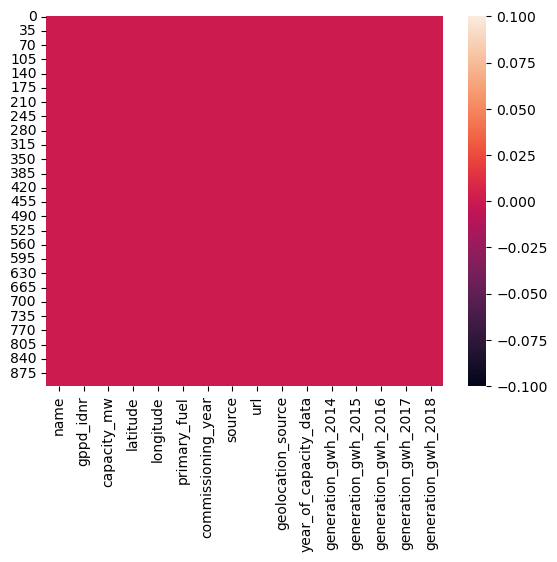

In [41]:
sns.heatmap(global_power_data.isnull())

now lets check for unique values in the dataframe in our output column.

In [42]:
global_power_data['primary_fuel'].unique()

array([6., 1., 7., 2., 3., 0., 5., 4.])

In [43]:
global_power_data['primary_fuel'].nunique()

8

we have 8 unique values in the output column, which means this a case of multi class classification.

Now lets get the values count(most number of occurences) in the dataframe.

In [44]:
for i in global_power_data.columns:
    print(global_power_data[i].value_counts())
    print("/n")

0.0      1
623.0    1
597.0    1
598.0    1
599.0    1
        ..
306.0    1
307.0    1
308.0    1
309.0    1
906.0    1
Name: name, Length: 907, dtype: int64
/n
657.0    1
336.0    1
326.0    1
501.0    1
616.0    1
        ..
155.0    1
156.0    1
157.0    1
158.0    1
876.0    1
Name: gppd_idnr, Length: 907, dtype: int64
/n
5.0       39
10.0      22
600.0     20
15.0      20
1200.0    19
          ..
291.0      1
645.0      1
41.4       1
17.5       1
106.6      1
Name: capacity_mw, Length: 361, dtype: int64
/n
21.7800    47
24.1917     3
19.0004     3
31.2680     2
11.7696     2
           ..
22.7554     1
27.1598     1
17.2970     1
20.8772     1
9.9344      1
Name: latitude, Length: 836, dtype: int64
/n
76.7195    47
71.6917     4
75.8988     3
72.8983     3
71.6918     3
           ..
74.2393     1
77.0435     1
73.8254     1
74.3916     1
77.4768     1
Name: longitude, Length: 827, dtype: int64
/n
1.0    258
3.0    251
6.0    127
7.0    123
2.0     69
0.0     50
5.0     20
4.0 

Below are the list of details we can extract from the above table-

1) name and gbpd_idnr have unique values in their dataframe with no exception.
2) 5.0-39 capacity_mw
3) 21.7800-47 latitude
4) 76.7195-47 longitude
5) 1.0-258 primary_fuel
6) 2001.0-395 commissioning_year
7) 22.0-519 source
8) 58.0-519 url
9) 2.0-765 geolocation_source
10) 801.123775-509 generation_gwh_2014
11) 711.181225-485 generation_gwh_2015
12) 737.205450-473 generation_gwh_2016
13) 817.97725-467 generation_gwh_2017
14) 751.644375-459 generation_gwh_2018

lets declare all the columns that have float values in a new dataframe for visual analysis later on.

In [162]:
global_power_data_col=[]
for i in global_power_data.dtypes.index:
    if global_power_data.dtypes[i] == 'float64':
        global_power_data_col.append(i)
print("global_power_data_cateogry columns:", global_power_data_col)
print("/n")

global_power_data_cateogry columns: ['name', 'gppd_idnr', 'capacity_mw', 'latitude', 'longitude', 'primary_fuel', 'commissioning_year', 'source', 'url', 'geolocation_source', 'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', 'generation_gwh_2018']
/n


let's finalise if all our columns do not have null values.

In [46]:
global_power_data.loc[global_power_data["primary_fuel"]==""]

,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,year_of_capacity_data,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018


lets get the mean value of our target column

In [47]:
print(global_power_data["primary_fuel"].mean())

3.2061742006615215


let's check for unique values in the dataframe and see if there are any redundant column still left.

In [48]:
global_power_data.nunique().to_frame("No. of Unique values")

,No. of Unique values
name,907
gppd_idnr,907
capacity_mw,361
latitude,836
longitude,827
primary_fuel,8
commissioning_year,73
source,191
url,304
geolocation_source,4


it looks like year_of_capacity_data has only 1 uniue values, thus we can remove it as it wont be contributing anything special to our analysis

In [158]:
columns_to_drop1 = ['year_of_capacity_data']
global_power_data = global_power_data.drop(columns=columns_to_drop1)

lets again check for unique values in the dataframe.

In [50]:
global_power_data.nunique().to_frame("No. of Unique values")

,No. of Unique values
name,907
gppd_idnr,907
capacity_mw,361
latitude,836
longitude,827
primary_fuel,8
commissioning_year,73
source,191
url,304
geolocation_source,4


now let's check for duplicated rows in the dataframe

In [51]:
print("Total duplicated rows:", global_power_data.duplicated().sum())

Total duplicated rows: 0


there are no duplicated rows, so let's do the visual anlaysis.

Visual analysis

Univariate analysis

Countplots.

1) name and gbpd_idnr have unique values in their dataframe with no exception.
2) 5.0-39 capacity_mw
3) 21.7800-47 latitude
4) 76.7195-47 longitude
5) 1.0-258 primary_fuel
6) 2001.0-395 commissioning_year
7) 22.0-519 source
8) 58.0-519 url
9) 2.0-765 geolocation_source
10) 801.123775-509 generation_gwh_2014
11) 711.181225-485 generation_gwh_2015
12) 737.205450-473 generation_gwh_2016
13) 817.97725-467 generation_gwh_2017
14) 751.644375-459 generation_gwh_2018

1.0    258
3.0    251
6.0    127
7.0    123
2.0     69
0.0     50
5.0     20
4.0      9
Name: primary_fuel, dtype: int64


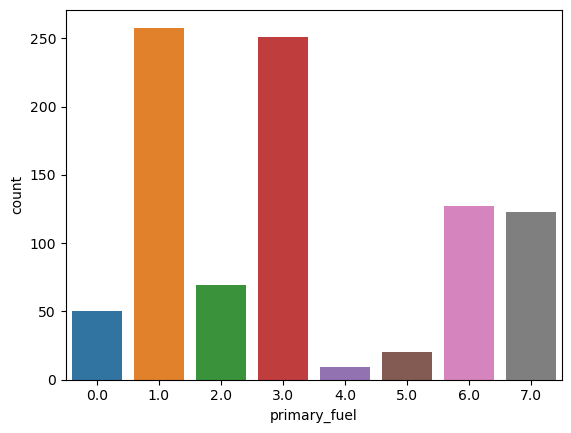

In [52]:
gp=sns.countplot(x='primary_fuel',data=global_power_data)
print(global_power_data['primary_fuel'].value_counts())

0.0      1
623.0    1
597.0    1
598.0    1
599.0    1
        ..
306.0    1
307.0    1
308.0    1
309.0    1
906.0    1
Name: name, Length: 907, dtype: int64


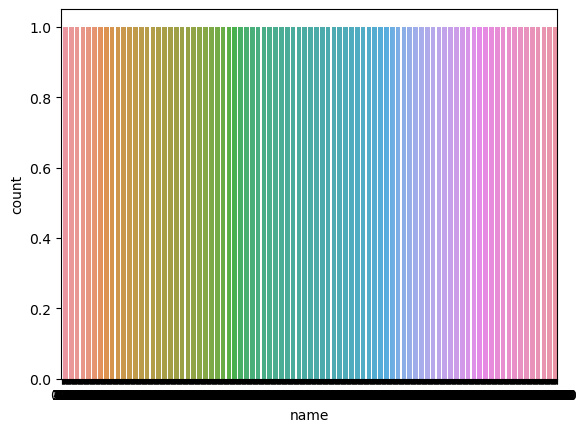

In [53]:
gp=sns.countplot(x='name',data=global_power_data)
print(global_power_data['name'].value_counts())

657.0    1
336.0    1
326.0    1
501.0    1
616.0    1
        ..
155.0    1
156.0    1
157.0    1
158.0    1
876.0    1
Name: gppd_idnr, Length: 907, dtype: int64


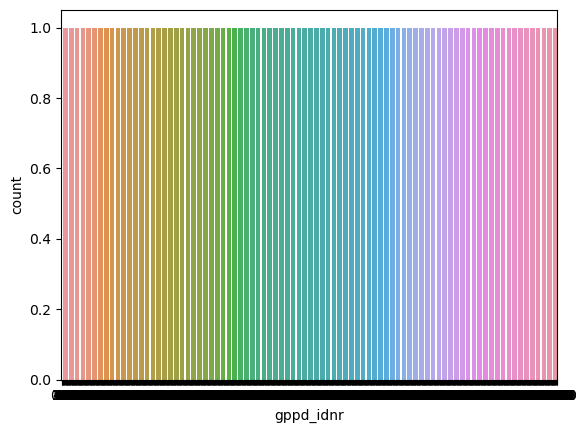

In [54]:
gp=sns.countplot(x='gppd_idnr',data=global_power_data)
print(global_power_data['gppd_idnr'].value_counts())

5.0       39
10.0      22
600.0     20
15.0      20
1200.0    19
          ..
291.0      1
645.0      1
41.4       1
17.5       1
106.6      1
Name: capacity_mw, Length: 361, dtype: int64


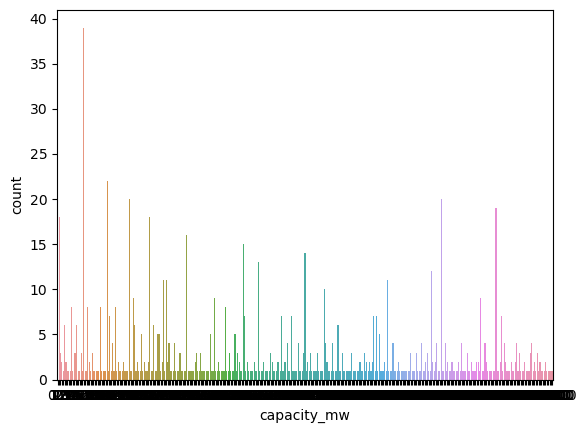

In [55]:
gp=sns.countplot(x='capacity_mw',data=global_power_data)
print(global_power_data['capacity_mw'].value_counts())

21.7800    47
24.1917     3
19.0004     3
31.2680     2
11.7696     2
           ..
22.7554     1
27.1598     1
17.2970     1
20.8772     1
9.9344      1
Name: latitude, Length: 836, dtype: int64


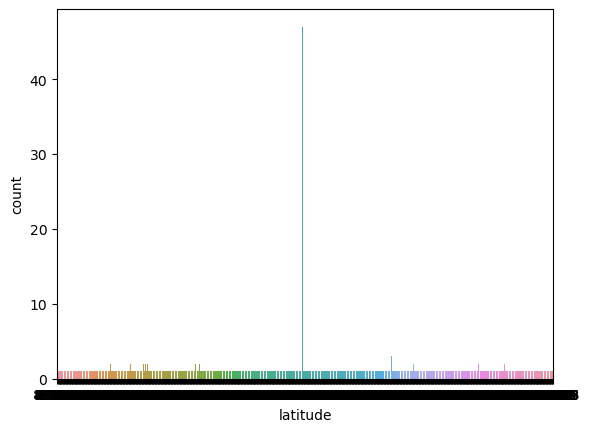

In [56]:
gp=sns.countplot(x='latitude',data=global_power_data)
print(global_power_data['latitude'].value_counts())

76.7195    47
71.6917     4
75.8988     3
72.8983     3
71.6918     3
           ..
74.2393     1
77.0435     1
73.8254     1
74.3916     1
77.4768     1
Name: longitude, Length: 827, dtype: int64


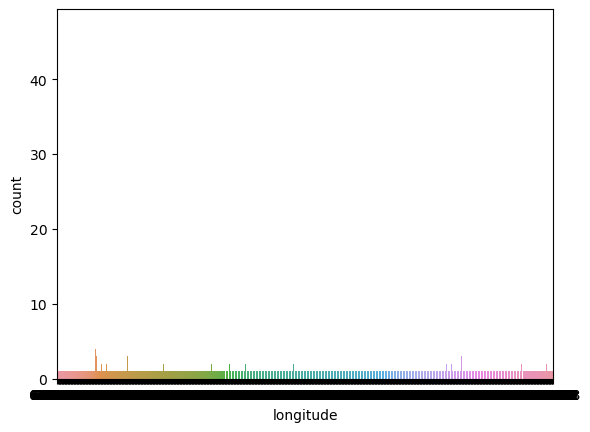

In [57]:
gp=sns.countplot(x='longitude',data=global_power_data)
print(global_power_data['longitude'].value_counts())

2001.0    395
2015.0     28
2013.0     25
2012.0     23
2016.0     19
         ... 
1954.0      1
1969.0      1
1939.0      1
1927.0      1
1953.0      1
Name: commissioning_year, Length: 73, dtype: int64


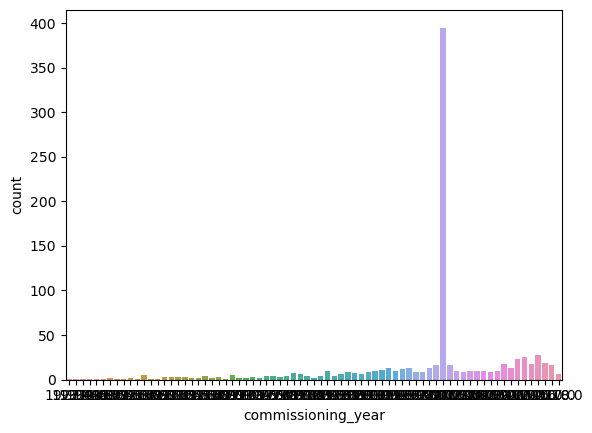

In [58]:
gp=sns.countplot(x='commissioning_year',data=global_power_data)
print(global_power_data['commissioning_year'].value_counts())

22.0     519
21.0     124
84.0      10
109.0      8
110.0      6
        ... 
56.0       1
46.0       1
164.0      1
187.0      1
189.0      1
Name: source, Length: 191, dtype: int64


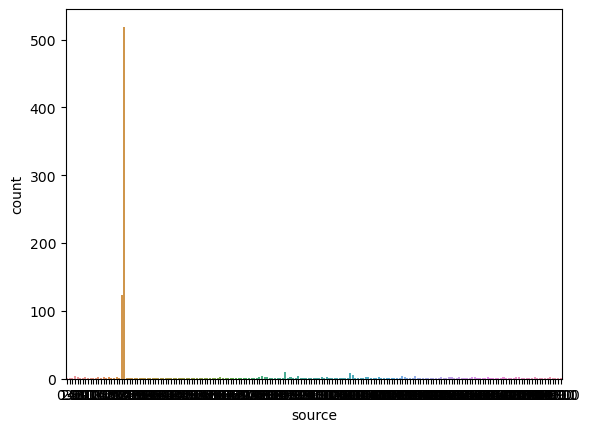

In [59]:
gp=sns.countplot(x='source',data=global_power_data)
print(global_power_data['source'].value_counts())

58.0     519
100.0      7
133.0      6
39.0       5
105.0      4
        ... 
223.0      1
207.0      1
14.0       1
16.0       1
245.0      1
Name: url, Length: 304, dtype: int64


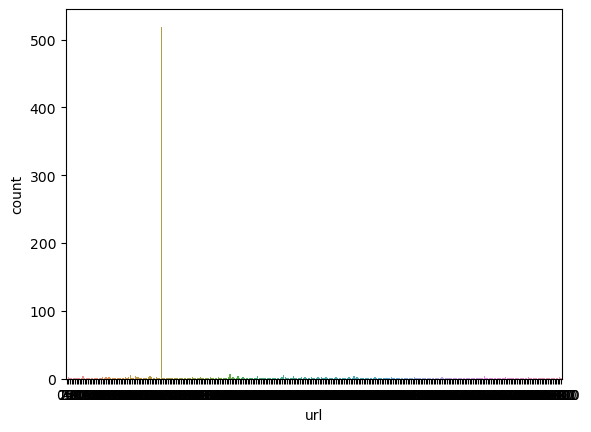

In [60]:
gp=sns.countplot(x='url',data=global_power_data)
print(global_power_data['url'].value_counts())

2.0    765
0.0    119
3.0     19
1.0      4
Name: geolocation_source, dtype: int64


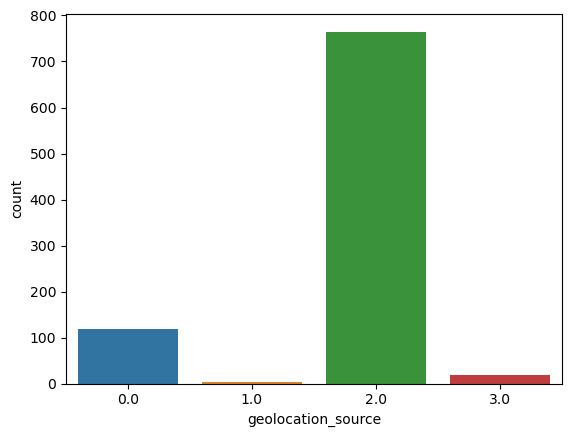

In [61]:
gp=sns.countplot(x='geolocation_source',data=global_power_data)
print(global_power_data['geolocation_source'].value_counts())

801.123775     509
0.000000        28
359.139800       1
7368.390000      1
9983.018000      1
              ... 
1154.342000      1
451.053400       1
3239.142900      1
3155.000000      1
3194.359820      1
Name: generation_gwh_2014, Length: 372, dtype: int64


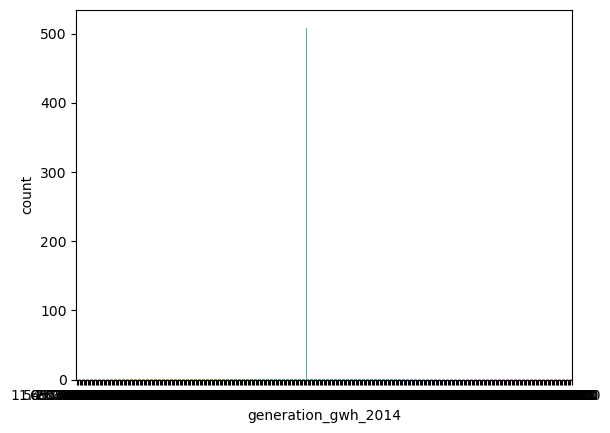

In [62]:
gp=sns.countplot(x='generation_gwh_2014',data=global_power_data)
print(global_power_data['generation_gwh_2014'].value_counts())

711.181225      485
0.000000         27
1497.798000       1
10422.690000      1
240.799900        1
               ... 
14192.000000      1
219.377600        1
288.460450        1
410.566850        1
0.994875          1
Name: generation_gwh_2015, Length: 397, dtype: int64


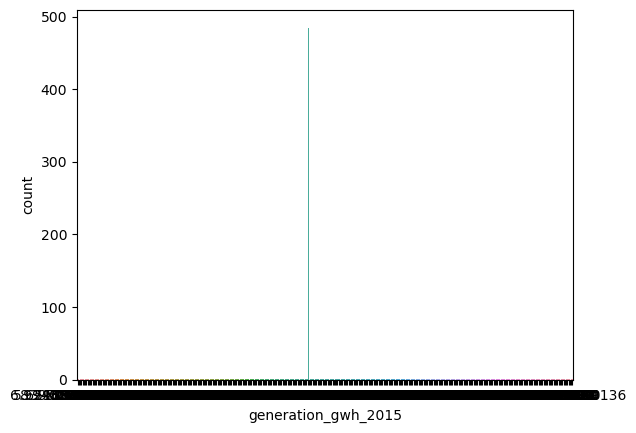

In [63]:
gp=sns.countplot(x='generation_gwh_2015',data=global_power_data)
print(global_power_data['generation_gwh_2015'].value_counts())

737.205450      473
0.000000         30
8470.570000       2
1511.000000       2
12.676300         1
               ... 
131.021600        1
6130.019928       1
5931.490000       1
14834.800000      1
233.596650        1
Name: generation_gwh_2016, Length: 404, dtype: int64


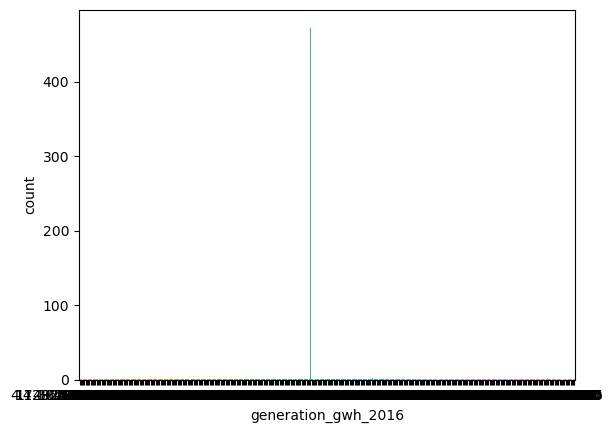

In [64]:
gp=sns.countplot(x='generation_gwh_2016',data=global_power_data)
print(global_power_data['generation_gwh_2016'].value_counts())

817.97725      467
0.00000         32
170.08530        2
272.73945        1
0.97510          1
              ... 
15177.00000      1
191.94545        1
307.37540        1
382.43820        1
865.40000        1
Name: generation_gwh_2017, Length: 409, dtype: int64


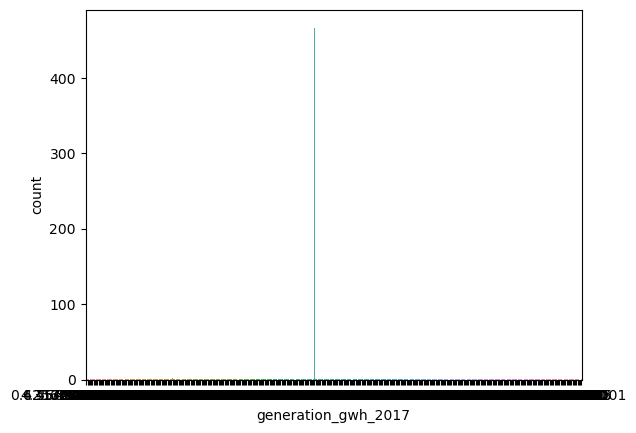

In [65]:
gp=sns.countplot(x='generation_gwh_2017',data=global_power_data)
print(global_power_data['generation_gwh_2017'].value_counts())

751.644375      459
0.000000         39
21.939750         1
17.213500         1
7200.400000       1
               ... 
7321.267900       1
6532.350000       1
15305.220000      1
373.970750        1
686.500000        1
Name: generation_gwh_2018, Length: 411, dtype: int64


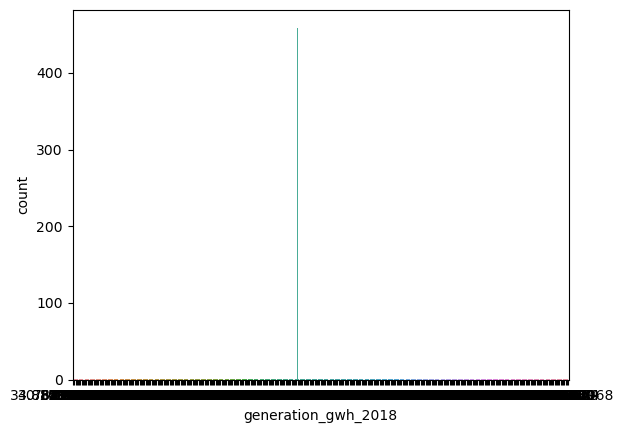

In [66]:
gp=sns.countplot(x='generation_gwh_2018',data=global_power_data)
print(global_power_data['generation_gwh_2018'].value_counts())

Distribution plots

C:\Users\ACHU NARAYAN\AppData\Local\Temp\ipykernel_7832\3334672161.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(global_power_data[col],color="b")
C:\Users\ACHU NARAYAN\AppData\Local\Temp\ipykernel_7832\3334672161.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(global_power_data[col],c

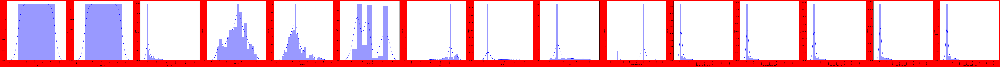

In [70]:
plt.figure(figsize=(145,145),facecolor = "red")
plotnumber=1
for col in global_power_data_col:
    if plotnumber<=16:
        wc=plt.subplot(15,15,plotnumber)
        sns.distplot(global_power_data[col],color="b")
        plt.xlabel(col,rotation=0,fontsize = 13)
        plt.xticks(rotation=90, fontsize=13)
        plt.yticks(rotation = 0, fontsize = 13)
    plotnumber+=1
plt.tight_layout()

Below are the following details we get from the dataframe-

1) name and gppd_idnr are normally distributed
2) capacity_mw is skewed to the left.
3) latitude has a slight skewness to the left.
4) longitude is skewed to the left.
5) primary fuel has a little bit of skewness to the left anf right.
6) commissioning_year is skewed to the right.
7) source is the skewed to the left.
8) url is skewed to the left.
9) geolocation_source is skewed a little to the left and lot to the right
10) 'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', and 'generation_gwh_2018' are all skewed tot the left.

'name', 'gppd_idnr', 'capacity_mw', 'latitude', 'longitude', 'primary_fuel', 'commissioning_year', 'source', 'url', 'geolocation_source', 'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', 'generation_gwh_2018'

Bi variate analysis

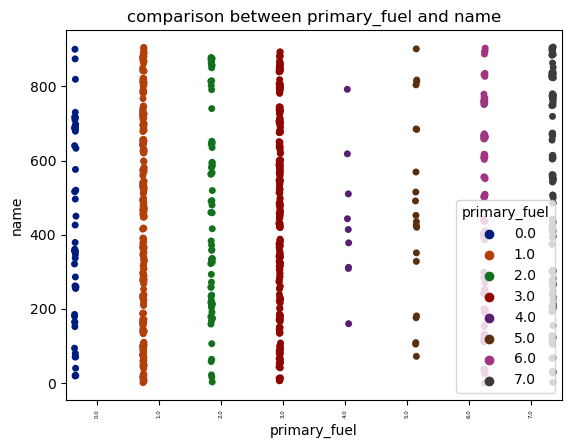

<Figure size 2800x200 with 0 Axes>

In [71]:
plt.title("comparison between primary_fuel and name")
sns.stripplot(x= "primary_fuel", y= "name", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

No conclusive statements can be made from the above plot.

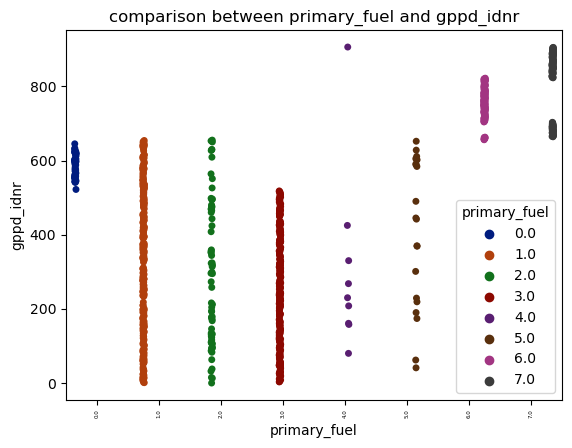

<Figure size 2800x200 with 0 Axes>

In [72]:
plt.title("comparison between primary_fuel and gppd_idnr")
sns.stripplot(x= "primary_fuel", y= "gppd_idnr", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 7 has the highest amount of gppd_inr.

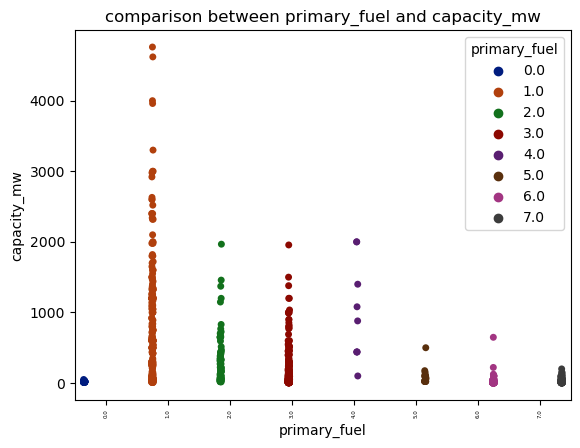

<Figure size 2800x200 with 0 Axes>

In [73]:
plt.title("comparison between primary_fuel and capacity_mw")
sns.stripplot(x= "primary_fuel", y= "capacity_mw", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel has the highest capacity_mw among the other fuels.

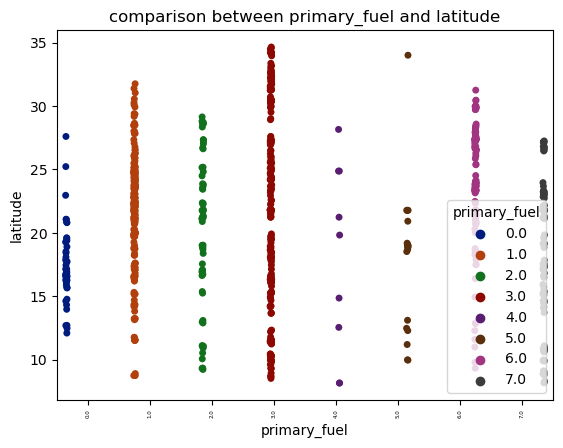

<Figure size 2800x200 with 0 Axes>

In [74]:
plt.title("comparison between primary_fuel and latitude")
sns.stripplot(x= "primary_fuel", y= "latitude", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary_fuel number 3 has most of the points in the latitude column.

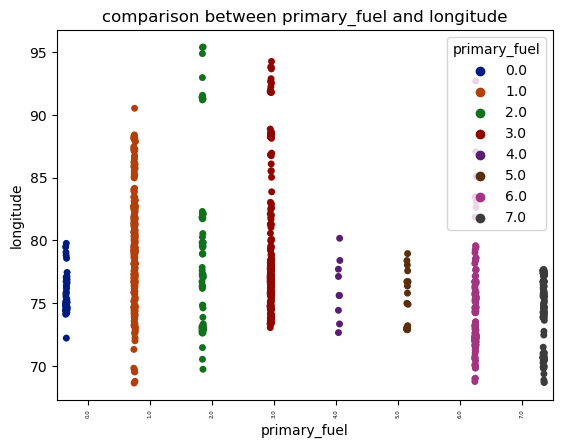

<Figure size 2800x200 with 0 Axes>

In [75]:
plt.title("comparison between primary_fuel and longitude")
sns.stripplot(x= "primary_fuel", y= "longitude", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plot.

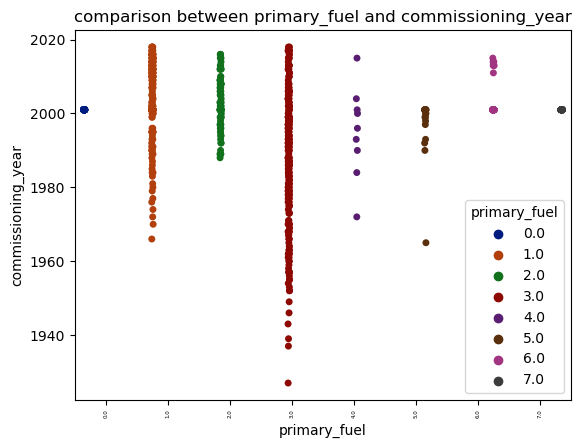

<Figure size 2800x200 with 0 Axes>

In [76]:
plt.title("comparison between primary_fuel and commissioning_year")
sns.stripplot(x= "primary_fuel", y= "commissioning_year", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the points are accumulating in the primary fuel 3 types.

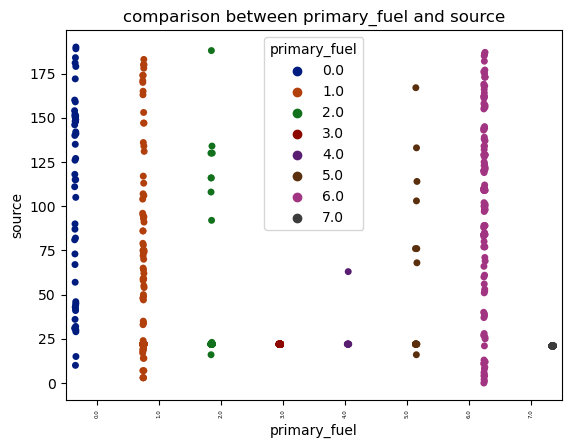

<Figure size 2800x200 with 0 Axes>

In [77]:
plt.title("comparison between primary_fuel and source")
sns.stripplot(x= "primary_fuel", y= "source", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plot.

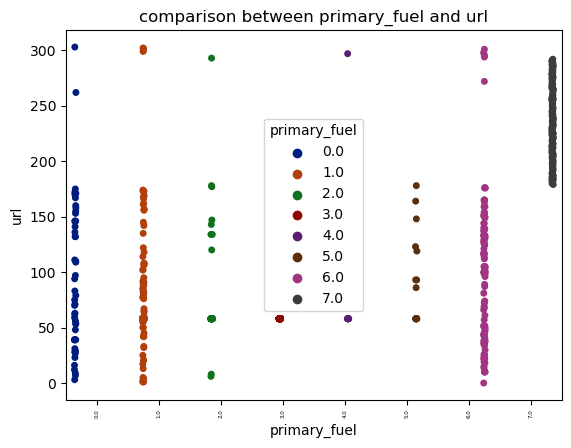

<Figure size 2800x200 with 0 Axes>

In [78]:
plt.title("comparison between primary_fuel and url")
sns.stripplot(x= "primary_fuel", y= "url", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 7 has most of the points in the url 150 to 300.

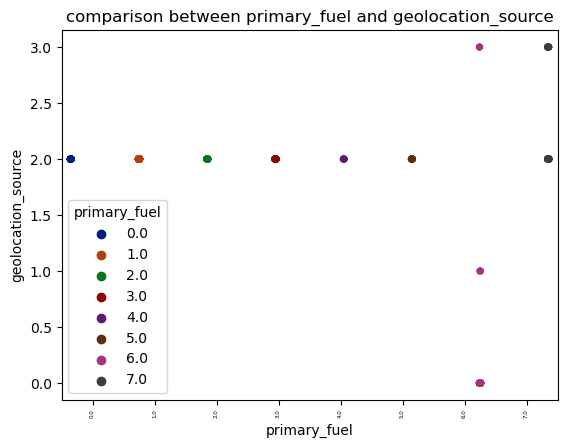

<Figure size 2800x200 with 0 Axes>

In [79]:
plt.title("comparison between primary_fuel and geolocation_source")
sns.stripplot(x= "primary_fuel", y= "geolocation_source", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plot.

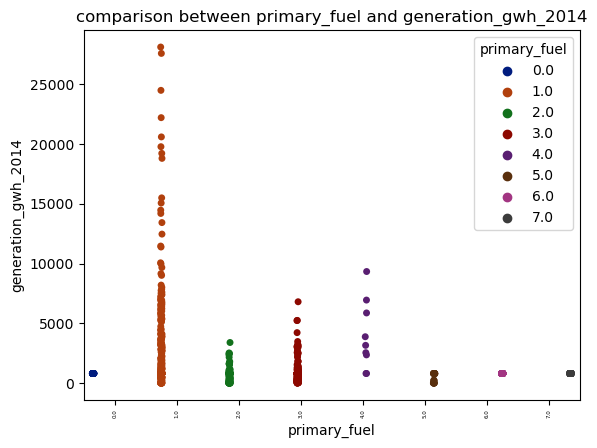

<Figure size 2800x200 with 0 Axes>

In [80]:
plt.title("comparison between primary_fuel and generation_gwh_2014")
sns.stripplot(x= "primary_fuel", y= "generation_gwh_2014", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 1 has most of points accumulated in generation_gwh_2014.

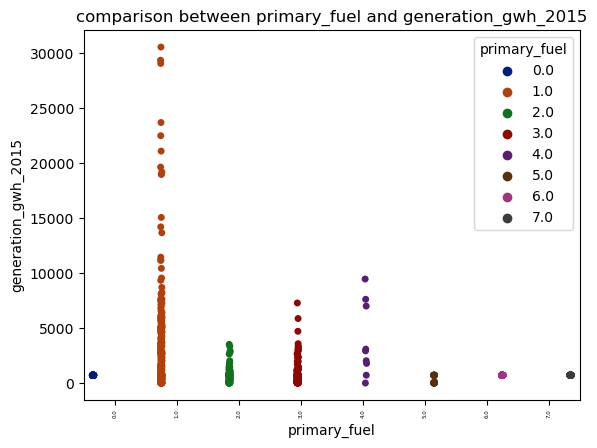

<Figure size 2800x200 with 0 Axes>

In [81]:
plt.title("comparison between primary_fuel and generation_gwh_2015")
sns.stripplot(x= "primary_fuel", y= "generation_gwh_2015", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 1 has most of points accumulated in generation_gwh_2015.

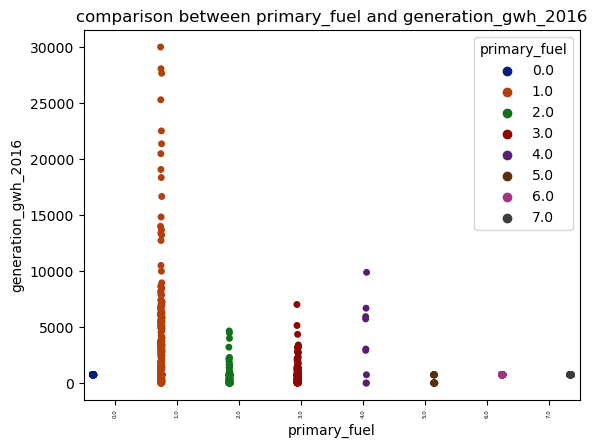

<Figure size 2800x200 with 0 Axes>

In [82]:
plt.title("comparison between primary_fuel and generation_gwh_2016")
sns.stripplot(x= "primary_fuel", y= "generation_gwh_2016", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 1 has most of points accumulated in generation_gwh_2016.

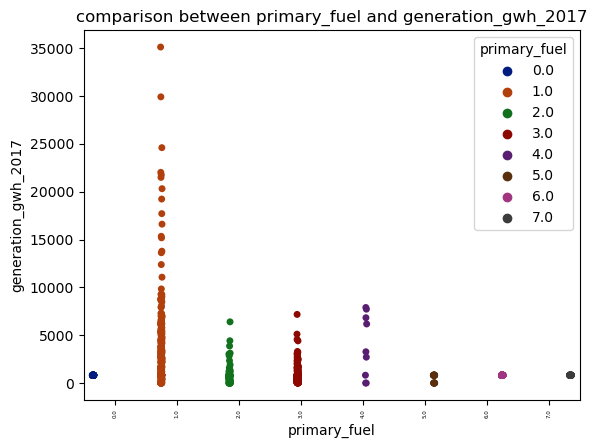

<Figure size 2800x200 with 0 Axes>

In [83]:
plt.title("comparison between primary_fuel and generation_gwh_2017")
sns.stripplot(x= "primary_fuel", y= "generation_gwh_2017", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 1 has most of points accumulated in generation_gwh_2017.

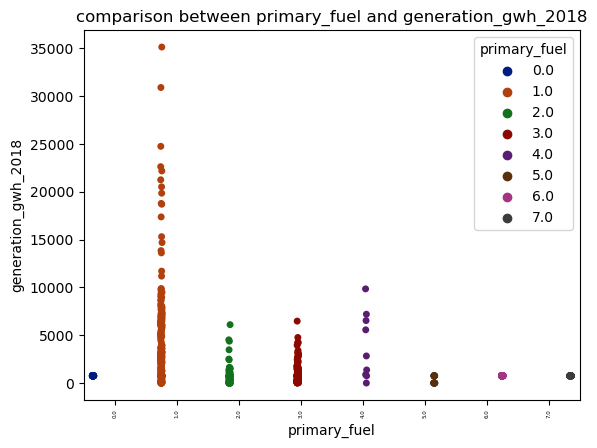

<Figure size 2800x200 with 0 Axes>

In [84]:
plt.title("comparison between primary_fuel and generation_gwh_2018")
sns.stripplot(x= "primary_fuel", y= "generation_gwh_2018", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 1 has most of points accumulated in generation_gwh_2018.

'name', 'gppd_idnr', 'capacity_mw', 'latitude', 'longitude', 'primary_fuel', 'commissioning_year', 'source', 'url', 'geolocation_source', 'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', 'generation_gwh_2018'

In [ ]:
scatterplots

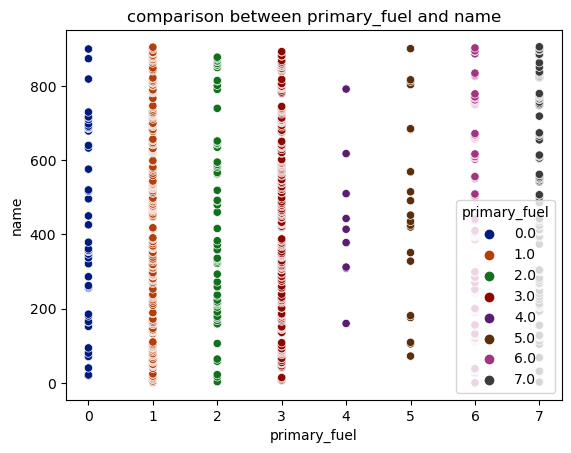

In [11]:
plt.title("comparison between primary_fuel and name")
sns.scatterplot(x= 'primary_fuel', y= 'name', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

no conclusive statements can be made from the above plot.

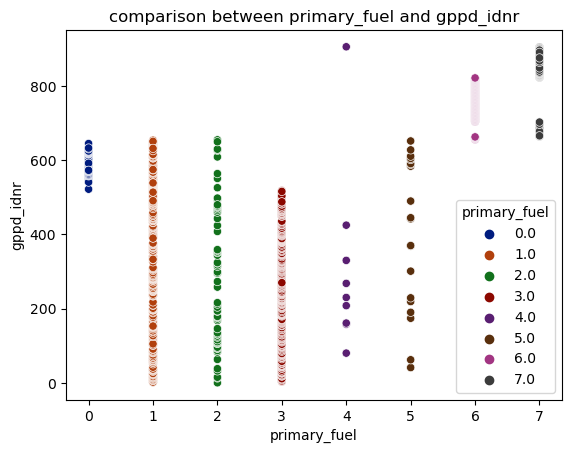

In [12]:
plt.title("comparison between primary_fuel and gppd_idnr")
sns.scatterplot(x= 'primary_fuel', y= 'gppd_idnr', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

no conclusive statement can be made from the above plot.

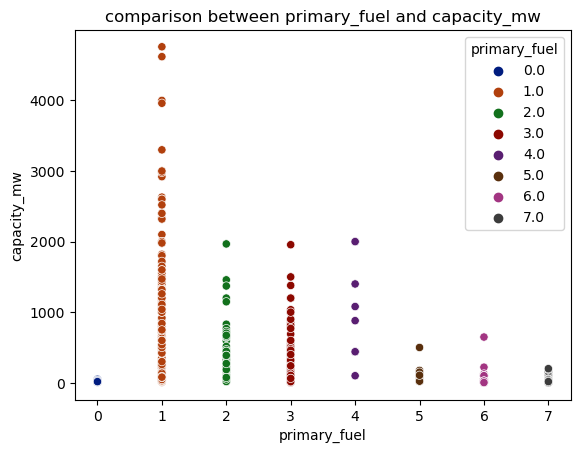

In [13]:
plt.title("comparison between primary_fuel and capacity_mw")
sns.scatterplot(x= 'primary_fuel', y= 'capacity_mw', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

primary fuel number 1 has the most point accumulated in capacity_mw.

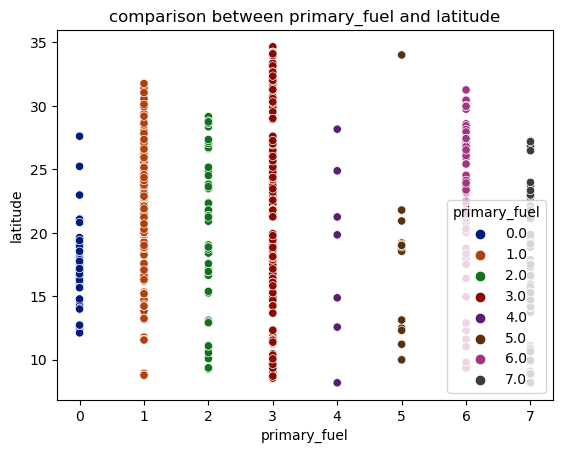

In [14]:
plt.title("comparison between primary_fuel and latitude")
sns.scatterplot(x= 'primary_fuel', y= 'latitude', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

no conclusive statements can be made from the above plot.

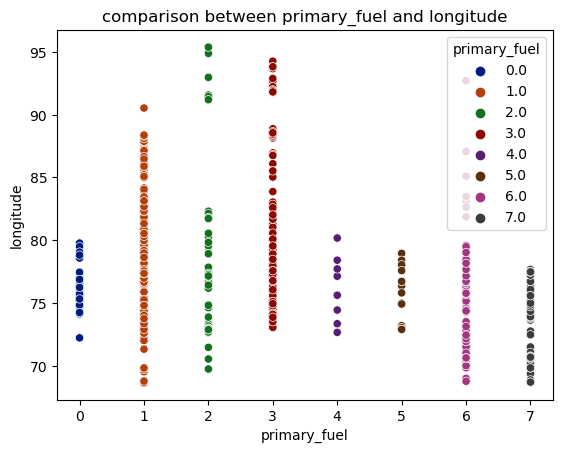

In [15]:
plt.title("comparison between primary_fuel and longitude")
sns.scatterplot(x= 'primary_fuel', y= 'longitude', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

no conclusive statements can be made from the above plot.

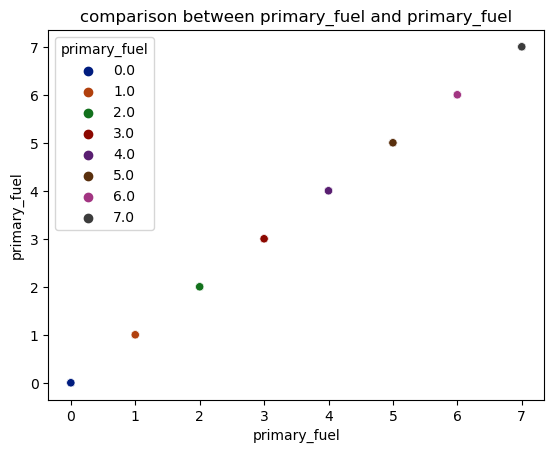

In [16]:
plt.title("comparison between primary_fuel and primary_fuel")
sns.scatterplot(x= 'primary_fuel', y= 'primary_fuel', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

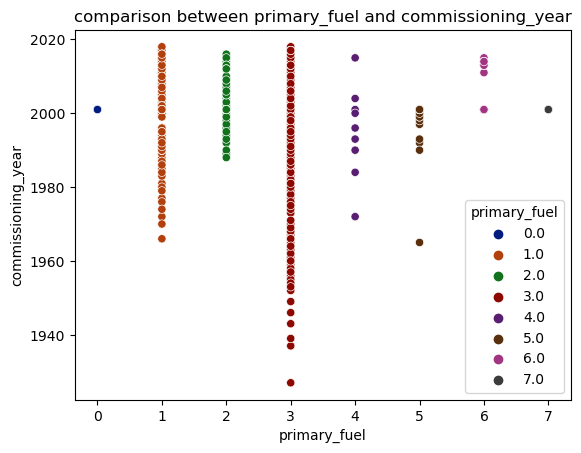

In [17]:
plt.title("comparison between primary_fuel and commissioning_year")
sns.scatterplot(x= 'primary_fuel', y= 'commissioning_year', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

most of the primary fuel 3 has been accumulated in the commissioning_year column.

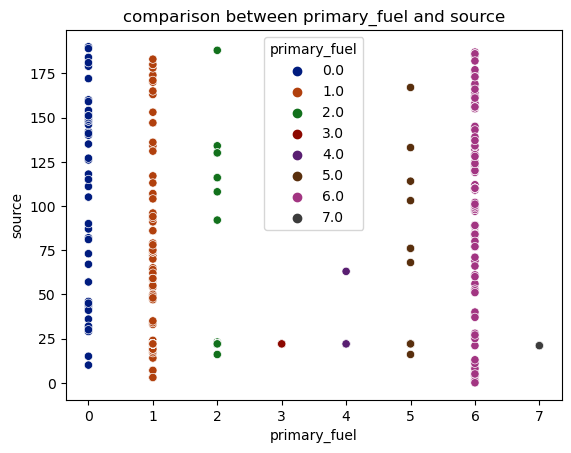

In [18]:
plt.title("comparison between primary_fuel and source")
sns.scatterplot(x= 'primary_fuel', y= 'source', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

no conclusive statements can be made from the above plot.

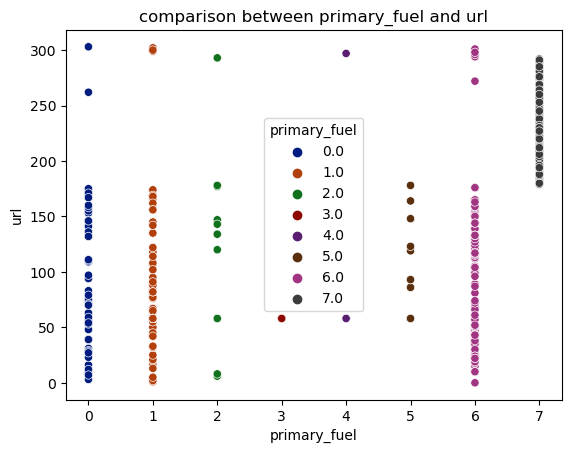

In [19]:
plt.title("comparison between primary_fuel and url")
sns.scatterplot(x= 'primary_fuel', y= 'url', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

no conclusive statement can be made from the above plot.

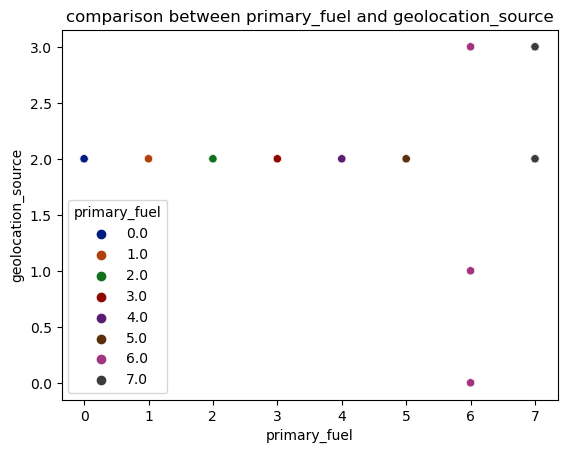

In [20]:
plt.title("comparison between primary_fuel and geolocation_source")
sns.scatterplot(x= 'primary_fuel', y= 'geolocation_source', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

no conclusive statement can be made from the above plot.

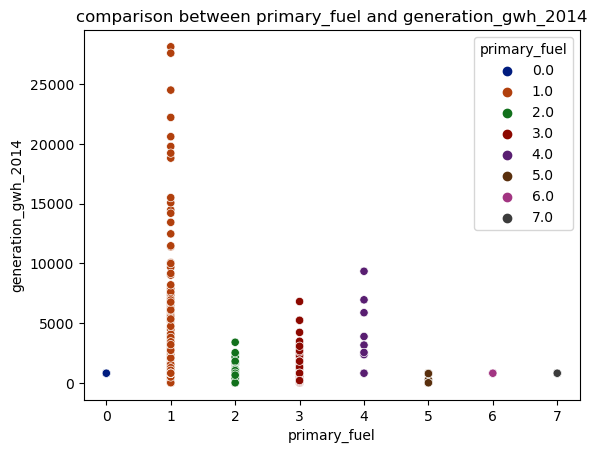

In [21]:
plt.title("comparison between primary_fuel and generation_gwh_2014")
sns.scatterplot(x= 'primary_fuel', y= 'generation_gwh_2014', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

most of the point accumulated in generation_gwh_2014 is at primary fuel number 1.

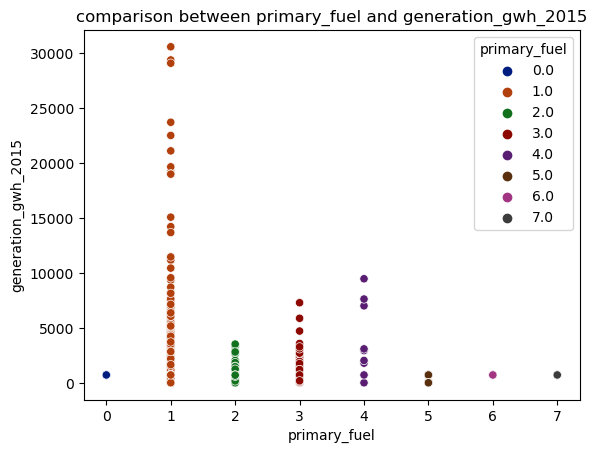

In [22]:
plt.title("comparison between primary_fuel and generation_gwh_2015")
sns.scatterplot(x= 'primary_fuel', y= 'generation_gwh_2015', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

most of the points accumulated in generation_gwh_2015 is at primary fuel number 1.

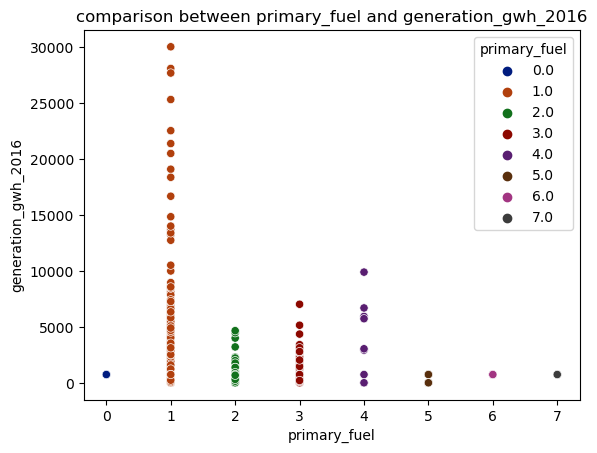

In [23]:
plt.title("comparison between primary_fuel and generation_gwh_2016")
sns.scatterplot(x= 'primary_fuel', y= 'generation_gwh_2016', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

most of the points accumulated in generation_gwh_2016 is at primary fuel number 1.

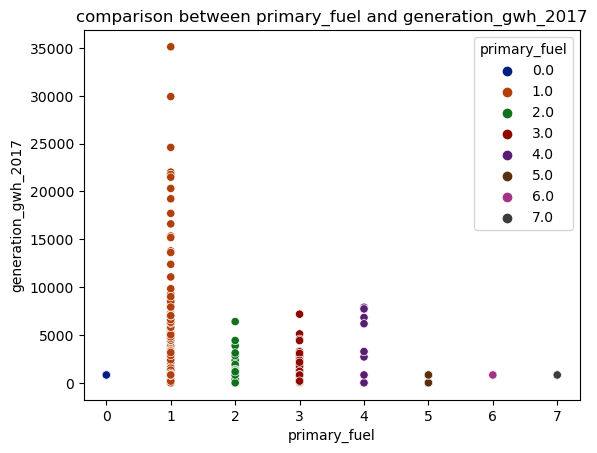

In [24]:
plt.title("comparison between primary_fuel and generation_gwh_2017")
sns.scatterplot(x= 'primary_fuel', y= 'generation_gwh_2017', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

most of the points accumulated in generation_gwh_2017 is at primary fuel number 1.

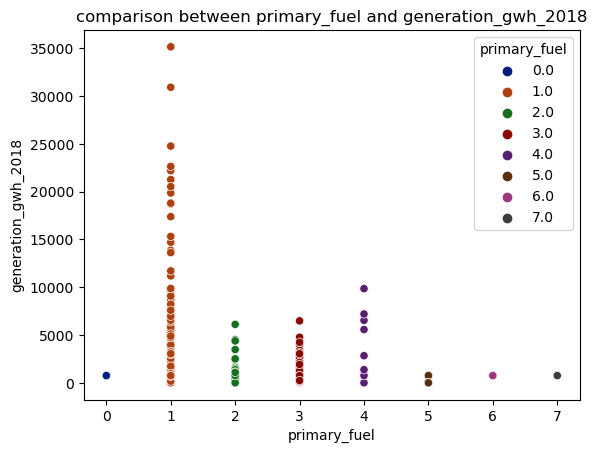

In [25]:
plt.title("comparison between primary_fuel and generation_gwh_2018")
sns.scatterplot(x= 'primary_fuel', y= 'generation_gwh_2018', data = global_power_data,hue='primary_fuel', palette='dark')
plt.show()

most of the points accumulated in generation_gwh_2018 is at primary fuel number 1.

strip plots

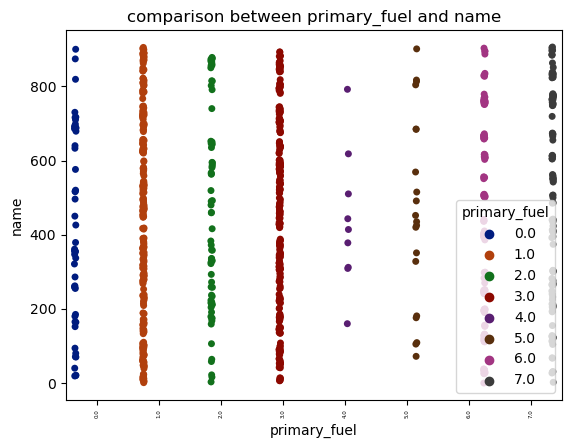

<Figure size 2800x200 with 0 Axes>

In [26]:
plt.title("comparison between primary_fuel and name")
sns.stripplot(x= 'primary_fuel', y= 'name', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

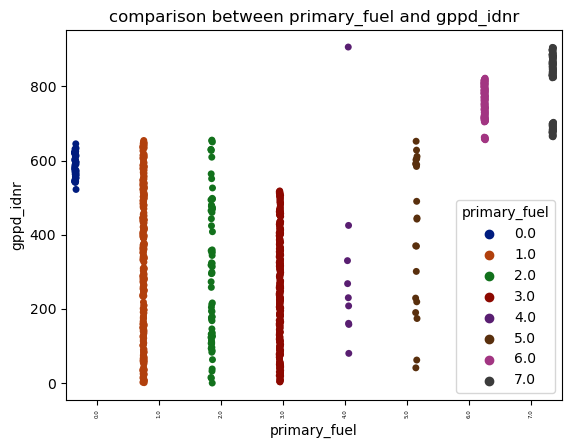

<Figure size 2800x200 with 0 Axes>

In [27]:
plt.title("comparison between primary_fuel and gppd_idnr")
sns.stripplot(x= 'primary_fuel', y= 'gppd_idnr', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

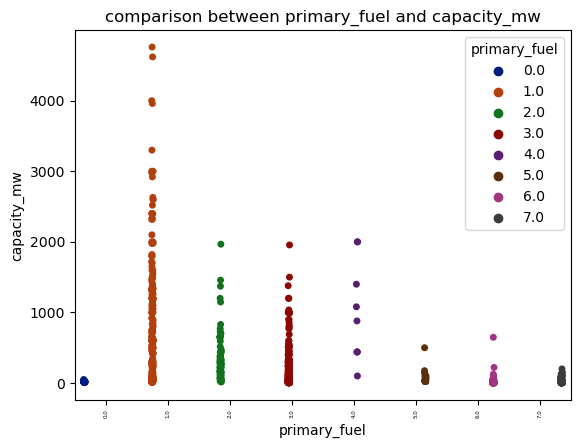

<Figure size 2800x200 with 0 Axes>

In [28]:
plt.title("comparison between primary_fuel and capacity_mw")
sns.stripplot(x= 'primary_fuel', y= 'capacity_mw', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

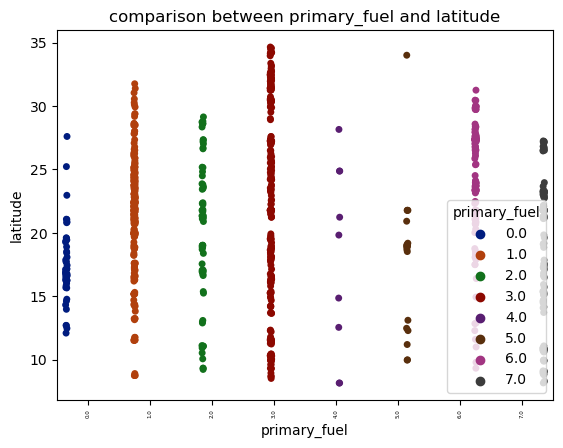

<Figure size 2800x200 with 0 Axes>

In [29]:
plt.title("comparison between primary_fuel and latitude")
sns.stripplot(x= 'primary_fuel', y= 'latitude', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

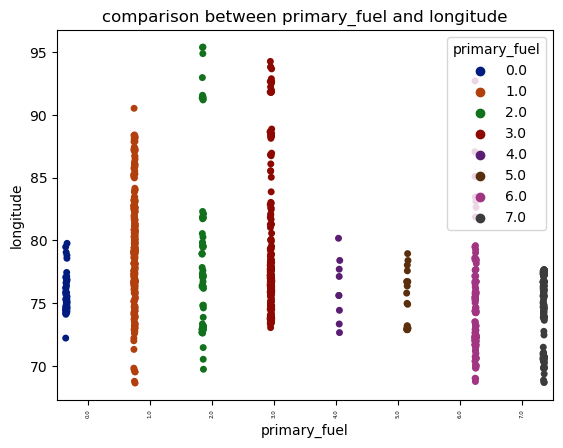

<Figure size 2800x200 with 0 Axes>

In [30]:
plt.title("comparison between primary_fuel and longitude")
sns.stripplot(x= 'primary_fuel', y= 'longitude', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

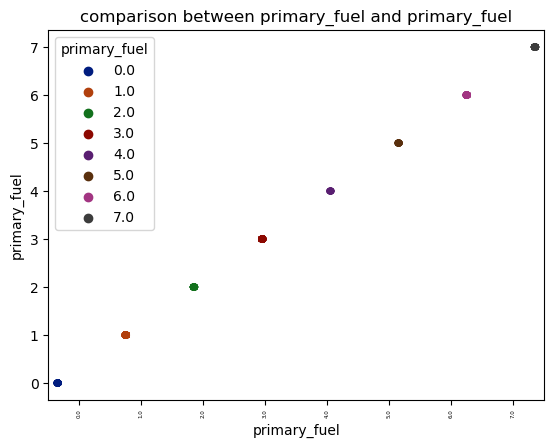

<Figure size 2800x200 with 0 Axes>

In [31]:
plt.title("comparison between primary_fuel and primary_fuel")
sns.stripplot(x= 'primary_fuel', y= 'primary_fuel', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

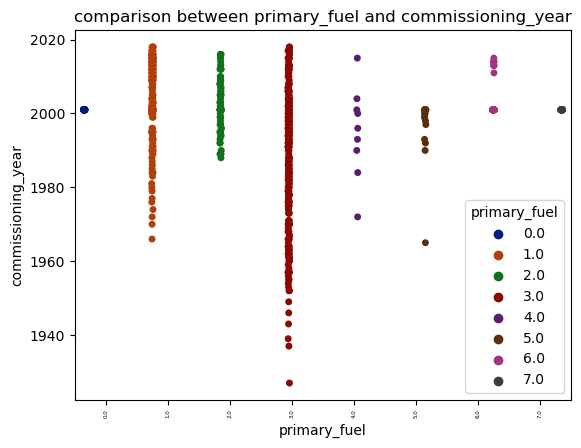

<Figure size 2800x200 with 0 Axes>

In [32]:
plt.title("comparison between primary_fuel and commissioning_year")
sns.stripplot(x= 'primary_fuel', y= 'commissioning_year', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

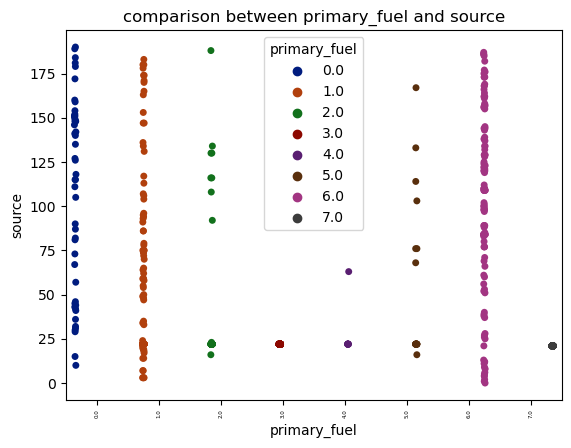

<Figure size 2800x200 with 0 Axes>

In [33]:
plt.title("comparison between primary_fuel and source")
sns.stripplot(x= 'primary_fuel', y= 'source', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

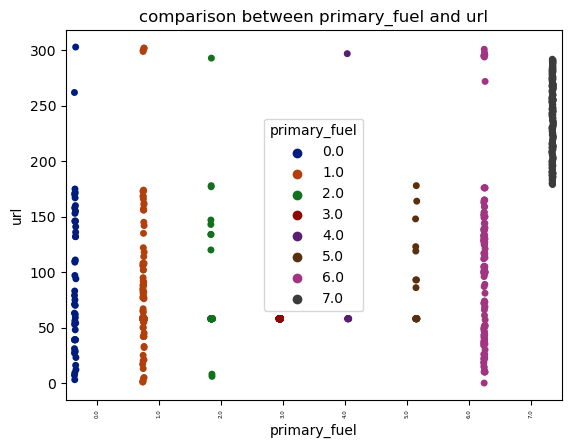

<Figure size 2800x200 with 0 Axes>

In [34]:
plt.title("comparison between primary_fuel and url")
sns.stripplot(x= 'primary_fuel', y= 'url', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

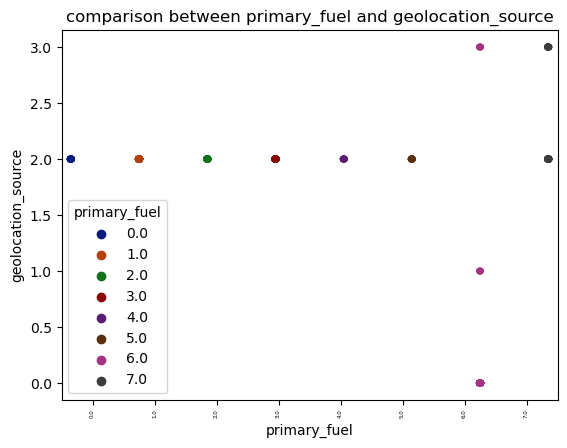

<Figure size 2800x200 with 0 Axes>

In [35]:
plt.title("comparison between primary_fuel and geolocation_source")
sns.stripplot(x= 'primary_fuel', y= 'geolocation_source', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

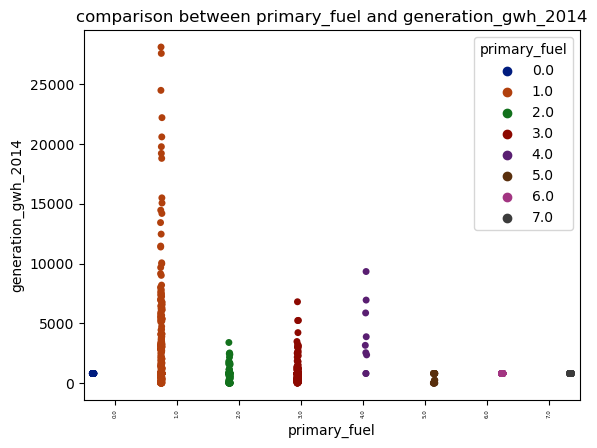

<Figure size 2800x200 with 0 Axes>

In [36]:
plt.title("comparison between primary_fuel and generation_gwh_2014")
sns.stripplot(x= 'primary_fuel', y= 'generation_gwh_2014', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

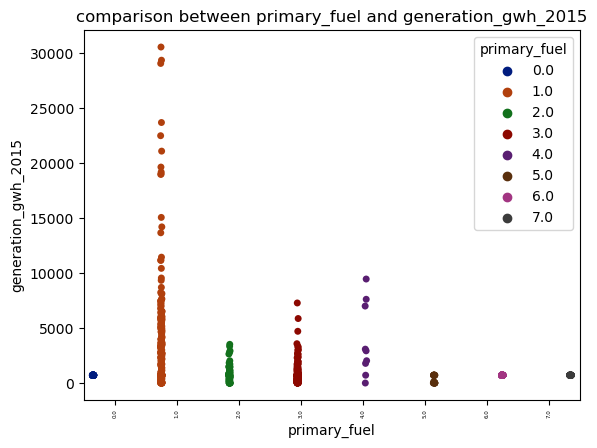

<Figure size 2800x200 with 0 Axes>

In [37]:
plt.title("comparison between primary_fuel and generation_gwh_2015")
sns.stripplot(x= 'primary_fuel', y= 'generation_gwh_2015', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

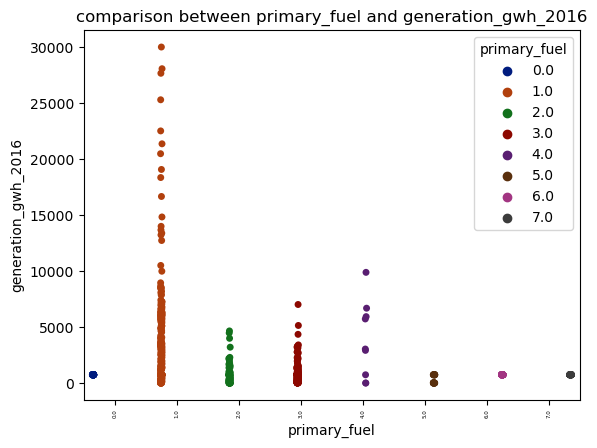

<Figure size 2800x200 with 0 Axes>

In [38]:
plt.title("comparison between primary_fuel and generation_gwh_2016")
sns.stripplot(x= 'primary_fuel', y= 'generation_gwh_2016', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

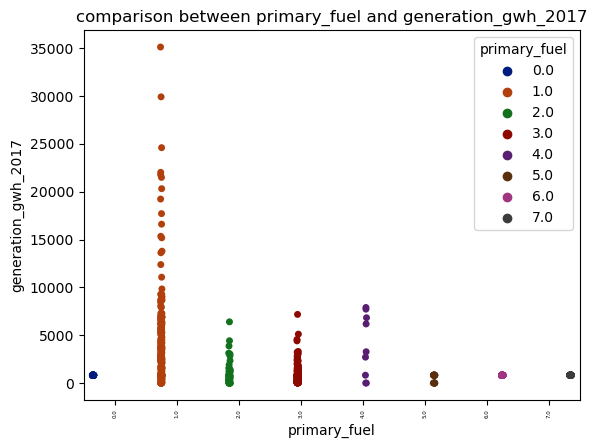

<Figure size 2800x200 with 0 Axes>

In [39]:
plt.title("comparison between primary_fuel and generation_gwh_2017")
sns.stripplot(x= 'primary_fuel', y= 'generation_gwh_2017', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

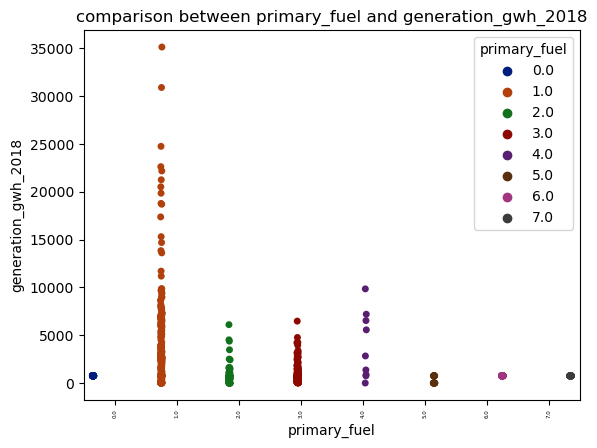

<Figure size 2800x200 with 0 Axes>

In [40]:
plt.title("comparison between primary_fuel and generation_gwh_2018")
sns.stripplot(x= 'primary_fuel', y= 'generation_gwh_2018', data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

barplots

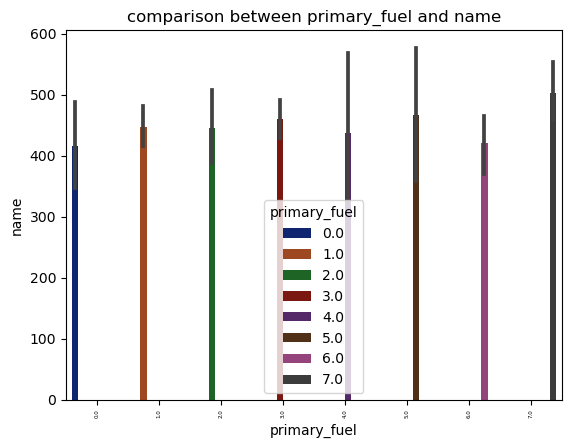

<Figure size 2800x200 with 0 Axes>

In [41]:
plt.title("comparison between primary_fuel and name")
sns.barplot(x= "primary_fuel", y= "name", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 7 has the highest numbe of values in the name column.

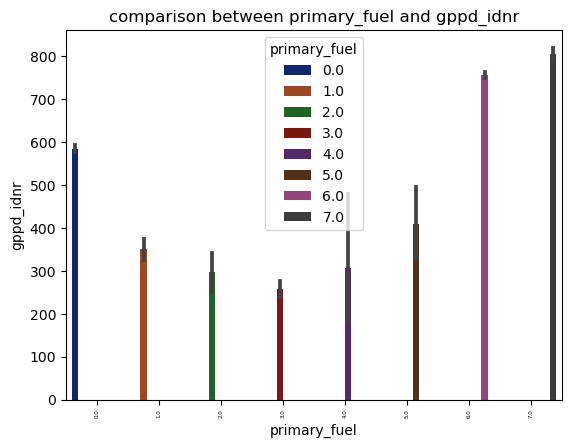

<Figure size 2800x200 with 0 Axes>

In [42]:
plt.title("comparison between primary_fuel and gppd_idnr")
sns.barplot(x= "primary_fuel", y= "gppd_idnr", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 7 has the highest number of values in the gppd_idnr column.

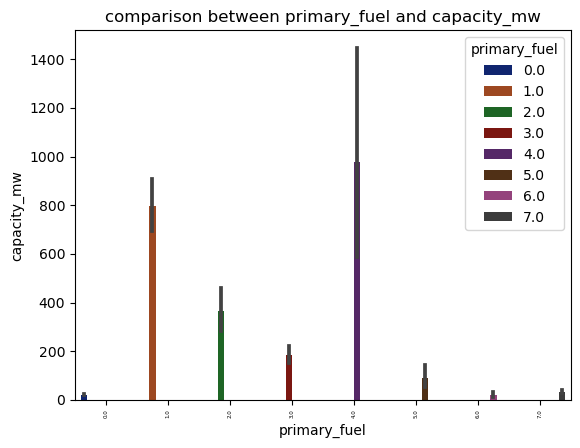

<Figure size 2800x200 with 0 Axes>

In [43]:
plt.title("comparison between primary_fuel and capacity_mw")
sns.barplot(x= "primary_fuel", y= "capacity_mw", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 4 has the highest number of values in the capacity_mw column.

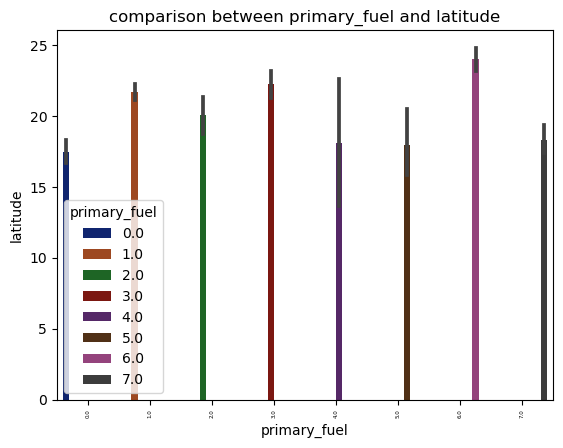

<Figure size 2800x200 with 0 Axes>

In [44]:
plt.title("comparison between primary_fuel and latitude")
sns.barplot(x= "primary_fuel", y= "latitude", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 6 has the highest number of values in the latitude column.

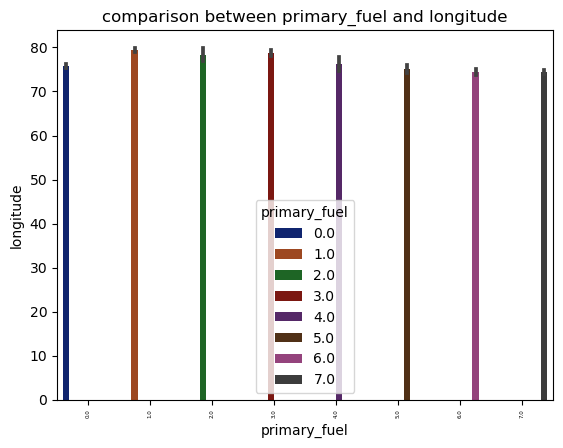

<Figure size 2800x200 with 0 Axes>

In [45]:
plt.title("comparison between primary_fuel and longitude")
sns.barplot(x= "primary_fuel", y= "longitude", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 1 has the highest number of values in the longitude column.

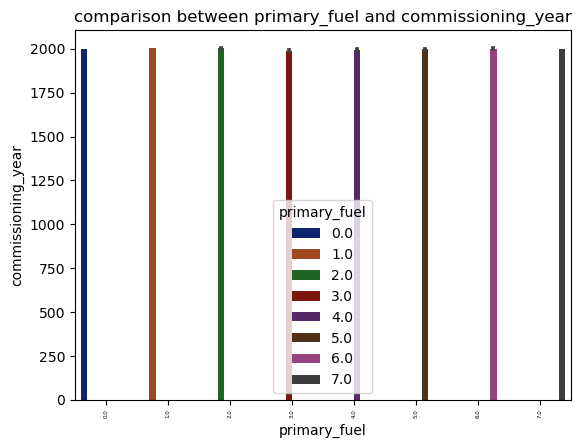

<Figure size 2800x200 with 0 Axes>

In [46]:
plt.title("comparison between primary_fuel and commissioning_year")
sns.barplot(x= "primary_fuel", y= "commissioning_year", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plot.

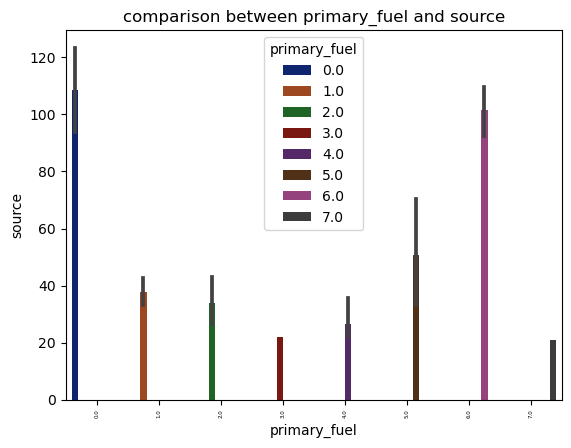

<Figure size 2800x200 with 0 Axes>

In [47]:
plt.title("comparison between primary_fuel and source")
sns.barplot(x= "primary_fuel", y= "source", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 0 has the highest number of values in the source column.

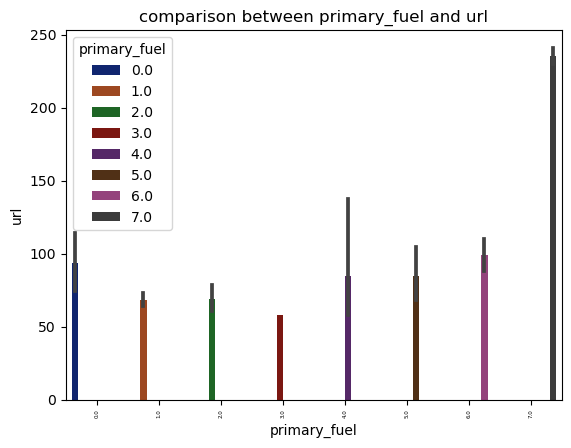

<Figure size 2800x200 with 0 Axes>

In [48]:
plt.title("comparison between primary_fuel and url")
sns.barplot(x= "primary_fuel", y= "url", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 7 has the highest number of values in the url column.

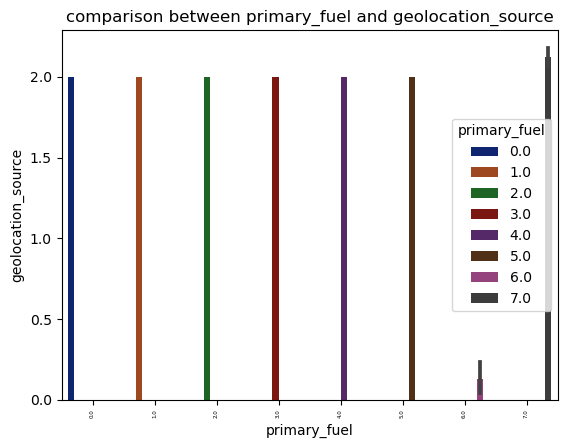

<Figure size 2800x200 with 0 Axes>

In [49]:
plt.title("comparison between primary_fuel and geolocation_source")
sns.barplot(x= "primary_fuel", y= "geolocation_source", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 6 has the highest number of values in the geolocation_source column.

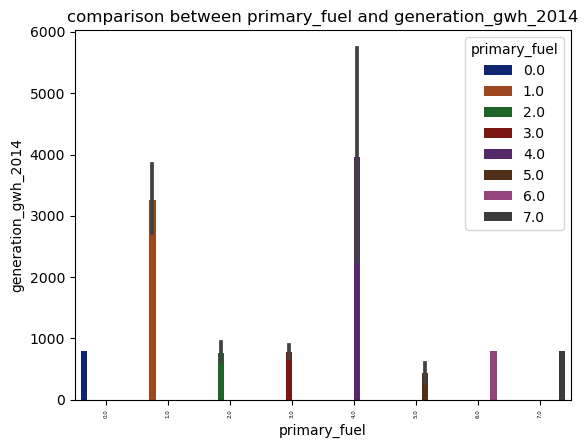

<Figure size 2800x200 with 0 Axes>

In [50]:
plt.title("comparison between primary_fuel and generation_gwh_2014")
sns.barplot(x= "primary_fuel", y= "generation_gwh_2014", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 4 has the highest number of values in the generation_gwh_2014 column.

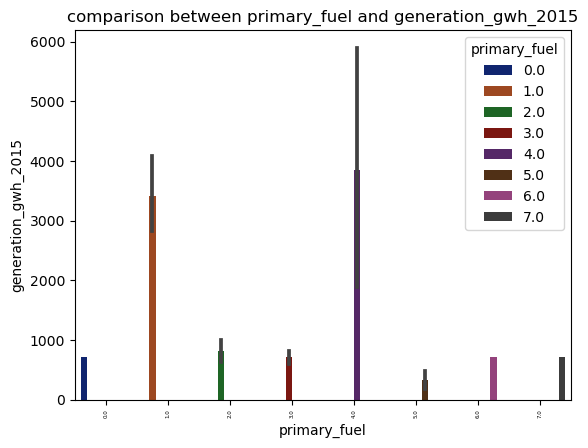

<Figure size 2800x200 with 0 Axes>

In [51]:
plt.title("comparison between primary_fuel and generation_gwh_2015")
sns.barplot(x= "primary_fuel", y= "generation_gwh_2015", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

In [ ]:
primary fuel number 4 has the highest number of values in the generation_gwh_2015 column.

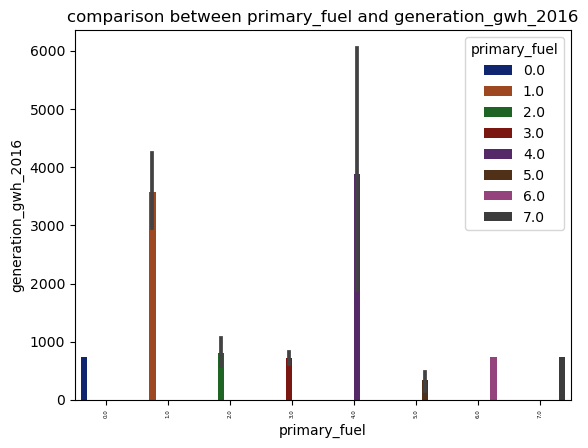

<Figure size 2800x200 with 0 Axes>

In [52]:
plt.title("comparison between primary_fuel and generation_gwh_2016")
sns.barplot(x= "primary_fuel", y= "generation_gwh_2016", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 4 has the highest number of values in the generation_gwh_2016 column.

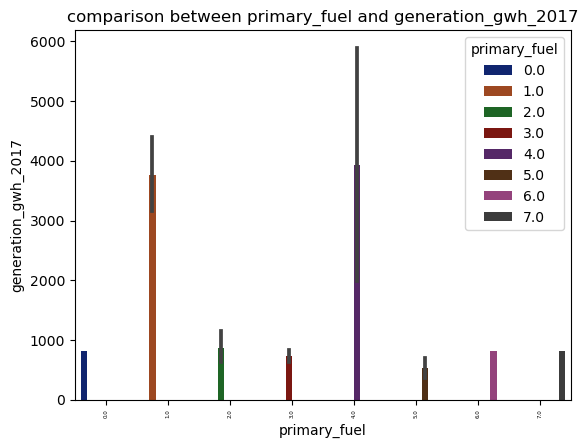

<Figure size 2800x200 with 0 Axes>

In [53]:
plt.title("comparison between primary_fuel and generation_gwh_2017")
sns.barplot(x= "primary_fuel", y= "generation_gwh_2017", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 4 has the highest number of values in the generation_gwh_2017 column.

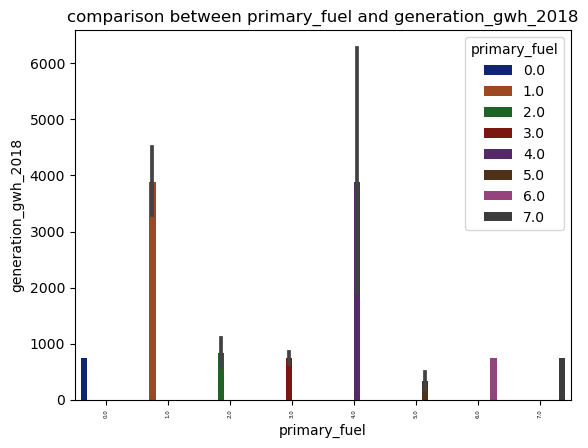

<Figure size 2800x200 with 0 Axes>

In [54]:
plt.title("comparison between primary_fuel and generation_gwh_2018")
sns.barplot(x= "primary_fuel", y= "generation_gwh_2018", data = global_power_data,hue='primary_fuel', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

primary fuel number 1 and 4 has the highest number of values in the generation_gwh_2017 column.

catplots

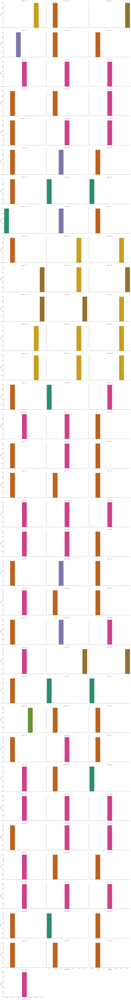

In [56]:
sns.catplot(x= 'primary_fuel', col= 'name', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

no conclusive statements can be made from the above plots.

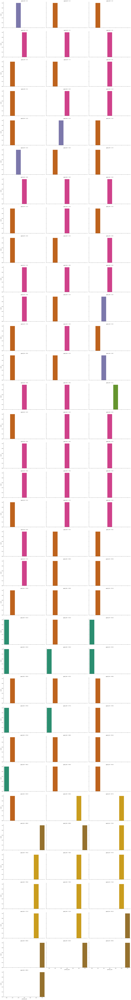

In [58]:
sns.catplot(x= 'primary_fuel', col= 'gppd_idnr', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

no conclusive statements can be made from the above plots.

In [59]:
sns.catplot(x= 'primary_fuel', col= 'capacity_mw', data = global_power_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

capacity_mw number 5 has the highest number of primary fuel values in the above plots.

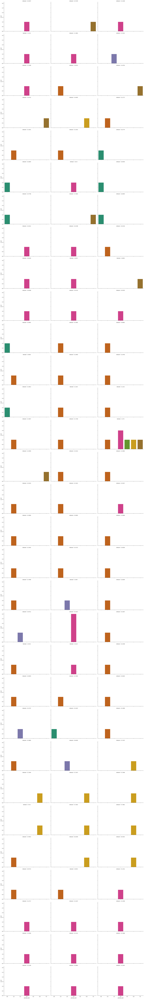

In [61]:
sns.catplot(x= 'primary_fuel', col= 'latitude', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

latitude 21.78 has the highest number of primary fuel values in the above plots.

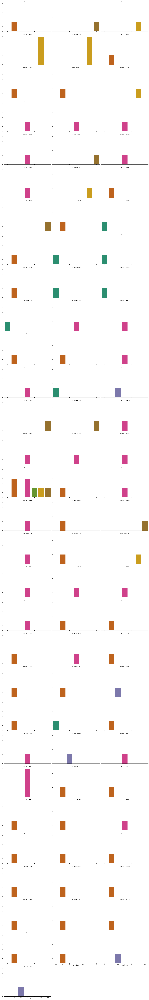

In [63]:
sns.catplot(x= 'primary_fuel', col= 'longitude', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

longitude 76.7196 has the highest number of primary fuel values in their plot.

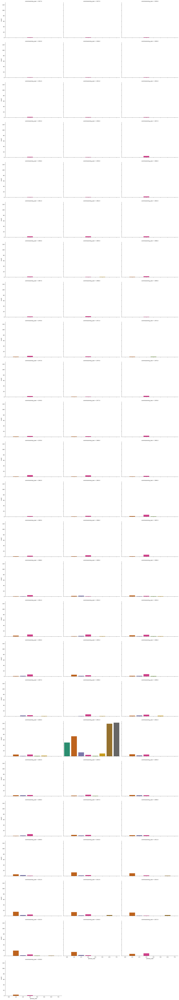

In [64]:
sns.catplot(x= 'primary_fuel', col= 'commissioning_year', data = global_power_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

commisiong_year 2001.0 has the highest number of primary fuel values in the above plots.

In [65]:
sns.catplot(x= 'primary_fuel', col= 'source', data = global_power_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

source 22.0 has the highest number of primary fuel values in the above plots.

In [66]:
sns.catplot(x= 'primary_fuel', col= 'url', data = global_power_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

url 58.0 has the highest number of values of the primary fuel. 

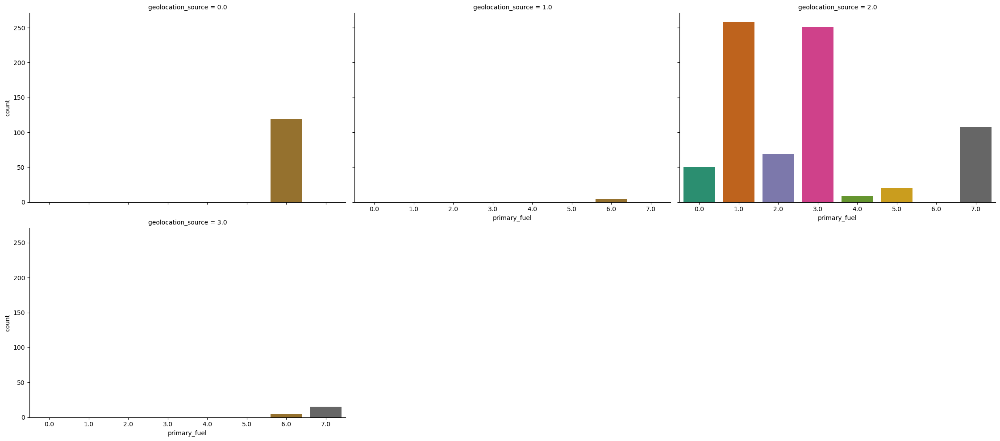

In [67]:
sns.catplot(x= 'primary_fuel', col= 'geolocation_source', data = global_power_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

geolocation_source 2.0 has the highest number of primary values in their plots.

In [68]:
sns.catplot(x= 'primary_fuel', col= 'generation_gwh_2014', data = global_power_data, kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

generation_gwh 2014 801.12355 has the highest number of primary fuel values in their column.

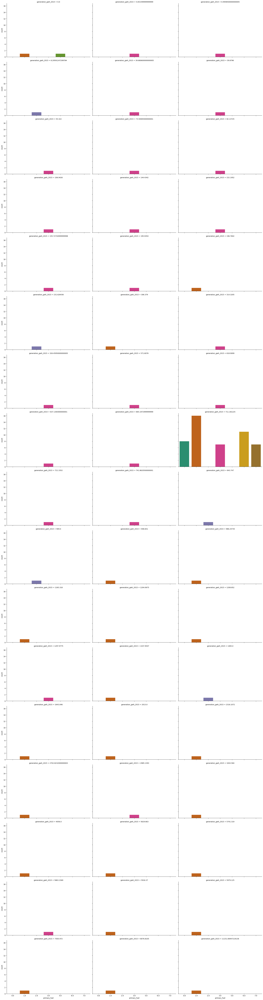

In [70]:
sns.catplot(x= 'primary_fuel', col= 'generation_gwh_2015', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

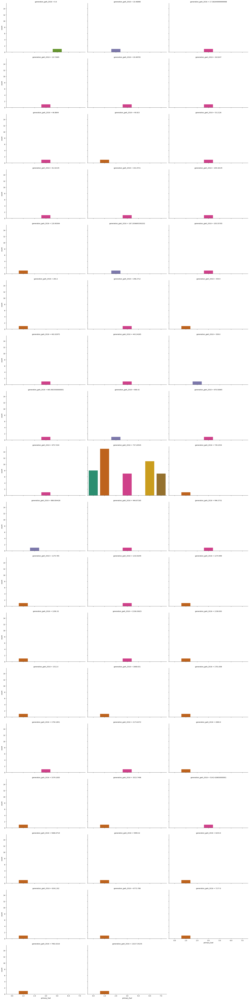

In [72]:
sns.catplot(x= 'primary_fuel', col= 'generation_gwh_2016', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

711.181225 and  737.20545 the highest number primary fuel values in their plots.

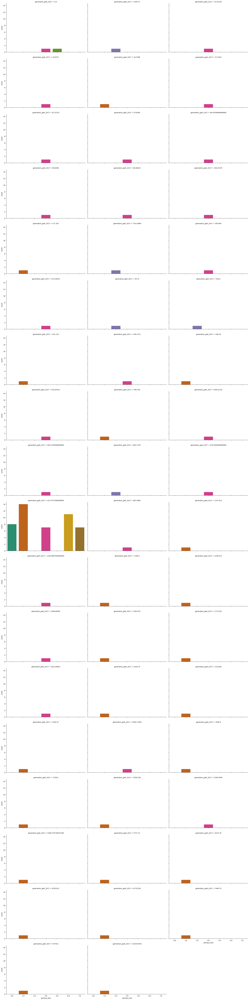

In [74]:
sns.catplot(x= 'primary_fuel', col= 'generation_gwh_2017', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

817.97 has the highest number of primary fuel values in their plots.

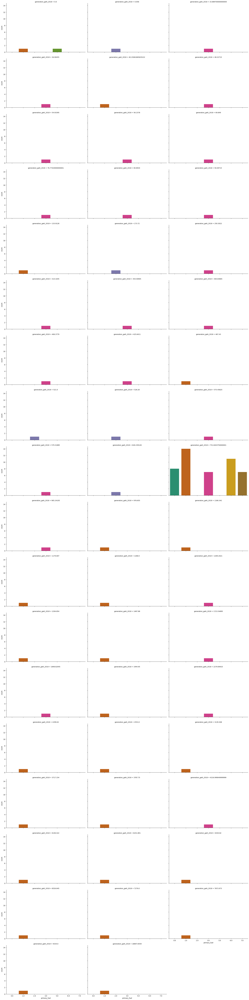

In [76]:
sns.catplot(x= 'primary_fuel', col= 'generation_gwh_2018', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

751.644 has the highest number of primary fuel values in their plot.

Multivariate analysis.

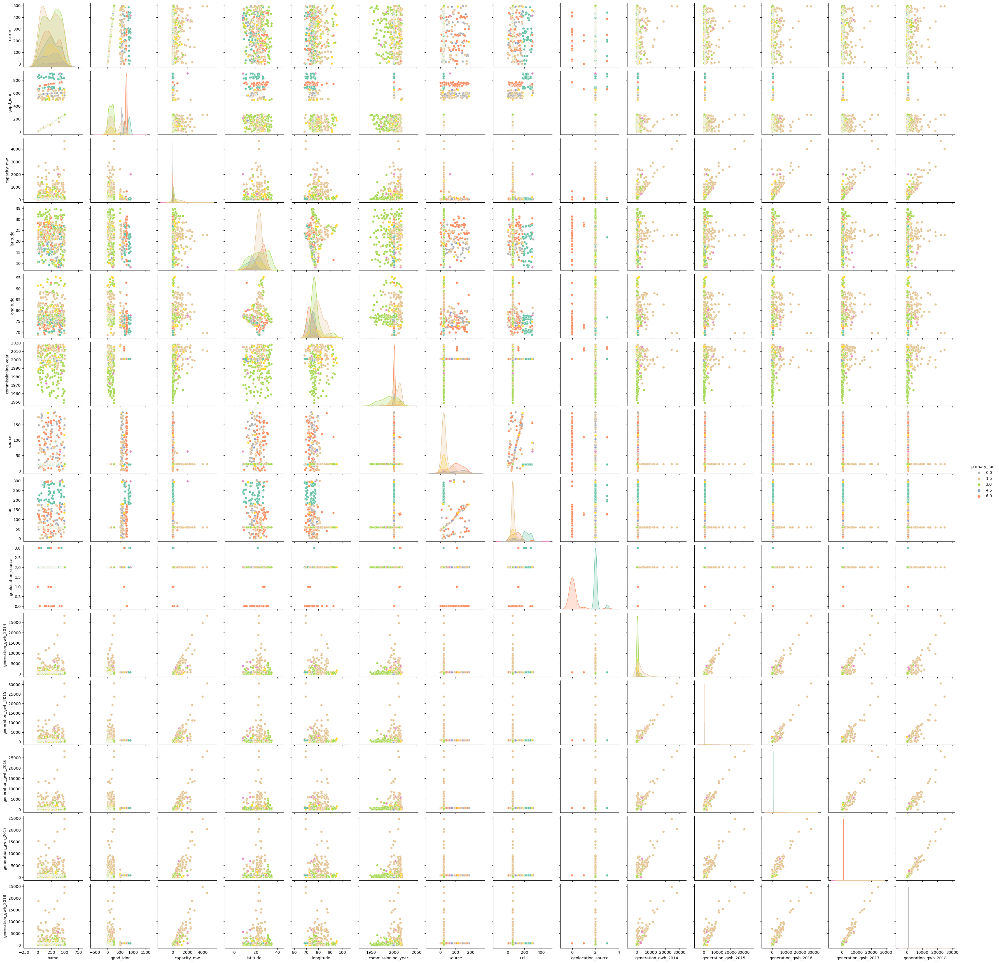

In [77]:
global_power_data_first_500 = global_power_data.head(500)
sns.pairplot(global_power_data_first_500, hue='primary_fuel', palette='Set2_r')
plt.show()

Below are the following details we can can extract from the above plots-

1) 'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', and 'generation_gwh_2018' are postively correlated with capacity_mw.
2) 'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', and 'generation_gwh_2018 are positively correlated with each other.
3) no other variables are correlated or show strong correlation to each other.

Boxplots

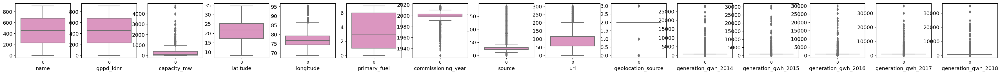

In [78]:
plt.figure(figsize=(45,45),facecolor = "white")
plotnumber=1
for col in global_power_data:
    if plotnumber<=16:
        wc=plt.subplot(15,15,plotnumber)
        sns.boxplot(global_power_data[col],palette="Set2_r")
        plt.xlabel(col,rotation=0,fontsize = 13)
        plt.yticks(rotation = 0, fontsize = 13)
    plotnumber+=1
plt.show()

1) capacity_mw, longitude, commissioning_year,source,url,geolocation_source, 'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', and 'generation_gwh_2018' have outliers above the 75th percentile.
2) commissiong_year has outliers below the 25th percentile.

Lets check for skewness in the dataframe.

In [224]:
global_power_data.skew()

name                   0.000000
gppd_idnr              0.000000
capacity_mw            3.123576
latitude              -0.164152
longitude              1.163320
primary_fuel           0.472251
commissioning_year    -1.719575
source                 1.827373
url                    1.510537
geolocation_source    -1.920302
generation_gwh_2014    5.321360
generation_gwh_2015    5.566773
generation_gwh_2016    5.281953
generation_gwh_2017    5.315103
generation_gwh_2018    5.133226
dtype: float64

capacity_mw,'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', and 'generation_gwh_2018' have high skewness and need to be removed by cbrt method.

In [225]:
global_power_data['generation_gwh_2014']=np.cbrt(global_power_data['generation_gwh_2014'])
global_power_data['generation_gwh_2015']=np.cbrt(global_power_data['generation_gwh_2015'])
global_power_data['generation_gwh_2016']=np.cbrt(global_power_data['generation_gwh_2016'])
global_power_data['generation_gwh_2017']=np.cbrt(global_power_data['generation_gwh_2017'])
global_power_data['generation_gwh_2018']=np.cbrt(global_power_data['generation_gwh_2018'])
global_power_data['capacity_mw']=np.cbrt(global_power_data['capacity_mw'])

In [226]:
global_power_data.skew()

name                   0.000000
gppd_idnr              0.000000
capacity_mw            1.013378
latitude              -0.164152
longitude              1.163320
primary_fuel           0.472251
commissioning_year    -1.719575
source                 1.827373
url                    1.510537
geolocation_source    -1.920302
generation_gwh_2014    1.236059
generation_gwh_2015    1.320130
generation_gwh_2016    1.227003
generation_gwh_2017    1.068037
generation_gwh_2018    1.127219
dtype: float64

The skewness has been corrected.

Distribution plot

let's look at distribution plot of the output column 

C:\Users\ACHU NARAYAN\AppData\Local\Temp\ipykernel_15300\1382880791.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(global_power_data['primary_fuel'],color="b", kde_kws={"shade":True}, hist=False)
C:\ProgramData\anaconda3\Lib\site-packages\seaborn\distributions.py:2511: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  kdeplot(**{axis: a}, ax=ax, color=kde_color, **kde_kws)


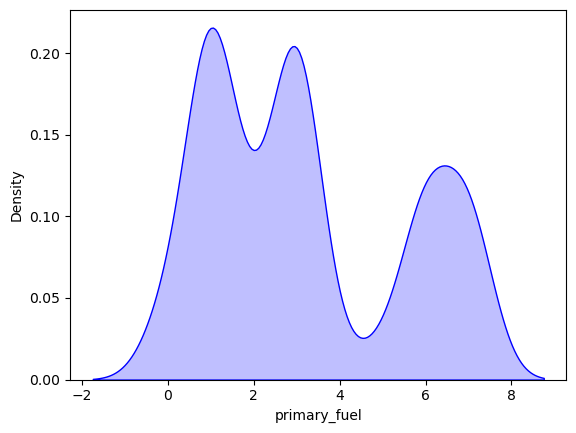

In [82]:
sns.distplot(global_power_data['primary_fuel'],color="b", kde_kws={"shade":True}, hist=False)
plt.show()

Most of the primary_fuel values are between 0 and 4, and between 5 to 8.

Let's use the ordinal encoding method to convert all the values in the dataframe into float data types.

In [227]:
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in global_power_data.columns:
    if global_power_data[i].dtypes=='int64':
        global_power_data[i]=OE.fit_transform(global_power_data[i].values.reshape(-1,1))
global_power_data

,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,0.0,657.0,1.357209,28.1839,73.2407,6.0,2011.0,109.0,128.0,1.0,9.287522,8.926066,9.033641,9.352199,9.092238
1,1.0,519.0,4.610436,24.7663,74.6090,1.0,2001.0,174.0,173.0,2.0,9.287522,8.926066,9.033641,9.352199,9.092238
2,2.0,853.0,3.396999,21.9038,69.3732,7.0,2001.0,21.0,205.0,2.0,9.287522,8.926066,9.033641,9.352199,9.092238
3,3.0,0.0,5.129928,23.8712,91.3602,2.0,2004.0,22.0,58.0,2.0,8.516872,9.449397,9.604586,8.723154,8.555526
4,4.0,1.0,12.164404,21.9603,82.4091,1.0,2015.0,22.0,58.0,2.0,14.479241,18.086385,18.413278,17.528476,19.380155
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
902,902.0,491.0,11.696071,16.2949,77.3568,1.0,2016.0,22.0,58.0,2.0,9.287522,0.998289,6.158697,9.529548,8.821590
903,903.0,822.0,1.442250,12.8932,78.1654,6.0,2001.0,77.0,22.0,0.0,9.287522,8.926066,9.033641,9.352199,9.092238
904,904.0,891.0,2.943383,15.2758,75.5811,7.0,2001.0,21.0,260.0,2.0,9.287522,8.926066,9.033641,9.352199,9.092238
905,905.0,539.0,4.308869,24.3500,73.7477,1.0,2001.0,59.0,82.0,2.0,9.287522,8.926066,9.033641,9.352199,9.092238


Now let's get the correlation matrix to see the different correlations with each other.

In [228]:
correlation = global_power_data.corr()
correlation

,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
name,1.000000,0.332205,0.032366,-0.134571,0.019222,0.040753,-0.044514,-0.014640,0.041917,0.045882,0.070411,0.047631,0.044042,0.054504,0.041927
gppd_idnr,0.332205,1.000000,-0.508197,-0.105090,-0.378588,0.609180,0.167532,0.416384,0.597080,-0.410443,-0.052028,-0.083363,-0.092047,-0.079684,-0.102935
capacity_mw,0.032366,-0.508197,1.000000,0.068484,0.288113,-0.500583,0.206347,-0.355100,-0.332217,0.326658,0.544013,0.584654,0.614859,0.606417,0.622113
latitude,-0.134571,-0.105090,0.068484,1.000000,0.035619,-0.007538,0.088098,0.054324,-0.129180,-0.173600,0.095093,0.091774,0.105996,0.095230,0.098443
longitude,0.019222,-0.378588,0.288113,0.035619,1.000000,-0.352056,0.029583,-0.236623,-0.305768,0.236504,0.064185,0.080627,0.121639,0.106328,0.122132
primary_fuel,0.040753,0.609180,-0.500583,-0.007538,-0.352056,1.000000,-0.054885,0.053613,0.589886,-0.420263,-0.193198,-0.216600,-0.230192,-0.213761,-0.229506
commissioning_year,-0.044514,0.167532,0.206347,0.088098,0.029583,-0.054885,1.000000,0.100747,0.097739,-0.060077,0.104087,0.143407,0.199354,0.186126,0.182961
source,-0.014640,0.416384,-0.355100,0.054324,-0.236623,0.053613,0.100747,1.000000,0.160144,-0.491984,-0.054019,-0.065676,-0.064402,-0.054738,-0.068214
url,0.041917,0.597080,-0.332217,-0.129180,-0.305768,0.589886,0.097739,0.160144,1.000000,0.031037,-0.057196,-0.069539,-0.068189,-0.057957,-0.072226
geolocation_source,0.045882,-0.410443,0.326658,-0.173600,0.236504,-0.420263,-0.060077,-0.491984,0.031037,1.000000,0.038759,0.047124,0.046209,0.039275,0.048945


let's visualise it using the heatmap.

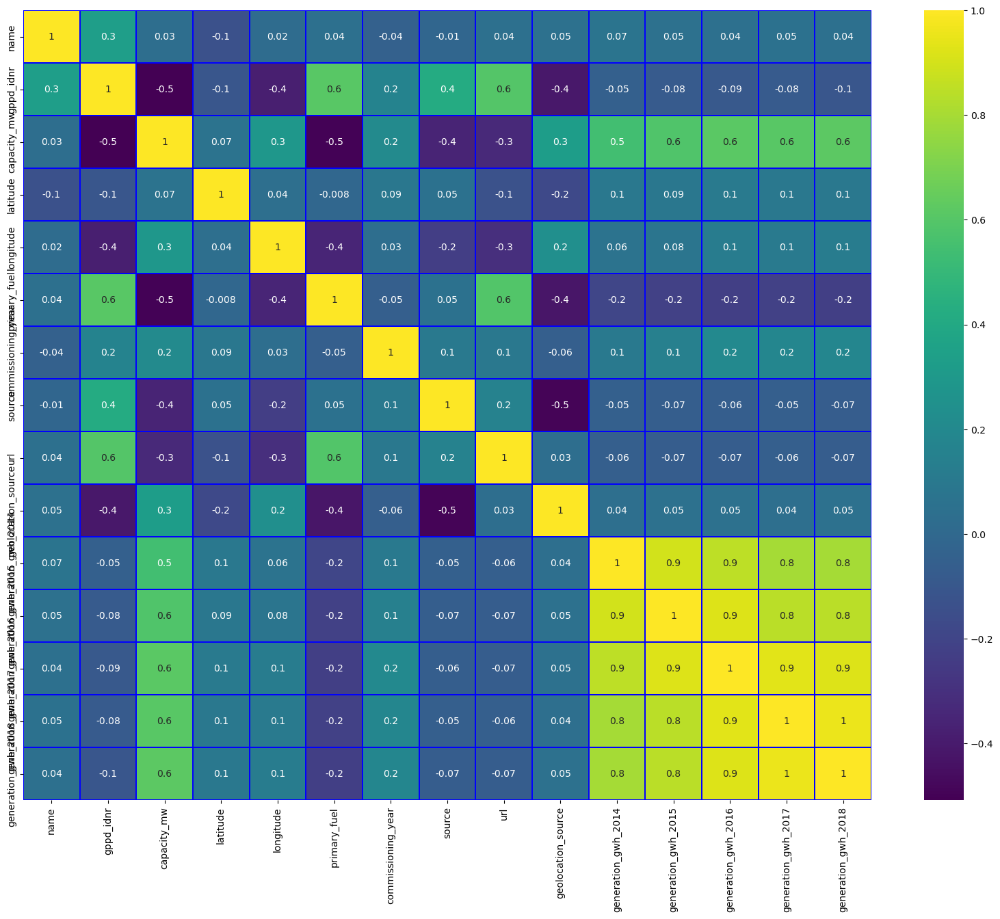

In [229]:
plt.figure(figsize = (20,15))
sns.heatmap(global_power_data.corr(), linewidths = 0.1, fmt = ".1g", linecolor= "blue", annot=True, cmap= "viridis")
plt.yticks(rotation=90);
plt.show()

Below are the following details we get from the above plots-
1) gppd_inr is negatively correlated with capacity_mw,url and longitude, and positively correlated with primary_fuel and geolocation source.
2) 'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', and 'generation_gwh_2018 are positively correlated to each other.
3) primary_fuel and url is positively correlated with each other.
4) 'generation_gwh_2014', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', and 'generation_gwh_2018 are positively correlated with capacity_mw.
5) source is negatively correlated with geolocation_source
6) rest of the correlations are weak or non-existent in nature.

let's sort the correlation values based on our output column- primary_fuel

In [87]:
correlation['primary_fuel'].sort_values(ascending = False)

primary_fuel           1.000000
gppd_idnr              0.609180
url                    0.589886
source                 0.053613
name                   0.040753
latitude              -0.007538
commissioning_year    -0.054885
generation_gwh_2014   -0.193198
generation_gwh_2017   -0.213761
generation_gwh_2015   -0.216600
generation_gwh_2018   -0.229506
generation_gwh_2016   -0.230192
longitude             -0.352056
geolocation_source    -0.420263
capacity_mw           -0.500583
Name: primary_fuel, dtype: float64

lets visualise it using the boxplots

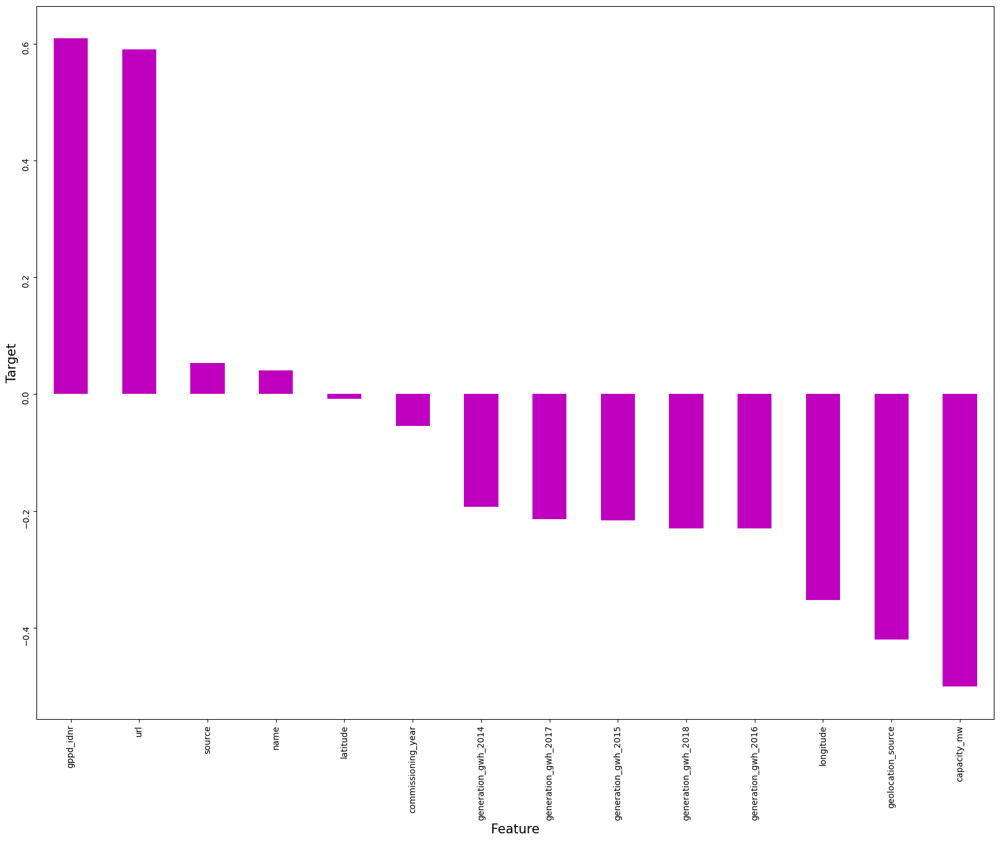

In [88]:
plt.figure(figsize = (20,15))
correlation['primary_fuel'].sort_values(ascending=False).drop(['primary_fuel']).plot(kind='bar',color="m")
plt.xlabel('Feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.yticks(rotation=90);
plt.show()

We will be removing columns with very low correlation to our target column later in the project. lets first declare the x and y variables, scale them and get the vif values before removing any unnecesary columns.

In [89]:
x = global_power_data.drop("primary_fuel", axis=1)
y = global_power_data["primary_fuel"]

We will be using the standard scaler to scale the entire dataframe.

In [90]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,name,gppd_idnr,capacity_mw,latitude,longitude,commissioning_year,source,url,geolocation_source,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,-1.730142,0.779137,-1.126096,1.144693,-0.869917,0.933076,1.460215,0.476673,-1.077648,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
1,-1.726323,0.252074,-0.132660,0.582324,-0.585590,0.172699,2.917019,1.116401,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
2,-1.722504,1.527719,-0.503206,0.111296,-1.673567,0.172699,-0.512075,1.571318,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
3,-1.718684,-1.730142,0.025977,0.435034,2.895239,0.400812,-0.489662,-0.518459,0.351338,-0.296090,-0.013956,-0.002911,-0.251235,-0.254982
4,-1.714865,-1.726323,2.174090,0.120593,1.035238,1.237227,-0.489662,-0.518459,0.351338,1.141189,1.969321,1.981343,1.700758,2.077959
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
902,1.714865,0.145133,2.031075,-0.811655,-0.014609,1.313265,-0.489662,-0.518459,0.351338,-0.110318,-1.954550,-0.779135,-0.072471,-0.197639
903,1.718684,1.409321,-1.100127,-1.371409,0.153415,0.172699,0.743019,-1.030242,-2.506634,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
904,1.722504,1.672853,-0.641727,-0.979349,-0.383592,0.172699,-0.512075,2.353208,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
905,1.726323,0.328460,-0.224749,0.513821,-0.764564,0.172699,0.339596,-0.177271,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309


Now let's check the vif values.

In [91]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
                     for i in range(len(x.columns))]
vif["Features"] = x.columns

vif

,VIF values,Features
0,1.462848,name
1,3.919875,gppd_idnr
2,3.217222,capacity_mw
3,1.100417,latitude
4,1.257362,longitude
5,1.300620,commissioning_year
6,1.486425,source
7,2.055348,url
8,1.850954,geolocation_source
9,5.286920,generation_gwh_2014


Now we will be removing the columns with low correlation and high vif- 'source','name','latitude','commissioning_year','generation_gwh_2014'.

In [92]:
columns_with_low_corelation_and_high_VIF = ['source','name','latitude','commissioning_year','generation_gwh_2014']
global_power_data = global_power_data.drop(columns=columns_with_low_corelation_and_high_VIF)

now that we have removed the undesired columns, let's check the vif values again.

In [93]:
x = global_power_data.drop("primary_fuel", axis=1)
y = global_power_data["primary_fuel"]

In [94]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,gppd_idnr,capacity_mw,longitude,url,geolocation_source,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,0.779137,-1.126096,-0.869917,0.476673,-1.077648,-0.134126,-0.131523,-0.111786,-0.139309
1,0.252074,-0.132660,-0.585590,1.116401,0.351338,-0.134126,-0.131523,-0.111786,-0.139309
2,1.527719,-0.503206,-1.673567,1.571318,0.351338,-0.134126,-0.131523,-0.111786,-0.139309
3,-1.730142,0.025977,2.895239,-0.518459,0.351338,-0.013956,-0.002911,-0.251235,-0.254982
4,-1.726323,2.174090,1.035238,-0.518459,0.351338,1.969321,1.981343,1.700758,2.077959
...,...,...,...,...,...,...,...,...,...
902,0.145133,2.031075,-0.014609,-0.518459,0.351338,-1.954550,-0.779135,-0.072471,-0.197639
903,1.409321,-1.100127,0.153415,-1.030242,-2.506634,-0.134126,-0.131523,-0.111786,-0.139309
904,1.672853,-0.641727,-0.383592,2.353208,0.351338,-0.134126,-0.131523,-0.111786,-0.139309
905,0.328460,-0.224749,-0.764564,-0.177271,0.351338,-0.134126,-0.131523,-0.111786,-0.139309


In [95]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
                     for i in range(len(x.columns))]
vif["Features"] = x.columns

vif

,VIF values,Features
0,2.492639,gppd_idnr
1,2.664994,capacity_mw
2,1.233315,longitude
3,1.887648,url
4,1.509191,geolocation_source
5,6.821025,generation_gwh_2015
6,14.893083,generation_gwh_2016
7,14.471849,generation_gwh_2017
8,13.033707,generation_gwh_2018


the vif values are corrected, lets check for the y value counts and correct it with smote analysis.

In [96]:
y.value_counts()

1.0    258
3.0    251
6.0    127
7.0    123
2.0     69
0.0     50
5.0     20
4.0      9
Name: primary_fuel, dtype: int64

In [97]:
from imblearn.over_sampling import SMOTE
SM = SMOTE()
x1,y1 = SM.fit_resample(x,y)

In [98]:
y1.value_counts()

6.0    258
1.0    258
7.0    258
2.0    258
3.0    258
0.0    258
5.0    258
4.0    258
Name: primary_fuel, dtype: int64

now that the values are corrected, let's check for z-values.

In [101]:
from scipy.stats import zscore
out_features=global_power_data[['gppd_idnr', 'capacity_mw', 'longitude', 'url', 'geolocation_source', 'generation_gwh_2015', 'generation_gwh_2016', 'generation_gwh_2017', 'generation_gwh_2018']]
z=np.abs(zscore(out_features))
z

,gppd_idnr,capacity_mw,longitude,url,geolocation_source,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,0.779137,1.126096,0.869917,0.476673,1.077648,0.134126,0.131523,0.111786,0.139309
1,0.252074,0.132660,0.585590,1.116401,0.351338,0.134126,0.131523,0.111786,0.139309
2,1.527719,0.503206,1.673567,1.571318,0.351338,0.134126,0.131523,0.111786,0.139309
3,1.730142,0.025977,2.895239,0.518459,0.351338,0.013956,0.002911,0.251235,0.254982
4,1.726323,2.174090,1.035238,0.518459,0.351338,1.969321,1.981343,1.700758,2.077959
...,...,...,...,...,...,...,...,...,...
902,0.145133,2.031075,0.014609,0.518459,0.351338,1.954550,0.779135,0.072471,0.197639
903,1.409321,1.100127,0.153415,1.030242,2.506634,0.134126,0.131523,0.111786,0.139309
904,1.672853,0.641727,0.383592,2.353208,0.351338,0.134126,0.131523,0.111786,0.139309
905,0.328460,0.224749,0.764564,0.177271,0.351338,0.134126,0.131523,0.111786,0.139309


now lets find all the values in the dataframe where the z score is above 3/-3.

In [102]:
np.where(z>3)

(array([ 15,  15,  15, 143, 143, 143, 179, 183, 209, 209, 244, 308, 308,
        308, 308, 323, 333, 340, 360, 364, 364, 364, 364, 416, 427, 493,
        493, 493, 493, 493, 494, 494, 494, 494, 494, 499, 519, 546, 577,
        638, 648, 648, 648, 648, 657, 657, 657, 657, 695, 695, 695, 695,
        695, 721, 721, 724, 724, 724, 724, 726, 726, 726, 726, 786, 786,
        786, 786, 808, 808, 808, 808, 808, 818, 847, 880, 880, 880, 880,
        880], dtype=int64),
 array([6, 7, 8, 6, 7, 8, 2, 2, 6, 8, 2, 5, 6, 7, 8, 2, 2, 2, 2, 5, 6, 7,
        8, 2, 2, 1, 5, 6, 7, 8, 1, 5, 6, 7, 8, 2, 2, 2, 2, 2, 5, 6, 7, 8,
        5, 6, 7, 8, 1, 5, 6, 7, 8, 5, 6, 5, 6, 7, 8, 5, 6, 7, 8, 5, 6, 7,
        8, 1, 5, 6, 7, 8, 2, 2, 1, 5, 6, 7, 8], dtype=int64))

now lets remove all the rows whose zscore is above 3/-3 and check the new shape of our dataframe.

In [103]:
global_power_data_new=global_power_data[(z<3).all(axis=1)]
global_power_data_new.shape

(875, 10)

lets check the data loss percentage after removal of the columns.

In [105]:
data_loss_percentage = ((global_power_data.shape[0] - global_power_data_new.shape[0]) / global_power_data.shape[0]) * 100
print("Data Loss Percentage:", data_loss_percentage)

Data Loss Percentage: 3.528114663726571


now let's use the scaled data and declare the x and y variables.

In [106]:
x = global_power_data_new.drop("primary_fuel", axis=1)
y = global_power_data_new["primary_fuel"]

In [107]:
y.value_counts()

1.0    242
3.0    240
6.0    126
7.0    123
2.0     65
0.0     50
5.0     20
4.0      9
Name: primary_fuel, dtype: int64

let's balance the y values using the smote analysis

In [108]:
from imblearn.over_sampling import SMOTE
SM = SMOTE()
x1,y1 = SM.fit_resample(x,y)

In [109]:
y1.value_counts()

6.0    242
1.0    242
7.0    242
2.0    242
3.0    242
0.0    242
5.0    242
4.0    242
Name: primary_fuel, dtype: int64

now that we have balanced the y variables, lets move to the prediction phase.

Predictions

now lets check for the best accuracy score at the maximum random state.

In [110]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
maxaccuracy = 0
maxrandomstate = 0
for i in range(1,200):
      x_train,x_test,y_train,y_test = train_test_split(x1,y1, test_size = 0.30, random_state=i)
      RFC = RandomForestClassifier()
      RFC.fit(x_train,y_train)
pred=RFC.predict(x_test)
acc = accuracy_score(y_test, pred)
if acc>maxaccuracy:
    maxaccuracy=acc
    maxrandomstate=i
print("the best accuracy score",maxaccuracy,"at the following random state",maxrandomstate)

the best accuracy score 0.8950086058519794 at the following random state 199


So we found out that the best accuracy score is 0.8950086058519794 at the following random state 199.

lets train the model using the same split(70-30) same as we did before and use all the classification models to select the best model.

In [111]:
x_train,x_test,y_train,y_test = train_test_split(x1,y1, test_size = 0.30, random_state=maxrandomstate)

We will be using the RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier, Support vector classifier, LogisticRegression and KNN classification.

In [112]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, accuracy_score

Random forest classifier gives the best accuracy score 0.8984509466437177 while the precision, recall and f1 score are within the ranges of .91 to .99.

In [113]:
RFC = RandomForestClassifier()
RFC.fit(x_train,y_train)
pred=RFC.predict(x_test)
print(accuracy_score(y_test, pred))
print(confusion_matrix(y_test,pred))
print(classification_report(y_test,pred))

0.8984509466437177
[[78  1  0  0  0  0  0  0]
 [ 7 34  6  6  3  1  0  0]
 [ 1  2 62  4  0  1  0  0]
 [ 0  1  9 61  5  1  0  0]
 [ 0  2  1  1 72  0  0  0]
 [ 0  2  0  5  0 62  0  0]
 [ 0  0  0  0  0  0 67  0]
 [ 0  0  0  0  0  0  0 86]]
              precision    recall  f1-score   support

         0.0       0.91      0.99      0.95        79
         1.0       0.81      0.60      0.69        57
         2.0       0.79      0.89      0.84        70
         3.0       0.79      0.79      0.79        77
         4.0       0.90      0.95      0.92        76
         5.0       0.95      0.90      0.93        69
         6.0       1.00      1.00      1.00        67
         7.0       1.00      1.00      1.00        86

    accuracy                           0.90       581
   macro avg       0.89      0.89      0.89       581
weighted avg       0.90      0.90      0.90       581



LogisticRegression gives the best accuracy score 0.733218588640 while the precision, recall and f1 score are within the ranges of .75 to .95.

In [118]:
LogReg = LogisticRegression(max_iter=6000)
LogReg.fit(x_train,y_train)
predLogReg=LogReg.predict(x_test)
print(accuracy_score(y_test, predLogReg))
print(confusion_matrix(y_test,predLogReg))
print(classification_report(y_test,predLogReg))

0.7332185886402753
[[75  0  0  2  0  1  0  1]
 [12 20  3  7  8  6  0  1]
 [ 2 12 31  9  6 10  0  0]
 [ 4  6 10 44  5  8  0  0]
 [ 0 17  3  0 56  0  0  0]
 [ 7  2  1  9  0 50  0  0]
 [ 0  1  0  0  0  1 65  0]
 [ 0  0  1  0  0  0  0 85]]
              precision    recall  f1-score   support

         0.0       0.75      0.95      0.84        79
         1.0       0.34      0.35      0.35        57
         2.0       0.63      0.44      0.52        70
         3.0       0.62      0.57      0.59        77
         4.0       0.75      0.74      0.74        76
         5.0       0.66      0.72      0.69        69
         6.0       1.00      0.97      0.98        67
         7.0       0.98      0.99      0.98        86

    accuracy                           0.73       581
   macro avg       0.72      0.72      0.71       581
weighted avg       0.73      0.73      0.73       581



C:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


GradientBoostingClassifier gives the best accuracy score 0.8743545611 while the precision, recall and f1 score are within the ranges of .93 to .97.

In [119]:
GradBoos = GradientBoostingClassifier()
GradBoos.fit(x_train,y_train)
predGradBoos=GradBoos.predict(x_test)
print(accuracy_score(y_test, predGradBoos))
print(confusion_matrix(y_test,predGradBoos))
print(classification_report(y_test,predGradBoos))

0.8743545611015491
[[77  1  0  0  0  1  0  0]
 [ 6 33 11  4  2  1  0  0]
 [ 0  4 57  6  1  2  0  0]
 [ 0  4 10 58  4  1  0  0]
 [ 0  3  3  1 69  0  0  0]
 [ 0  3  0  5  0 61  0  0]
 [ 0  0  0  0  0  0 67  0]
 [ 0  0  0  0  0  0  0 86]]
              precision    recall  f1-score   support

         0.0       0.93      0.97      0.95        79
         1.0       0.69      0.58      0.63        57
         2.0       0.70      0.81      0.75        70
         3.0       0.78      0.75      0.77        77
         4.0       0.91      0.91      0.91        76
         5.0       0.92      0.88      0.90        69
         6.0       1.00      1.00      1.00        67
         7.0       1.00      1.00      1.00        86

    accuracy                           0.87       581
   macro avg       0.87      0.86      0.86       581
weighted avg       0.87      0.87      0.87       581



BaggingClassifier gives the best accuracy score 0.8795180722891 while the precision, recall and f1 score are within the ranges of .92 to 1.00.

In [120]:
BagClass = BaggingClassifier()
BagClass.fit(x_train,y_train)
predBagClass=BagClass.predict(x_test)
print(accuracy_score(y_test, predBagClass))
print(confusion_matrix(y_test,predBagClass))
print(classification_report(y_test,predBagClass))

0.8795180722891566
[[79  0  0  0  0  0  0  0]
 [ 6 35  9  2  3  2  0  0]
 [ 1  1 57  7  1  3  0  0]
 [ 0  7  6 61  3  0  0  0]
 [ 0  4  3  1 68  0  0  0]
 [ 0  4  0  7  0 58  0  0]
 [ 0  0  0  0  0  0 67  0]
 [ 0  0  0  0  0  0  0 86]]
              precision    recall  f1-score   support

         0.0       0.92      1.00      0.96        79
         1.0       0.69      0.61      0.65        57
         2.0       0.76      0.81      0.79        70
         3.0       0.78      0.79      0.79        77
         4.0       0.91      0.89      0.90        76
         5.0       0.92      0.84      0.88        69
         6.0       1.00      1.00      1.00        67
         7.0       1.00      1.00      1.00        86

    accuracy                           0.88       581
   macro avg       0.87      0.87      0.87       581
weighted avg       0.88      0.88      0.88       581



ExtraTreesClassifier gives the best accuracy score 0.90705679 while the precision, recall and f1 score are within the ranges of .89 to .99.

In [121]:
Extrees = ExtraTreesClassifier()
Extrees.fit(x_train,y_train)
predExtrees=Extrees.predict(x_test)
print(accuracy_score(y_test, predExtrees))
print(confusion_matrix(y_test,predExtrees))
print(classification_report(y_test,predExtrees))

0.9070567986230637
[[78  1  0  0  0  0  0  0]
 [ 9 35  4  6  2  1  0  0]
 [ 1  0 62  5  0  2  0  0]
 [ 0  4  9 62  1  1  0  0]
 [ 0  1  2  0 73  0  0  0]
 [ 0  0  0  5  0 64  0  0]
 [ 0  0  0  0  0  0 67  0]
 [ 0  0  0  0  0  0  0 86]]
              precision    recall  f1-score   support

         0.0       0.89      0.99      0.93        79
         1.0       0.85      0.61      0.71        57
         2.0       0.81      0.89      0.84        70
         3.0       0.79      0.81      0.80        77
         4.0       0.96      0.96      0.96        76
         5.0       0.94      0.93      0.93        69
         6.0       1.00      1.00      1.00        67
         7.0       1.00      1.00      1.00        86

    accuracy                           0.91       581
   macro avg       0.91      0.90      0.90       581
weighted avg       0.91      0.91      0.90       581



Support vector classifier gives the best accuracy score 0.552495697 while the precision, recall and f1 score are within the ranges of .57 to .96.

In [122]:
SVC = SVC()
SVC.fit(x_train,y_train)
predSVC=SVC.predict(x_test)
print(accuracy_score(y_test, predSVC))
print(confusion_matrix(y_test,predSVC))
print(classification_report(y_test,predSVC,zero_division=1))

0.5524956970740104
[[76  0  0  0  0  0  0  3]
 [16  9  3  9 19  0  0  1]
 [12 15  9  6 28  0  0  0]
 [ 0 10  0 20 47  0  0  0]
 [ 2  3  1  2 66  0  0  2]
 [23 12  1 10 23  0  0  0]
 [ 4  0  0  0  0  0 62  1]
 [ 0  0  0  0  0  0  7 79]]
              precision    recall  f1-score   support

         0.0       0.57      0.96      0.72        79
         1.0       0.18      0.16      0.17        57
         2.0       0.64      0.13      0.21        70
         3.0       0.43      0.26      0.32        77
         4.0       0.36      0.87      0.51        76
         5.0       1.00      0.00      0.00        69
         6.0       0.90      0.93      0.91        67
         7.0       0.92      0.92      0.92        86

    accuracy                           0.55       581
   macro avg       0.63      0.53      0.47       581
weighted avg       0.64      0.55      0.49       581



AdaBoostClassifier gives the best accuracy score 0.2925989672977 while the precision, recall and f1 score are within the ranges of .13 to .71.

In [123]:
AdaBoos = AdaBoostClassifier()
AdaBoos.fit(x_train,y_train)
Adapred=AdaBoos.predict(x_test)
print(accuracy_score(y_test, Adapred))
print(confusion_matrix(y_test,Adapred))
print(classification_report(y_test,Adapred))

0.29259896729776247
[[10  3  0 66  0  0  0  0]
 [ 3  0 48  6  0  0  0  0]
 [ 1  0 68  1  0  0  0  0]
 [ 0  0 52 25  0  0  0  0]
 [ 0  0 74  0  0  0  2  0]
 [ 0  0 54 15  0  0  0  0]
 [ 0  0  0  0  0  0 67  0]
 [ 0  0  0  0  0  0 86  0]]
              precision    recall  f1-score   support

         0.0       0.71      0.13      0.22        79
         1.0       0.00      0.00      0.00        57
         2.0       0.23      0.97      0.37        70
         3.0       0.22      0.32      0.26        77
         4.0       0.00      0.00      0.00        76
         5.0       0.00      0.00      0.00        69
         6.0       0.43      1.00      0.60        67
         7.0       0.00      0.00      0.00        86

    accuracy                           0.29       581
   macro avg       0.20      0.30      0.18       581
weighted avg       0.20      0.29      0.18       581



C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


KNeighborsClassifier gives the best accuracy score 0.7110266159 while the precision, recall and f1 score are within the ranges of .41 to .53.

In [129]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(x_train, y_train)
pred = knn.predict(x_test)
print("Accuracy Score:", accuracy_score(y_test, pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred))
print("Classification Report:")
print(classification_report(y_test, pred))

Accuracy Score: 0.7110266159695817
Confusion Matrix:
[[ 9  7  0  0  0  0  0  1]
 [10 42  0 19  0  0  0  1]
 [ 1  8  0  9  0  0  1  0]
 [ 0  9  0 64  0  0  0  0]
 [ 0  3  1  1  0  0  0  0]
 [ 2  1  0  2  0  0  0  0]
 [ 0  0  0  0  0  0 29  0]
 [ 0  0  0  0  0  0  0 43]]
Classification Report:
              precision    recall  f1-score   support

         0.0       0.41      0.53      0.46        17
         1.0       0.60      0.58      0.59        72
         2.0       0.00      0.00      0.00        19
         3.0       0.67      0.88      0.76        73
         4.0       0.00      0.00      0.00         5
         5.0       0.00      0.00      0.00         5
         6.0       0.97      1.00      0.98        29
         7.0       0.96      1.00      0.98        43

    accuracy                           0.71       263
   macro avg       0.45      0.50      0.47       263
weighted avg       0.64      0.71      0.67       263



C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


lets get the r2 score for logistic regression to get the cross-validation score later on.

In [124]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.30, random_state=42)
LogRegmodel = LogisticRegression(max_iter=1000)
LogRegmodel.fit(x_train, y_train)
true_values = y_test
predicted_values = LogRegmodel.predict(x_test)

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


lets get the predicted values using the logistic regression model.

In [125]:
predicted_values

array([6., 3., 6., 1., 6., 2., 7., 3., 3., 3., 0., 0., 0., 7., 1., 1., 3.,
       7., 1., 0., 1., 1., 3., 3., 7., 3., 1., 7., 7., 7., 6., 0., 3., 7.,
       6., 0., 3., 1., 3., 1., 2., 7., 7., 0., 7., 3., 7., 3., 1., 1., 1.,
       7., 3., 3., 3., 3., 3., 1., 1., 6., 1., 3., 1., 1., 1., 6., 6., 3.,
       0., 7., 1., 0., 1., 2., 7., 1., 3., 6., 1., 3., 0., 3., 1., 3., 3.,
       3., 6., 7., 6., 1., 3., 7., 7., 7., 1., 7., 3., 1., 4., 3., 1., 7.,
       1., 3., 1., 1., 0., 1., 1., 1., 3., 7., 1., 1., 0., 7., 6., 1., 1.,
       3., 7., 5., 6., 3., 3., 1., 3., 5., 1., 7., 6., 6., 7., 6., 2., 7.,
       1., 1., 7., 3., 1., 1., 6., 6., 3., 3., 3., 3., 7., 0., 1., 1., 7.,
       1., 1., 7., 6., 3., 1., 2., 1., 1., 3., 6., 6., 7., 7., 1., 6., 1.,
       3., 0., 3., 3., 1., 2., 6., 3., 1., 1., 3., 3., 3., 0., 7., 1., 6.,
       3., 7., 3., 3., 2., 3., 7., 1., 3., 3., 7., 3., 3., 1., 3., 7., 1.,
       6., 1., 3., 3., 1., 1., 3., 6., 3., 1., 1., 0., 3., 6., 1., 1., 0.,
       3., 3., 0., 1., 0.

In [127]:
from sklearn.metrics import r2_score
predicted_values = [6., 3., 6., 1., 6., 2., 7., 3., 3., 3., 0., 0., 0., 7., 1., 1., 3.,7., 1., 0.]
true_values = [6.,1.,7.,2.,1.,1.,3.,3.,3.,1.,1.,3.,1.,3.,3.,1.,2.,1.,1.,0.]
r2 = r2_score(true_values, predicted_values)
print("R2 Score:", r2)

R2 Score: -1.0270270270270268


We got an r2 score of 1.027027.

cross- validation scores

In [128]:
X = x
y = y
classifier = ExtraTreesClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.80571429 0.81142857 0.88571429 0.80571429 0.81714286]
Mean Score: 0.8251428571428571
Standard Deviation: 0.030580772937736332


In [130]:
X = x
y = y
classifier = BaggingClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.77142857 0.8        0.84571429 0.81714286 0.82285714]
Mean Score: 0.8114285714285714
Standard Deviation: 0.02477655244420434


In [131]:
X = x
y = y
classifier = GradientBoostingClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.8        0.81714286 0.83428571 0.80571429 0.81714286]
Mean Score: 0.814857142857143
Standard Deviation: 0.011766434446842281


In [132]:
X = x
y = y
classifier = RandomForestClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.8        0.80571429 0.87428571 0.81714286 0.81714286]
Mean Score: 0.822857142857143
Standard Deviation: 0.026557600088279436


In [133]:
X = x
y = y
classifier = LogisticRegression(max_iter=1000)
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='r2')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_

Cross-Validation Scores: [0.76844762 0.77968214 0.80694921 0.70947455 0.66303368]
Mean Score: 0.7455174414545026
Standard Deviation: 0.05209518487109437


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [134]:
from sklearn.svm import SVC
X = x
y = y
classifier = SVC()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.66285714 0.6        0.65142857 0.60571429 0.56571429]
Mean Score: 0.6171428571428572
Standard Deviation: 0.03559408343405128


In [135]:
X = x
y = y
classifier = AdaBoostClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.46857143 0.42285714 0.47428571 0.29142857 0.6       ]
Mean Score: 0.4514285714285714
Standard Deviation: 0.09930369826847295


In [136]:
X = x
y = y
classifier = KNeighborsClassifier()
cross_val_scores = cross_val_score(classifier, x, y, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Score:", cross_val_scores.mean())
print("Standard Deviation:", cross_val_scores.std())

Cross-Validation Scores: [0.56       0.50857143 0.61714286 0.64571429 0.58857143]
Mean Score: 0.5839999999999999
Standard Deviation: 0.04731483781596444


After thorough analysis of all the croos validation scores, we found that random forest classifier has the least difference between its accuracy score and its cross validation score that comes upto- 0.0784.

hyperparameter tuning 

We will be using the 'n_estimators': [50, 100, 200, 300],'max_samples': [0.6, 0.7, 0.8],'max_features': [0.6, 0.7, 0.8],'bootstrap': [True],'random_state': [10, 50, 1000],'n_jobs': [-2, -1, 1] to select the best parameters for our random forest classifier.

In [137]:
from sklearn.model_selection import GridSearchCV
parameters = {'n_estimators': [50, 100, 200, 300],'max_samples': [0.6, 0.7, 0.8],'max_features': [0.6, 0.7, 0.8],'bootstrap': [True],'random_state': [10, 50, 1000],'n_jobs': [-2, -1, 1]}

In [138]:
GSCV=GridSearchCV(RandomForestClassifier(),parameters,cv=5)

In [140]:
GSCV.fit(x_train,y_train)

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_split.py:700: UserWarning: The least populated class in y has only 4 members, which is less than n_splits=5.
  warnings.warn(


GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'bootstrap': [True], 'max_features': [0.6, 0.7, 0.8],
                         'max_samples': [0.6, 0.7, 0.8],
                         'n_estimators': [50, 100, 200, 300],
                         'n_jobs': [-2, -1, 1],
                         'random_state': [10, 50, 1000]})

lets get the best hyperparameters to train our selected model.

In [141]:
GSCV.best_params_

{'bootstrap': True,
 'max_features': 0.6,
 'max_samples': 0.6,
 'n_estimators': 100,
 'n_jobs': -2,
 'random_state': 10}

In [142]:
Selected_model = BaggingClassifier(bootstrap=True,max_features= 0.6,max_samples= 0.6,n_estimators= 100,n_jobs= -2,random_state= 10)
Selected_model.fit(x_train,y_train)
pred = Selected_model.predict(x_test)
accuracy= accuracy_score(y_test,pred)
print(accuracy*100)

82.12927756653993


So after hyperparameter tuning, we get an accuracy score of 82.1292775665.

ROC-AUC curve.

we will using all the classifiers to get their roc-auc curves based on the multi class clasification. we will binarising all the values in our desired dataframe to get multiple curves for each classification models. we will setting dictionary values to the false positive rate and true positive rate in order to parse graphs for each primary fuel classification.

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


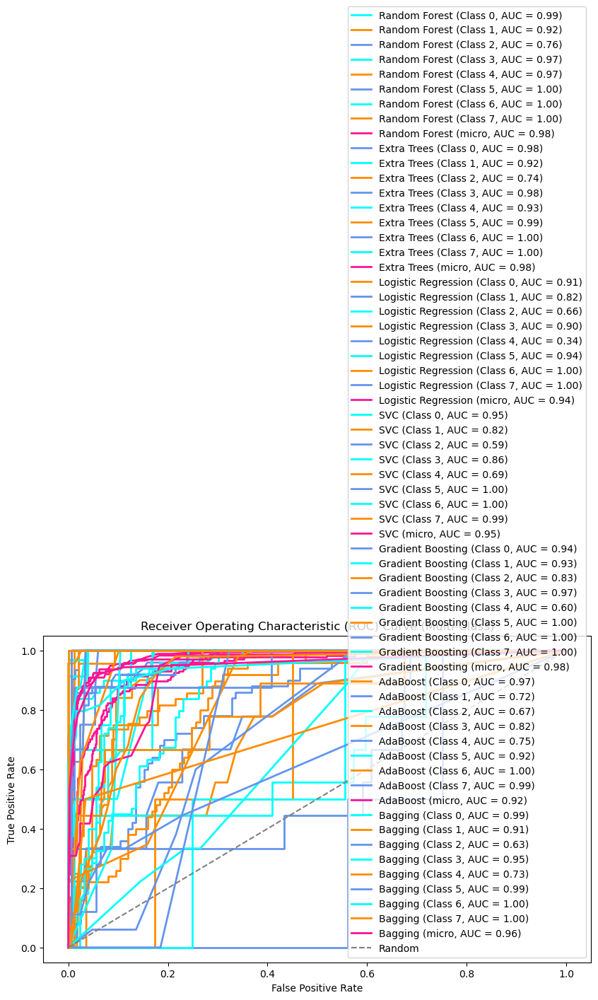

Random Forest: ROC AUC = 0.98
Extra Trees: ROC AUC = 0.98
Logistic Regression: ROC AUC = 0.94
SVC: ROC AUC = 0.95
Gradient Boosting: ROC AUC = 0.98
AdaBoost: ROC AUC = 0.92
Bagging: ROC AUC = 0.96


In [147]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.preprocessing import label_binarize
from itertools import cycle

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)


n_classes = len(np.unique(y))


y_test_bin = label_binarize(y_test, classes=list(range(n_classes)))

classifiers = [
    ("Random Forest", RandomForestClassifier()),
    ("Extra Trees", ExtraTreesClassifier()),
    ("Logistic Regression", LogisticRegression()),
    ("SVC", SVC(probability=True)),  
    ("Gradient Boosting", GradientBoostingClassifier()),
    ("AdaBoost", AdaBoostClassifier()),
    ("Bagging", BaggingClassifier())
]

roc_auc_scores = {}

plt.figure(figsize=(10, 6))
colors = cycle(['aqua', 'darkorange', 'cornflowerblue'])

for classifiername, classifier in classifiers:
    classifier.fit(x_train, y_train)
    y_pred_probability = classifier.predict_proba(x_test)
    

    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_pred_probability[:, i])
        roc_auc[i] = roc_auc_score(y_test_bin[:, i], y_pred_probability[:, i])
    

    fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), y_pred_probability.ravel())
    roc_auc["micro"] = roc_auc_score(y_test_bin, y_pred_probability, average="micro")
    

    for i, color in zip(range(n_classes), colors):
        plt.plot(fpr[i], tpr[i], color=color, lw=2,
                 label=f'{classifiername} (Class {i}, AUC = {roc_auc[i]:.2f})')


    plt.plot(fpr["micro"], tpr["micro"], color='deeppink', lw=2,
             label=f'{classifiername} (micro, AUC = {roc_auc["micro"]:.2f})')

    roc_auc_scores[classifiername] = roc_auc["micro"]

plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve (Multi-Class)')
plt.legend(loc="lower right")
plt.show()

for name, roc_auc in roc_auc_scores.items():
    print(f'{name}: ROC AUC = {roc_auc:.2f}')



Our selected model has performed well with a score of .98.

Saving the model

We will using the joblib method to save our slected model and compare our predicted scores with the original values.

In [148]:
import joblib
joblib.dump(Selected_model,"Global_Power_Data_Analysis.pkl")

['Global_Power_Data_Analysis.pkl']

In [149]:
model = joblib.load("Global_Power_Data_Analysis.pkl")
prediction = model.predict(x_test)
prediction

array([6., 1., 6., 1., 6., 2., 7., 1., 3., 3., 0., 0., 1., 7., 1., 1., 1.,
       7., 3., 5., 1., 1., 3., 3., 7., 3., 1., 7., 7., 7., 6., 0., 3., 7.,
       6., 6., 3., 1., 3., 1., 1., 7., 7., 0., 7., 3., 7., 3., 1., 1., 1.,
       7., 3., 1., 2., 3., 3., 1., 1., 6., 1., 3., 3., 1., 1., 6., 6., 3.,
       1., 7., 1., 0., 1., 1., 7., 1., 3., 6., 1., 3., 1., 3., 1., 3., 3.,
       1., 6., 7., 6., 3., 3., 7., 7., 7., 3., 7., 3., 3., 1., 1., 3., 7.,
       1., 3., 1., 1., 0., 1., 1., 1., 3., 7., 1., 1., 0., 7., 6., 1., 1.,
       3., 7., 2., 6., 3., 3., 1., 1., 5., 1., 7., 6., 6., 7., 6., 2., 7.,
       1., 1., 7., 3., 1., 2., 6., 6., 3., 3., 1., 3., 0., 1., 1., 1., 1.,
       3., 1., 7., 6., 3., 1., 2., 3., 3., 3., 6., 6., 7., 7., 1., 6., 1.,
       3., 0., 3., 3., 3.])

In [150]:
finaldata = np.array(y_test)
subscribertype = pd.DataFrame()
subscribertype["ourprediction"] = prediction
subscribertype["originalvalues"] = finaldata
subscribertype

,ourprediction,originalvalues
0,6.0,6.0
1,1.0,1.0
2,6.0,6.0
3,1.0,1.0
4,6.0,6.0
...,...,...
170,3.0,3.0
171,0.0,0.0
172,3.0,3.0
173,3.0,3.0


It looks like our model has performed extremely well. Now let's get on second task of regression for capacity_mw.

Part- 2 Regression

All the steps that was done in pre-visual analysis will be repeated other than the steps listed below,

lets declare the y variable for our task number 2, which will be capacity_mw.

In [160]:
globalpowerdata_yvariable = global_power_data.iloc[:, 2:3]
globalpowerdata_yvariable

,capacity_mw
0,2.5
1,98.0
2,39.2
3,135.0
4,1800.0
...,...
902,1600.0
903,3.0
904,25.5
905,80.0


lets declare the rest of the columns as our input columns using the iloc and join commands.

In [161]:
globalpowerdata_xvariable = global_power_data.iloc[:, :2].join(global_power_data.iloc[:, 3:])
globalpowerdata_xvariable

,name,gppd_idnr,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,0.0,657.0,28.1839,73.2407,6.0,2011.0,109.0,128.0,1.0,801.123775,711.181225,737.205450,817.977250,751.644375
1,1.0,519.0,24.7663,74.6090,1.0,2001.0,174.0,173.0,2.0,801.123775,711.181225,737.205450,817.977250,751.644375
2,2.0,853.0,21.9038,69.3732,7.0,2001.0,21.0,205.0,2.0,801.123775,711.181225,737.205450,817.977250,751.644375
3,3.0,0.0,23.8712,91.3602,2.0,2004.0,22.0,58.0,2.0,617.789264,843.747000,886.004428,663.774500,626.239128
4,4.0,1.0,21.9603,82.4091,1.0,2015.0,22.0,58.0,2.0,3035.550000,5916.370000,6243.000000,5385.579736,7279.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
902,902.0,491.0,16.2949,77.3568,1.0,2016.0,22.0,58.0,2.0,801.123775,0.994875,233.596650,865.400000,686.500000
903,903.0,822.0,12.8932,78.1654,6.0,2001.0,77.0,22.0,0.0,801.123775,711.181225,737.205450,817.977250,751.644375
904,904.0,891.0,15.2758,75.5811,7.0,2001.0,21.0,260.0,2.0,801.123775,711.181225,737.205450,817.977250,751.644375
905,905.0,539.0,24.3500,73.7477,1.0,2001.0,59.0,82.0,2.0,801.123775,711.181225,737.205450,817.977250,751.644375


The countplots and the distplots(univariate analysis) remains the same, other than the bivariate and multivariate analysis.

bivariate analysis

strip plots

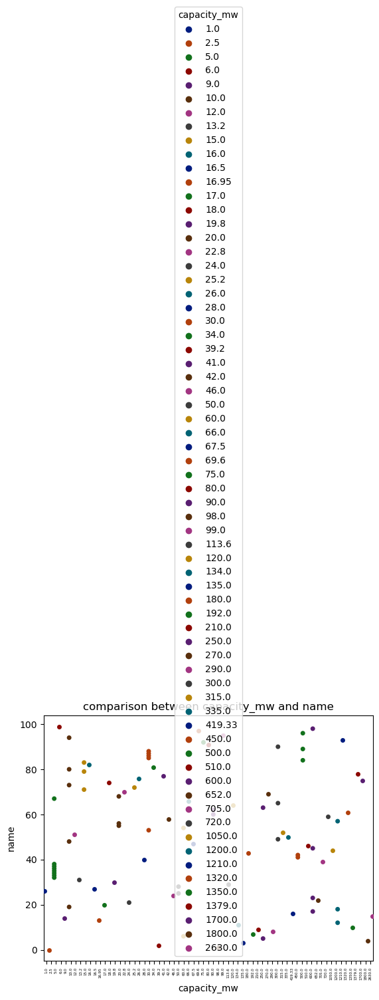

<Figure size 2800x200 with 0 Axes>

In [165]:
plt.title("comparison between capacity_mw and name")
sns.stripplot(x= "capacity_mw", y= "name", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plot.

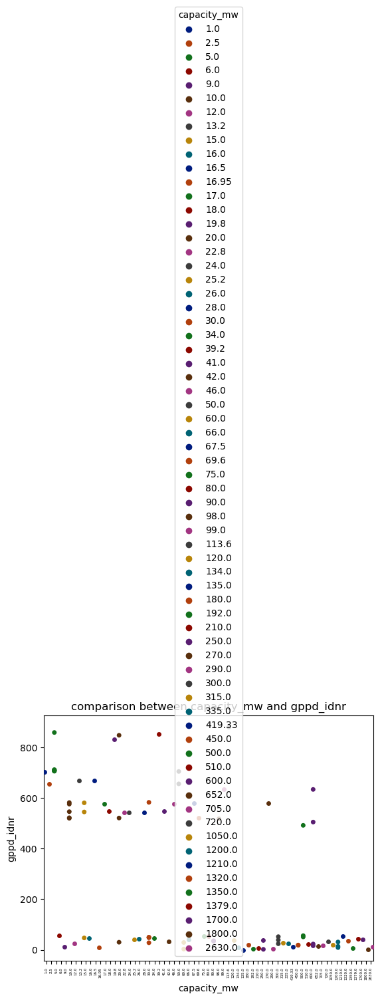

<Figure size 2800x200 with 0 Axes>

In [166]:
plt.title("comparison between capacity_mw and gppd_idnr")
sns.stripplot(x= "capacity_mw", y= "gppd_idnr", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the capacity-mw points are below level 50-100 of gppd_idnr.

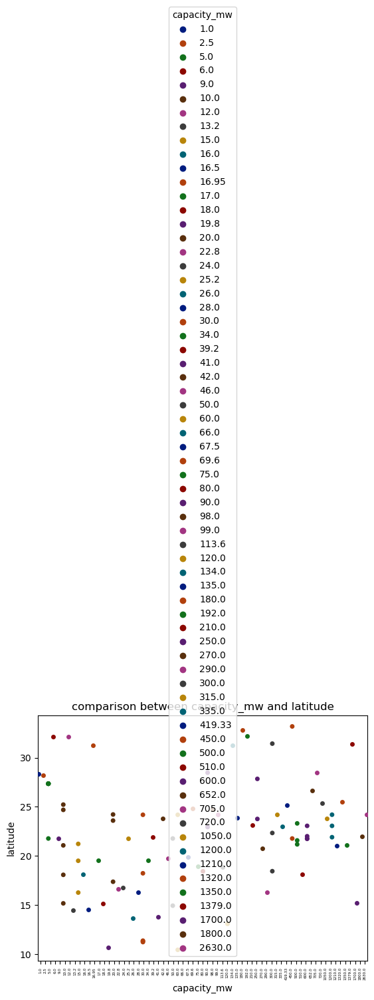

<Figure size 2800x200 with 0 Axes>

In [167]:
plt.title("comparison between capacity_mw and latitude")
sns.stripplot(x= "capacity_mw", y= "latitude", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plot.

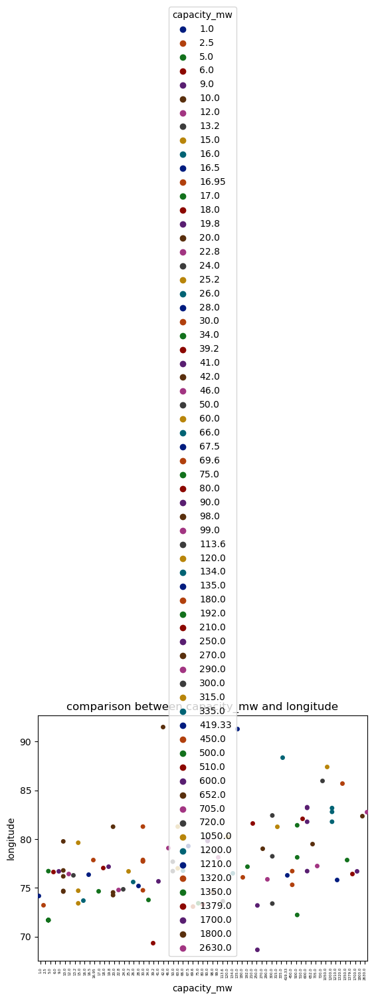

<Figure size 2800x200 with 0 Axes>

In [168]:
plt.title("comparison between capacity_mw and longitude")
sns.stripplot(x= "capacity_mw", y= "longitude", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plot.

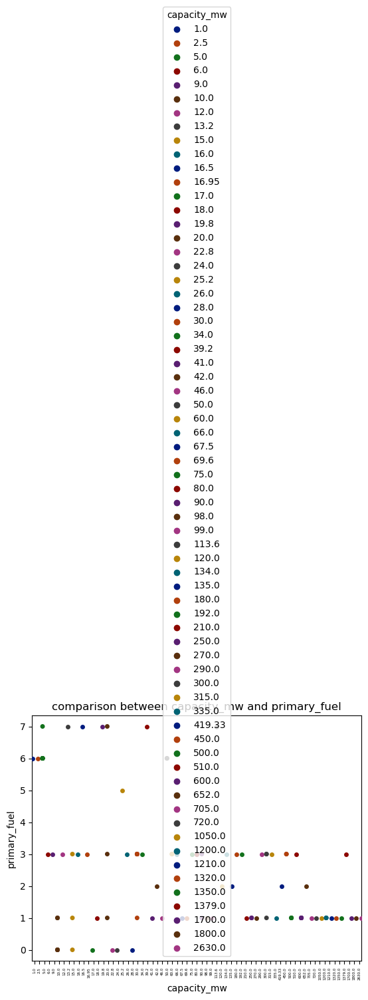

<Figure size 2800x200 with 0 Axes>

In [169]:
plt.title("comparison between capacity_mw and primary_fuel")
sns.stripplot(x= "capacity_mw", y= "primary_fuel", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plot.

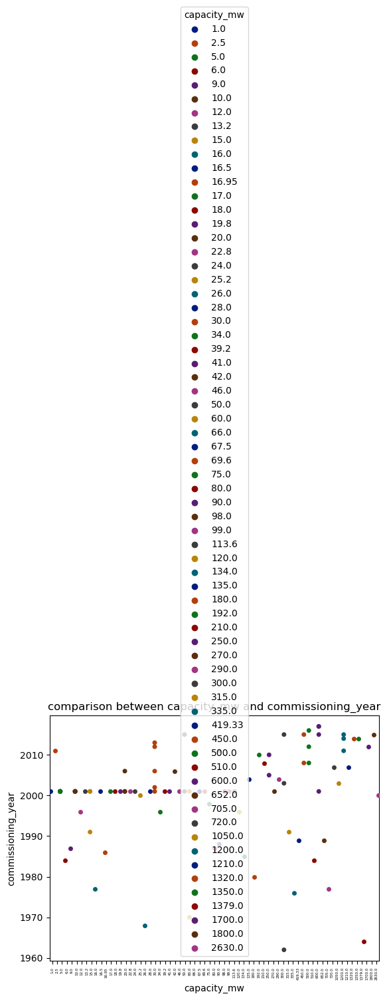

<Figure size 2800x200 with 0 Axes>

In [170]:
plt.title("comparison between capacity_mw and commissioning_year")
sns.stripplot(x= "capacity_mw", y= "commissioning_year", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plot.

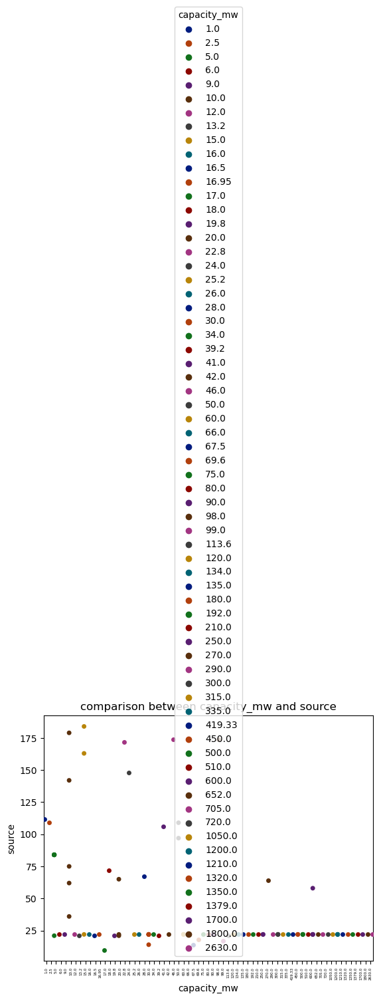

<Figure size 2800x200 with 0 Axes>

In [171]:
plt.title("comparison between capacity_mw and source")
sns.stripplot(x= "capacity_mw", y= "source", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the capacity_mw values are below level 25 of source column. 

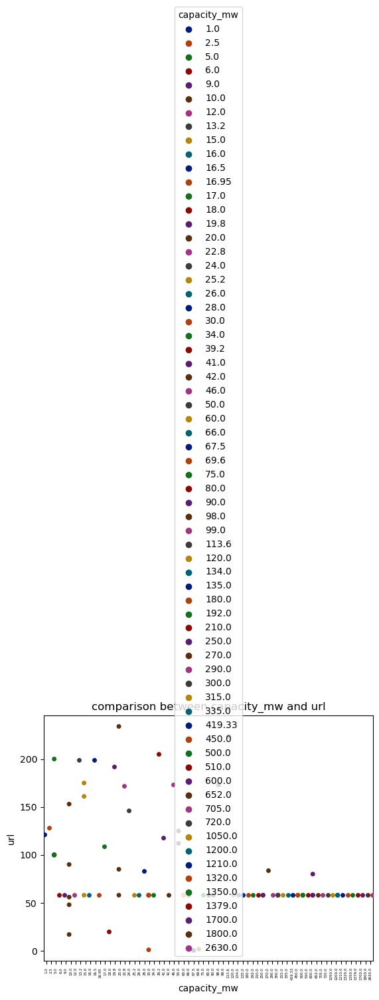

<Figure size 2800x200 with 0 Axes>

In [172]:
plt.title("comparison between capacity_mw and url")
sns.stripplot(x= "capacity_mw", y= "url", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the capacity_mw values are in 50-60 levels of url.

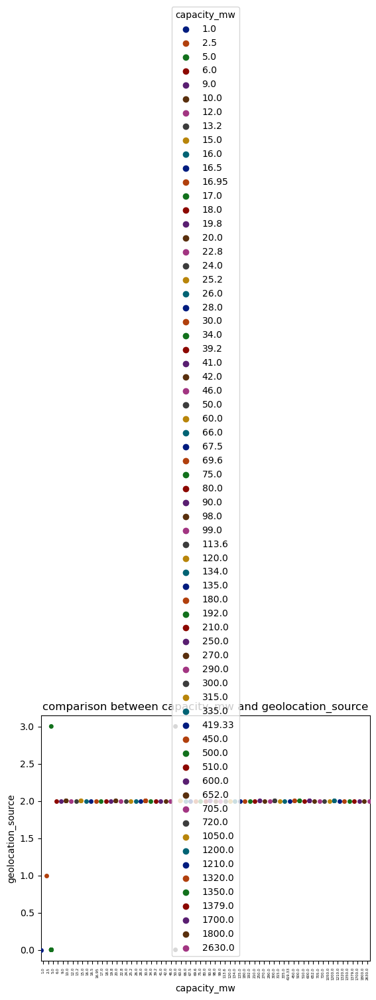

<Figure size 2800x200 with 0 Axes>

In [173]:
plt.title("comparison between capacity_mw and geolocation_source")
sns.stripplot(x= "capacity_mw", y= "geolocation_source", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

In [ ]:
most of the capacity_mw points are accumulated in geolocation_source level 2.0.

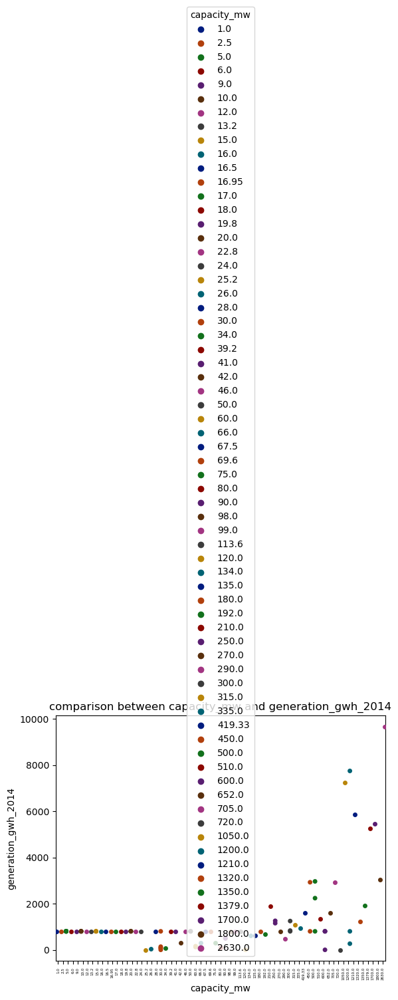

<Figure size 2800x200 with 0 Axes>

In [174]:
plt.title("comparison between capacity_mw and generation_gwh_2014")
sns.stripplot(x= "capacity_mw", y= "generation_gwh_2014", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the capacity_mw points are between the levels 0 and 2000 of generation_gwh_2014 levels.

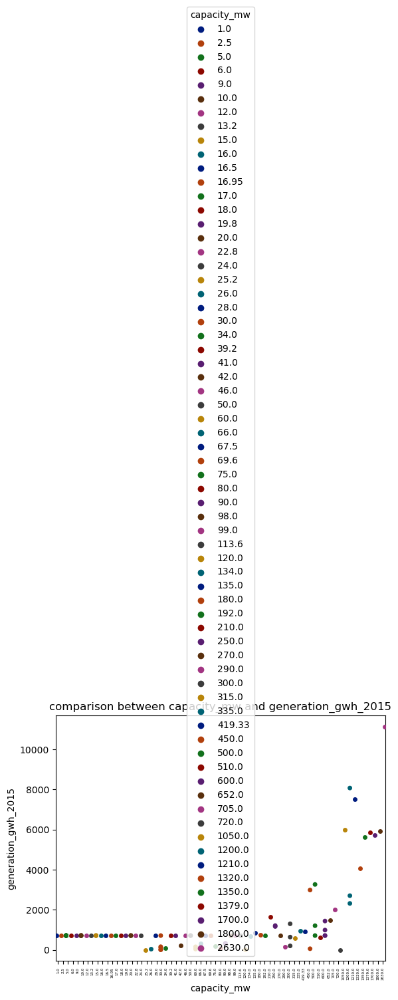

<Figure size 2800x200 with 0 Axes>

In [175]:
plt.title("comparison between capacity_mw and generation_gwh_2015")
sns.stripplot(x= "capacity_mw", y= "generation_gwh_2015", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the capacity_mw points are between the levels 0 and 2000 of generation_gwh_2015 levels.

C:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


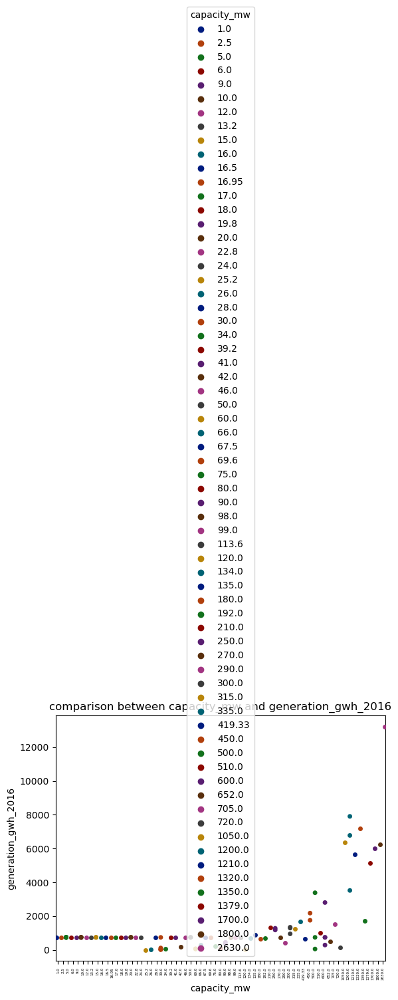

<Figure size 2800x200 with 0 Axes>

In [176]:
plt.title("comparison between capacity_mw and generation_gwh_2016")
sns.stripplot(x= "capacity_mw", y= "generation_gwh_2016", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the capacity_mw points are between the levels 0 and 2000 of generation_gwh_2016 levels.

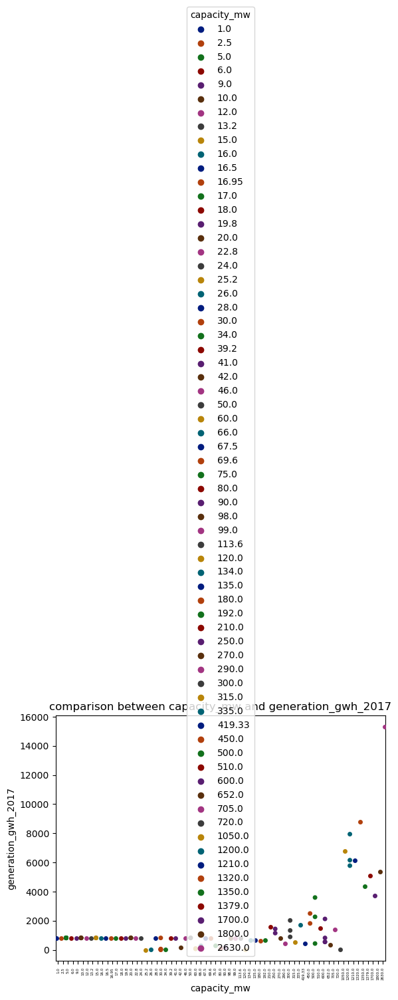

<Figure size 2800x200 with 0 Axes>

In [177]:
plt.title("comparison between capacity_mw and generation_gwh_2017")
sns.stripplot(x= "capacity_mw", y= "generation_gwh_2017", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the capacity_mw points are between the levels 0 and 2000 of generation_gwh_2017 levels.

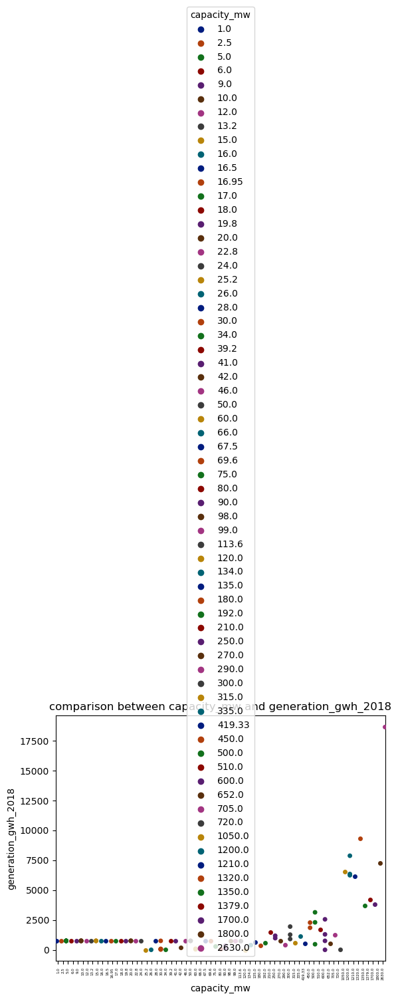

<Figure size 2800x200 with 0 Axes>

In [178]:
plt.title("comparison between capacity_mw and generation_gwh_2018")
sns.stripplot(x= "capacity_mw", y= "generation_gwh_2018", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

most of the capacity_mw points are between the levels 0 and 2500 of generation_gwh_2017 levels.

Scatterplots

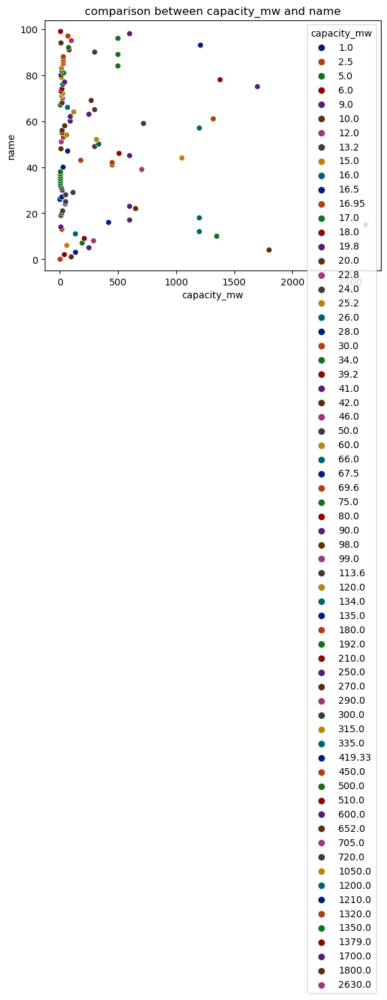

In [179]:
plt.title("comparison between capacity_mw and name")
sns.scatterplot(x= 'capacity_mw', y= 'name', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

most of the capacity_mw points between 0-75 are accumulated in label encoded name levels ranging from 0 to 100.

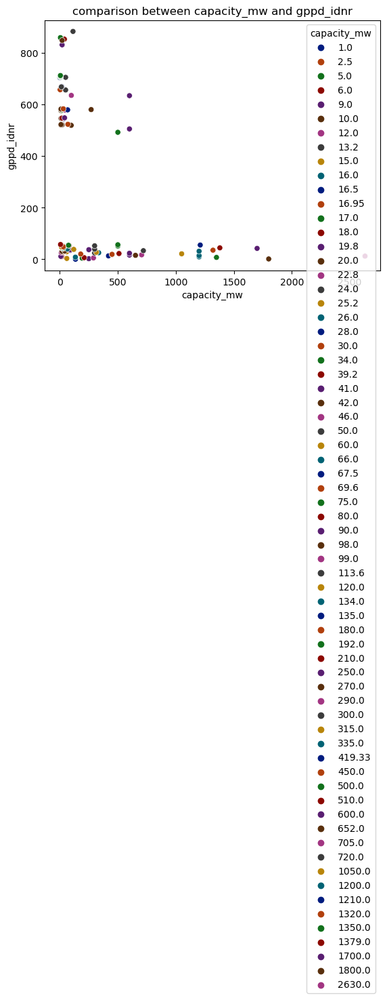

In [180]:
plt.title("comparison between capacity_mw and gppd_idnr")
sns.scatterplot(x= 'capacity_mw', y= 'gppd_idnr', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

no conclsuive statements can be made from the above plot.

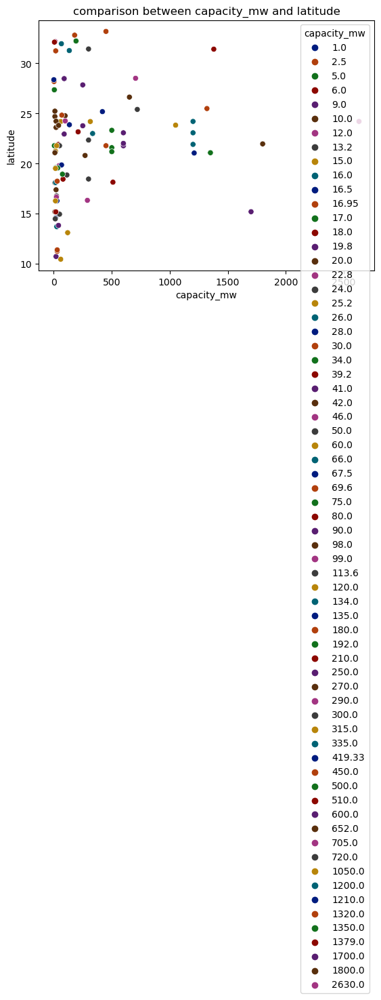

In [181]:
plt.title("comparison between capacity_mw and latitude")
sns.scatterplot(x= 'capacity_mw', y= 'latitude', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

most of the capacity_mw points from 0-500 are accumulated from 0 to 40 levels of latitude.

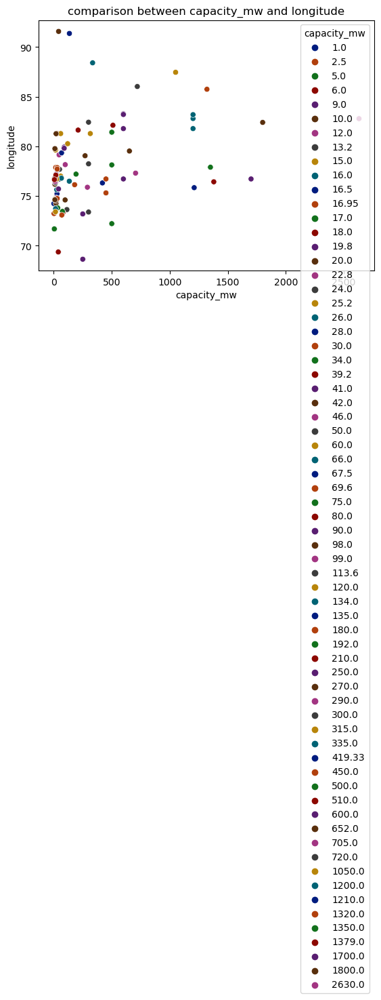

In [182]:
plt.title("comparison between capacity_mw and longitude")
sns.scatterplot(x= 'capacity_mw', y= 'longitude', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

most of the capacity_mw points from 0-500 are accumulated from 72 to 82 levels of longitude.

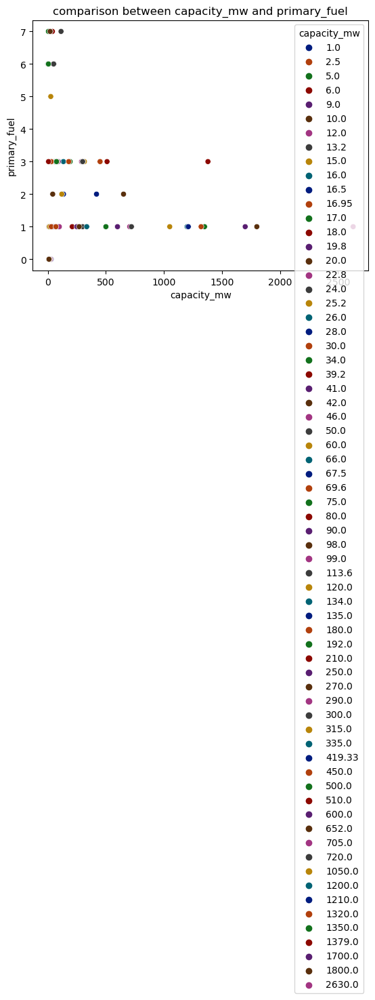

In [183]:
plt.title("comparison between capacity_mw and primary_fuel")
sns.scatterplot(x= 'capacity_mw', y= 'primary_fuel', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

no conclusive statements can be made from the above plot.

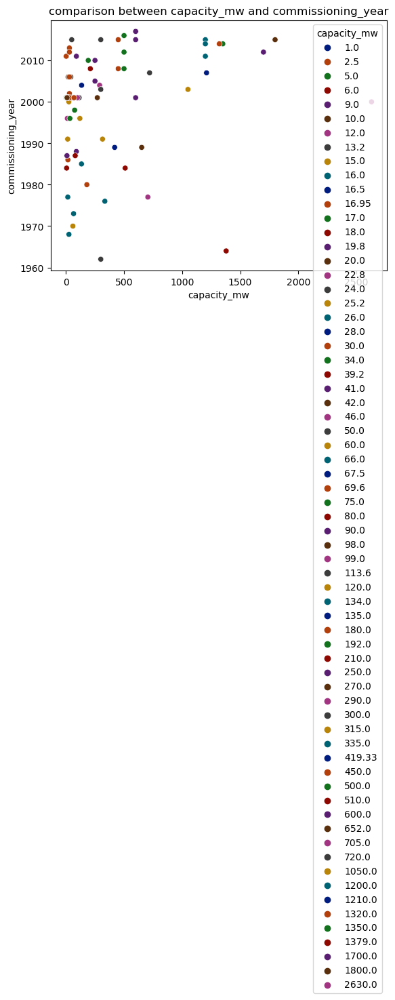

In [184]:
plt.title("comparison between capacity_mw and commissioning_year")
sns.scatterplot(x= 'capacity_mw', y= 'commissioning_year', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

In [ ]:
no conclusive statements can be made from the above plot.

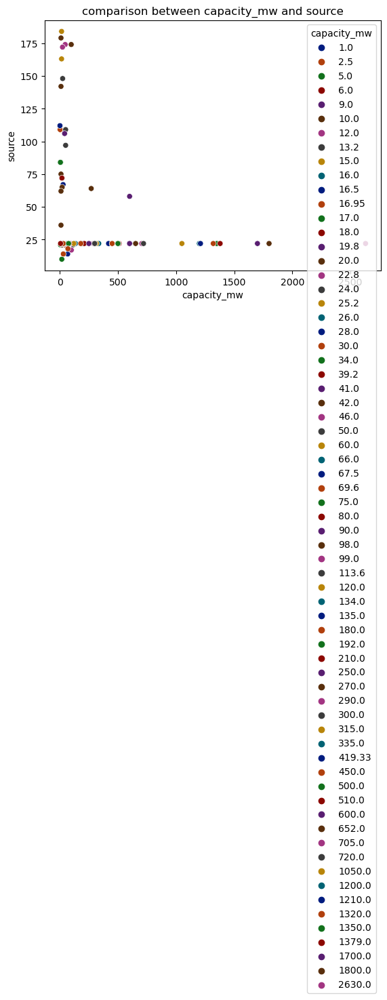

In [185]:
plt.title("comparison between capacity_mw and source")
sns.scatterplot(x= 'capacity_mw', y= 'source', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

In [ ]:
no conclusive statements can be made from the above plot.

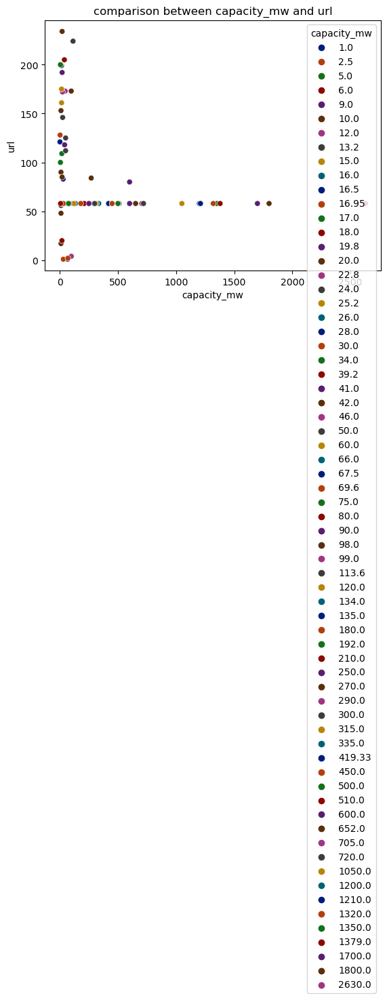

In [186]:
plt.title("comparison between capacity_mw and url")
sns.scatterplot(x= 'capacity_mw', y= 'url', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

no conclusive statements can be made from the above plot.

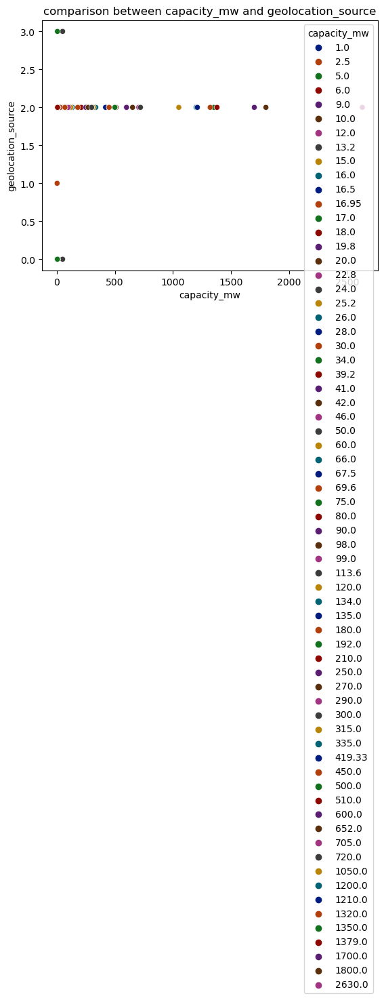

In [187]:
plt.title("comparison between capacity_mw and geolocation_source")
sns.scatterplot(x= 'capacity_mw', y= 'geolocation_source', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

most of the capacity_mw points are accumulated at geolocation_source level 2.0.

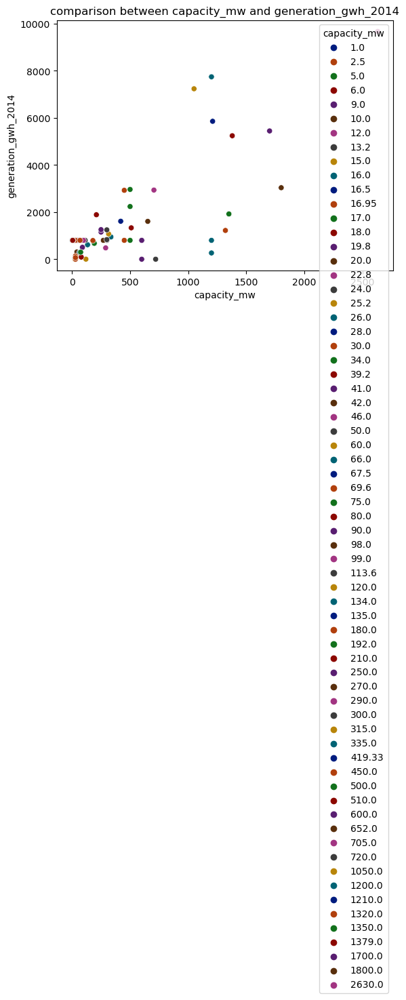

In [188]:
plt.title("comparison between capacity_mw and generation_gwh_2014")
sns.scatterplot(x= 'capacity_mw', y= 'generation_gwh_2014', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

no conclusive statements can be made from the above plot, other than most of capacity_mw points from 0-500 are accumulated at 0-2000 levels.

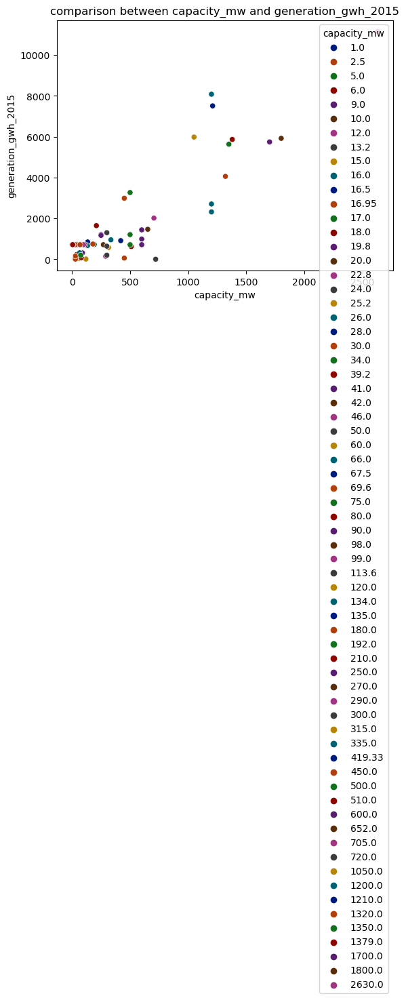

In [189]:
plt.title("comparison between capacity_mw and generation_gwh_2015")
sns.scatterplot(x= 'capacity_mw', y= 'generation_gwh_2015', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

no conclusive statements can be made from the above plot, other than most of capacity_mw points from 0-500 are accumulated at 0-2000 levels.

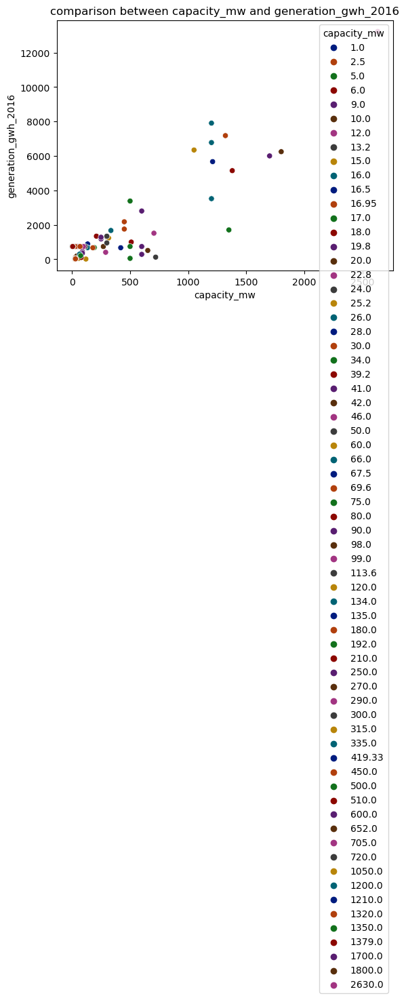

In [190]:
plt.title("comparison between capacity_mw and generation_gwh_2016")
sns.scatterplot(x= 'capacity_mw', y= 'generation_gwh_2016', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

no conclusive statements can be made from the above plot, other than most of capacity_mw points from 0-500 are accumulated at 0-2000 levels.

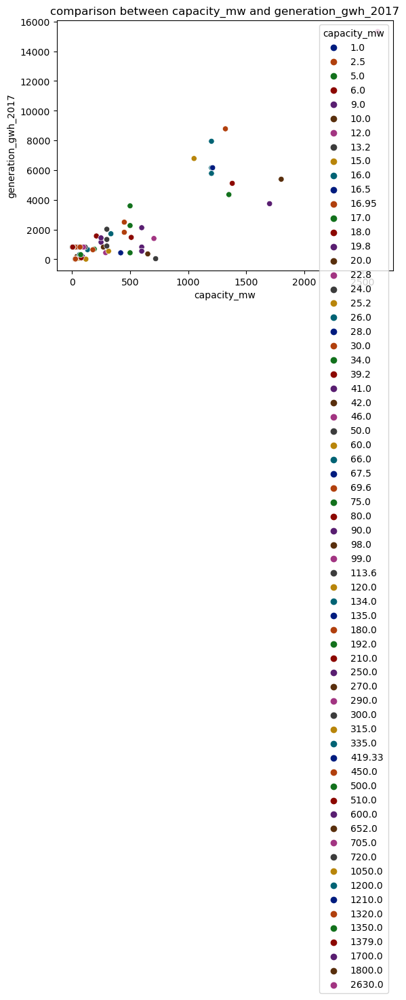

In [ ]:
plt.title("comparison between capacity_mw and generation_gwh_2017")
sns.scatterplot(x= 'capacity_mw', y= 'generation_gwh_2017', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

no conclusive statements can be made from the above plot, other than most of capacity_mw points from 0-500 are accumulated at 0-2000 levels.

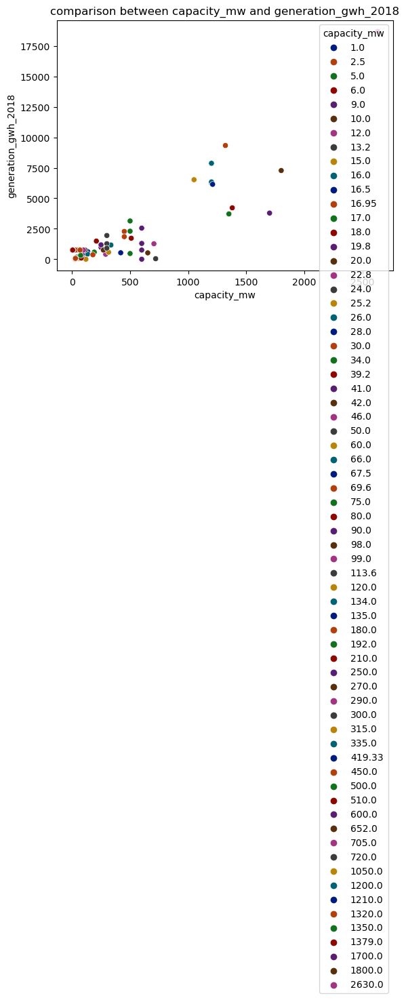

In [192]:
plt.title("comparison between capacity_mw and generation_gwh_2018")
sns.scatterplot(x= 'capacity_mw', y= 'generation_gwh_2018', data = global_power_data.head(100),hue='capacity_mw', palette='dark')
plt.show()

no conclusive statements can be made from the above plot, other than most of capacity_mw points from 0-500 are accumulated at 0-2500 levels.

barplots

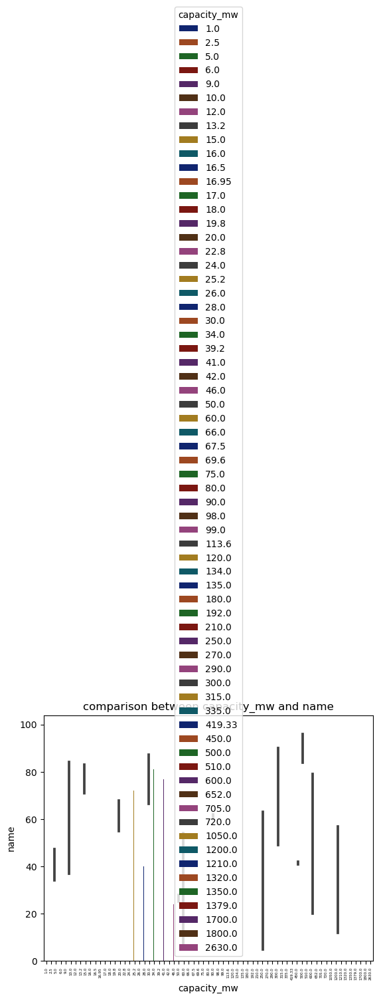

<Figure size 2800x200 with 0 Axes>

In [193]:
plt.title("comparison between capacity_mw and name")
sns.barplot(x= "capacity_mw", y= "name", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots.

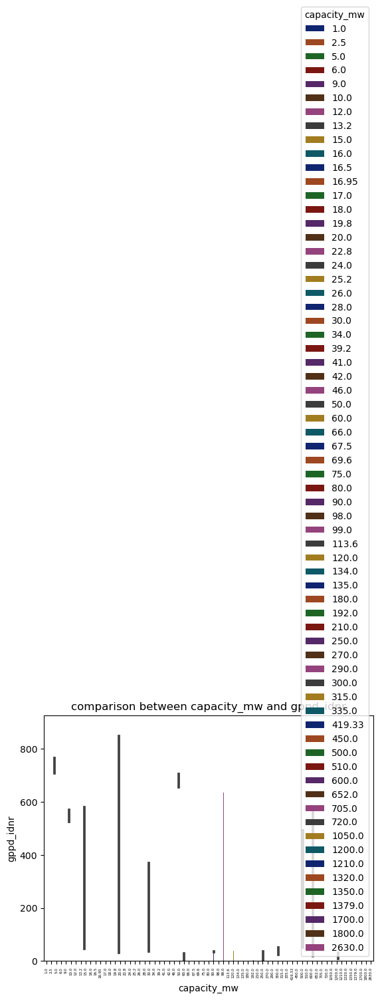

<Figure size 2800x200 with 0 Axes>

In [194]:
plt.title("comparison between capacity_mw and gppd_idnr")
sns.barplot(x= "capacity_mw", y= "gppd_idnr", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots.

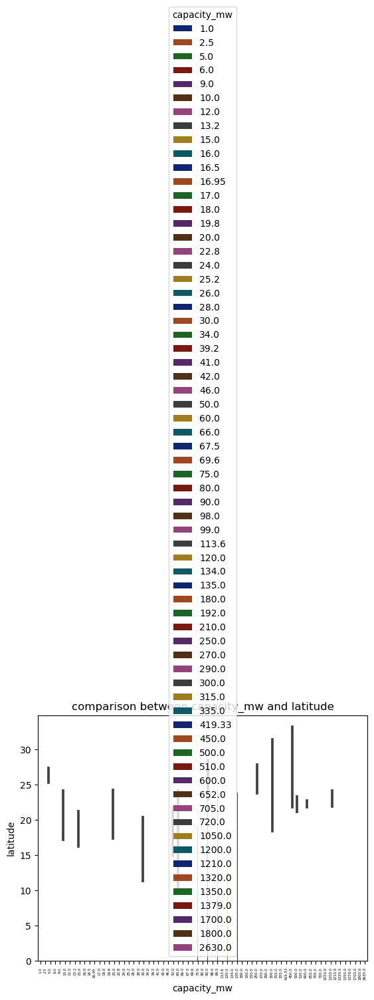

<Figure size 2800x200 with 0 Axes>

In [195]:
plt.title("comparison between capacity_mw and latitude")
sns.barplot(x= "capacity_mw", y= "latitude", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots.

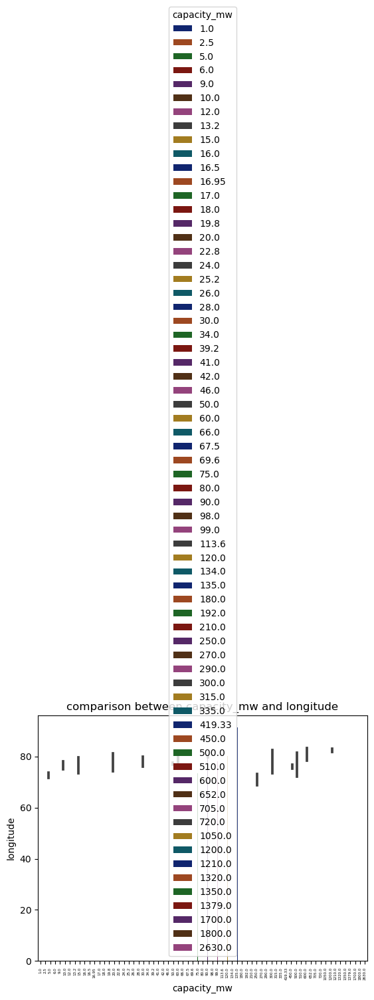

<Figure size 2800x200 with 0 Axes>

In [196]:
plt.title("comparison between capacity_mw and longitude")
sns.barplot(x= "capacity_mw", y= "longitude", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots.

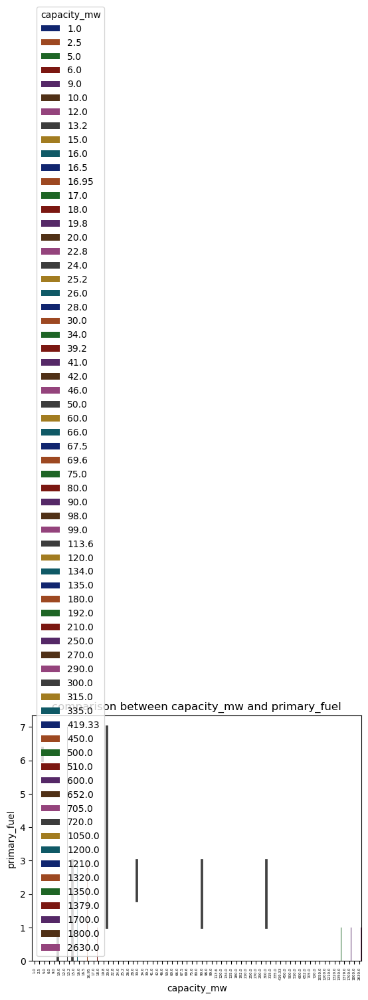

<Figure size 2800x200 with 0 Axes>

In [197]:
plt.title("comparison between capacity_mw and primary_fuel")
sns.barplot(x= "capacity_mw", y= "primary_fuel", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plot other than capacity_mw 20 having very high number values in primary fuel column.

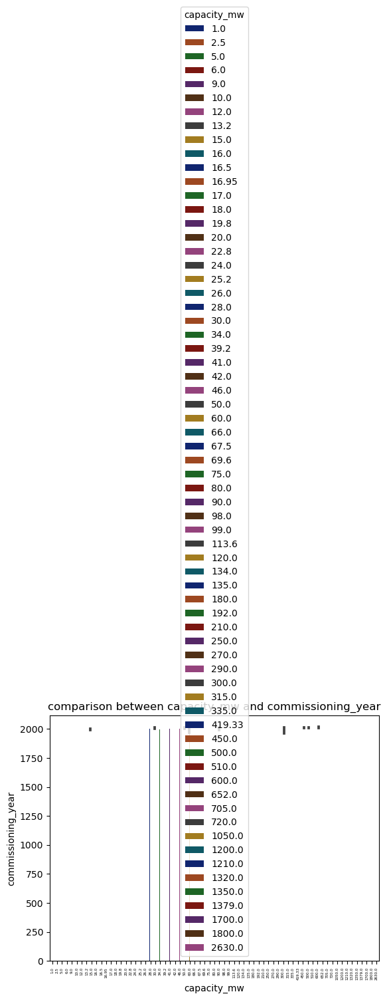

<Figure size 2800x200 with 0 Axes>

In [198]:
plt.title("comparison between capacity_mw and commissioning_year")
sns.barplot(x= "capacity_mw", y= "commissioning_year", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots.

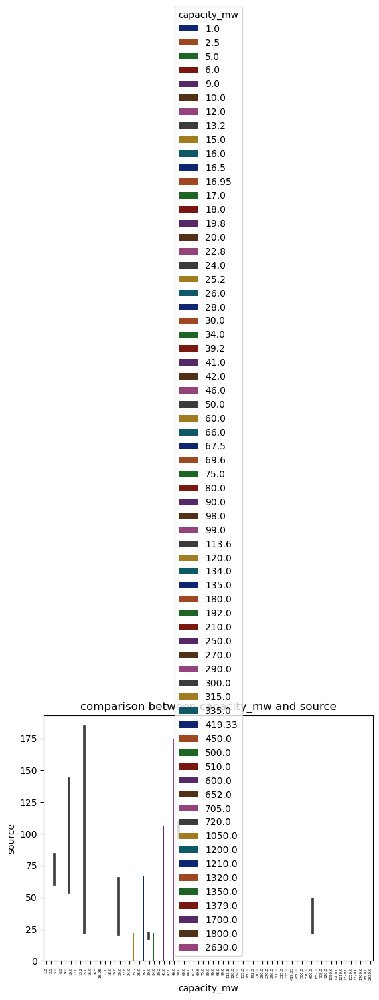

<Figure size 2800x200 with 0 Axes>

In [199]:
plt.title("comparison between capacity_mw and source")
sns.barplot(x= "capacity_mw", y= "source", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots, other than capacity_mw in lower levels have high number of values in source column.

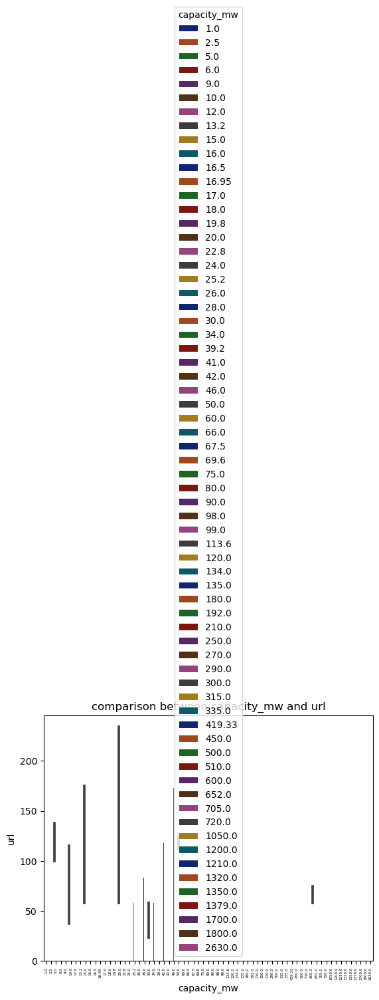

<Figure size 2800x200 with 0 Axes>

In [200]:
plt.title("comparison between capacity_mw and url")
sns.barplot(x= "capacity_mw", y= "url", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots,other than capacity_mw in lower levels have high number of values in url column.

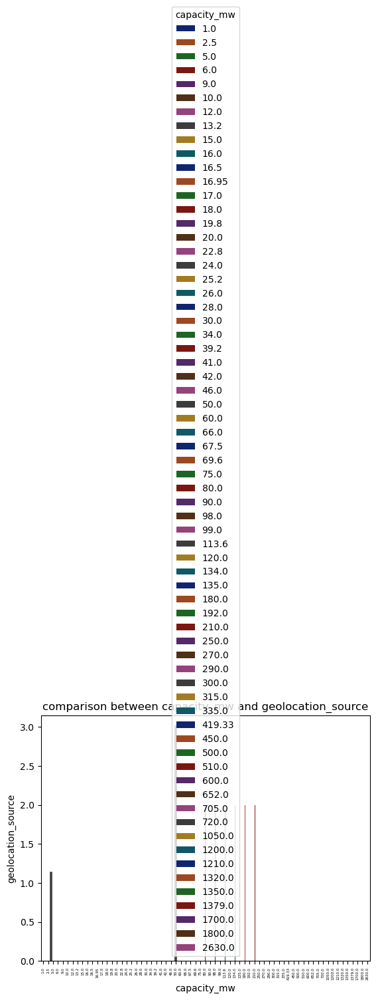

<Figure size 2800x200 with 0 Axes>

In [201]:
plt.title("comparison between capacity_mw and geolocation_source")
sns.barplot(x= "capacity_mw", y= "geolocation_source", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots.

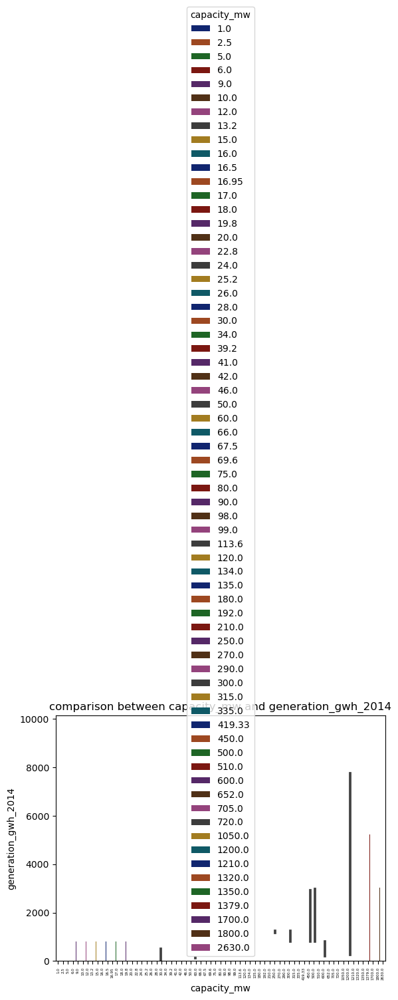

<Figure size 2800x200 with 0 Axes>

In [202]:
plt.title("comparison between capacity_mw and generation_gwh_2014")
sns.barplot(x= "capacity_mw", y= "generation_gwh_2014", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots,other than capacity_mw in higher levels have high number of values in generation_gwh_2014 column.

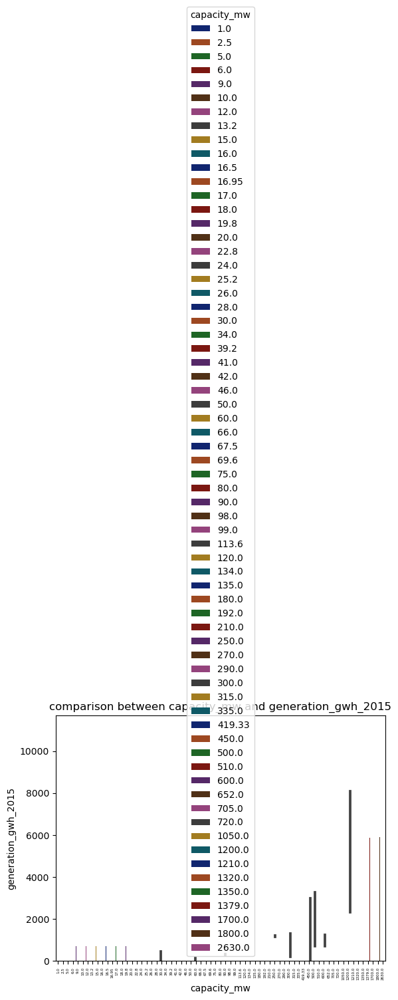

<Figure size 2800x200 with 0 Axes>

In [203]:
plt.title("comparison between capacity_mw and generation_gwh_2015")
sns.barplot(x= "capacity_mw", y= "generation_gwh_2015", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots,other than capacity_mw in higher levels have high number of values in generation_gwh_2015 column.

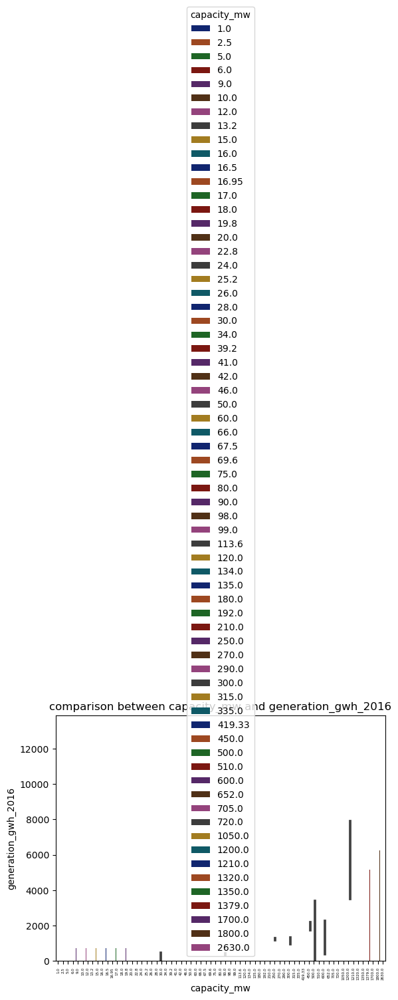

<Figure size 2800x200 with 0 Axes>

In [204]:
plt.title("comparison between capacity_mw and generation_gwh_2016")
sns.barplot(x= "capacity_mw", y= "generation_gwh_2016", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots,other than capacity_mw in higher levels have high number of values in generation_gwh_2016 column.

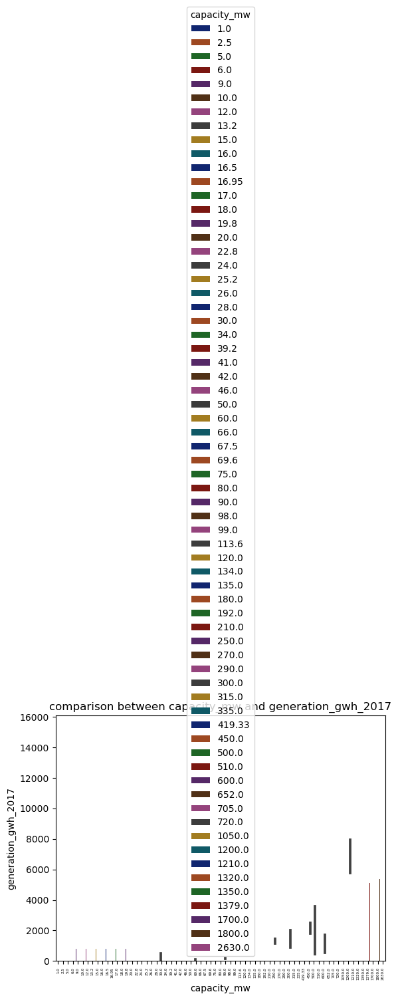

<Figure size 2800x200 with 0 Axes>

In [205]:
plt.title("comparison between capacity_mw and generation_gwh_2017")
sns.barplot(x= "capacity_mw", y= "generation_gwh_2017", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots,other than capacity_mw in higher levels have high number of values in generation_gwh_2017 column.

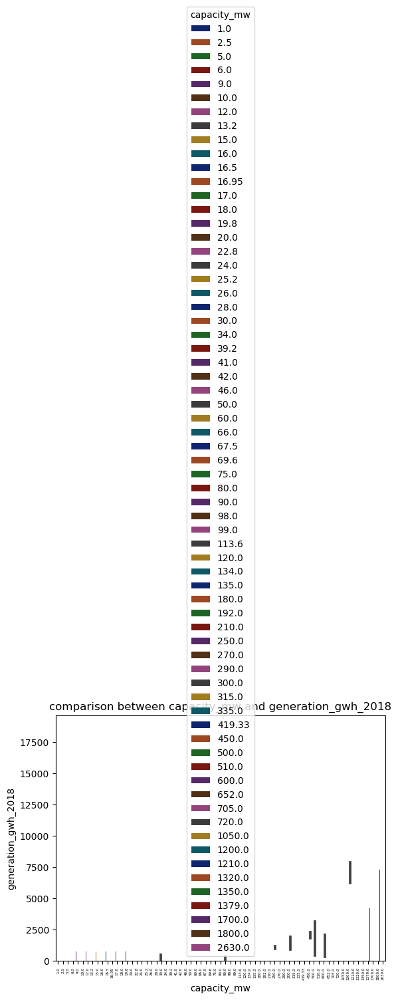

<Figure size 2800x200 with 0 Axes>

In [206]:
plt.title("comparison between capacity_mw and generation_gwh_2018")
sns.barplot(x= "capacity_mw", y= "generation_gwh_2018", data = global_power_data.head(100),hue='capacity_mw', palette='dark',dodge=True)
plt.xticks(rotation=90, fontsize=4)
plt.figure(figsize=(28, 2))
plt.show()

no conclusive statements can be made from the above plots,other than capacity_mw in higher levels have high number of values in generation_gwh_2018 column.

Catplots

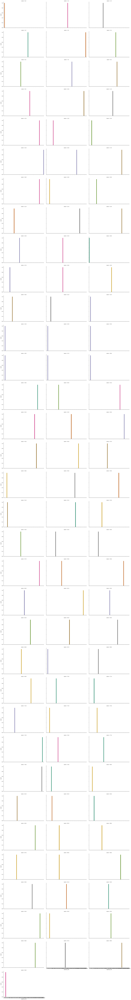

In [207]:
sns.catplot(x= 'capacity_mw', col= 'name', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

no conclusive statements can be made from above plots.

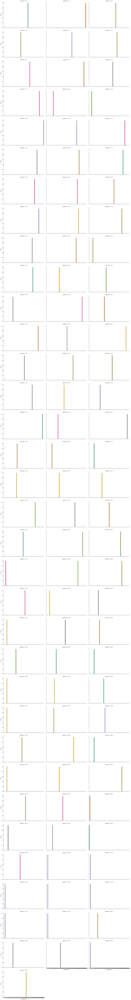

In [208]:
sns.catplot(x= 'capacity_mw', col= 'gppd_idnr', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

no conclusive statements can be made from above plots.

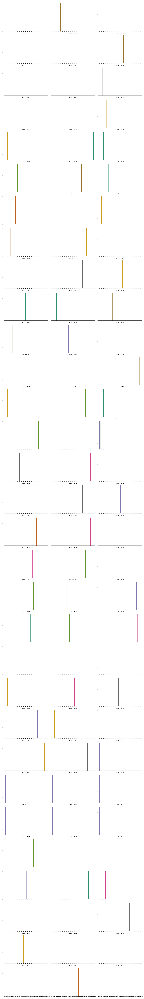

In [209]:
sns.catplot(x= 'capacity_mw', col= 'latitude', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

no conclusive statements can be made from above plots, other than most of points accumulated in latitude 21.78.

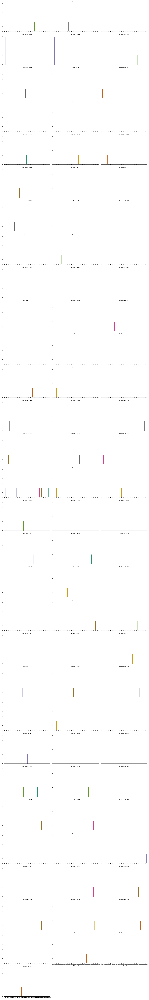

In [210]:
sns.catplot(x= 'capacity_mw', col= 'longitude', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the capacity_mw points are accumulated in longitude 76.7195.

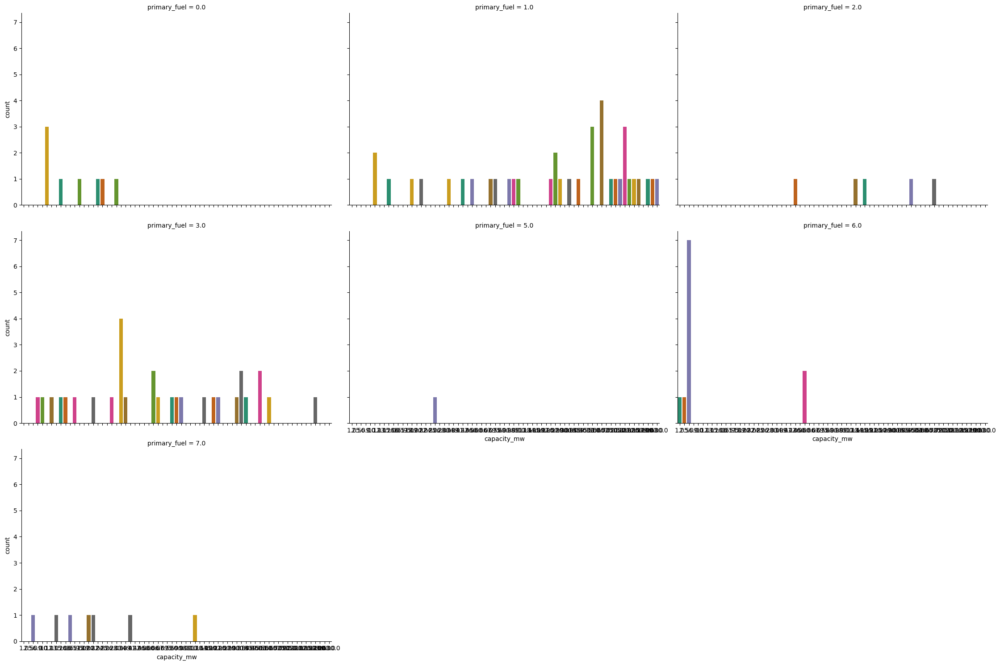

In [211]:
sns.catplot(x= 'capacity_mw', col= 'primary_fuel', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the capacity_mw points are accumulated in primary fuel 1 and 3.

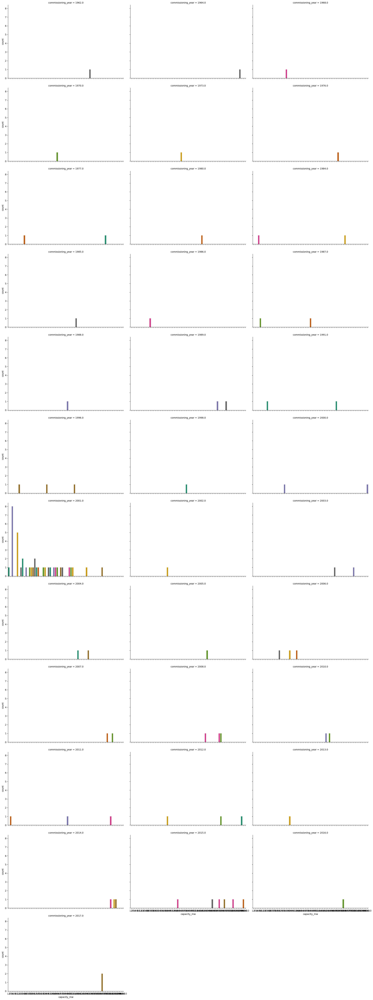

In [212]:
sns.catplot(x= 'capacity_mw', col= 'commissioning_year', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the points are accumulated in comissioning year 2001.

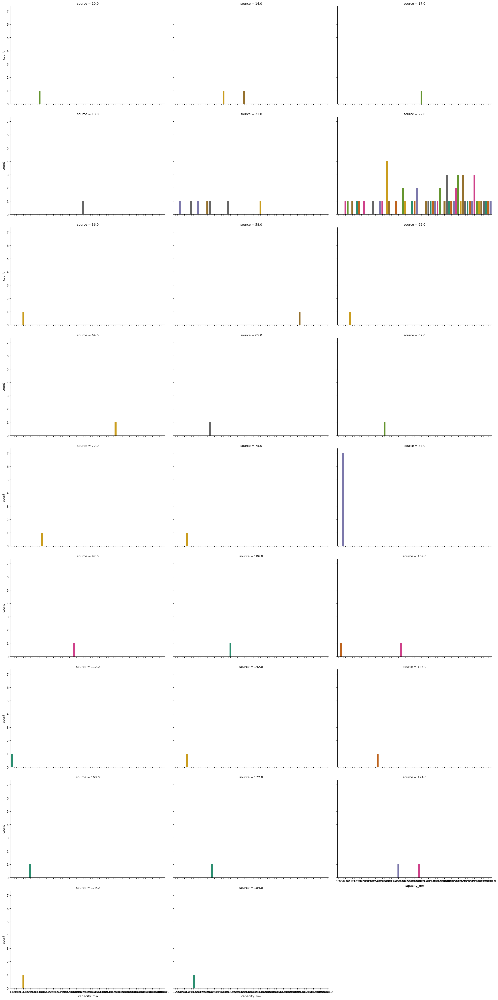

In [213]:
sns.catplot(x= 'capacity_mw', col= 'source', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the points are accumulated in source 22.0.

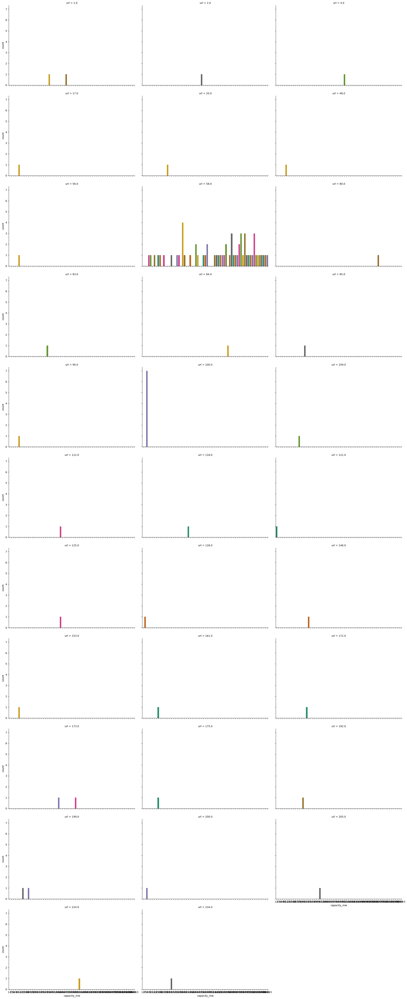

In [214]:
sns.catplot(x= 'capacity_mw', col= 'url', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the points are accumulated in url 58.0.

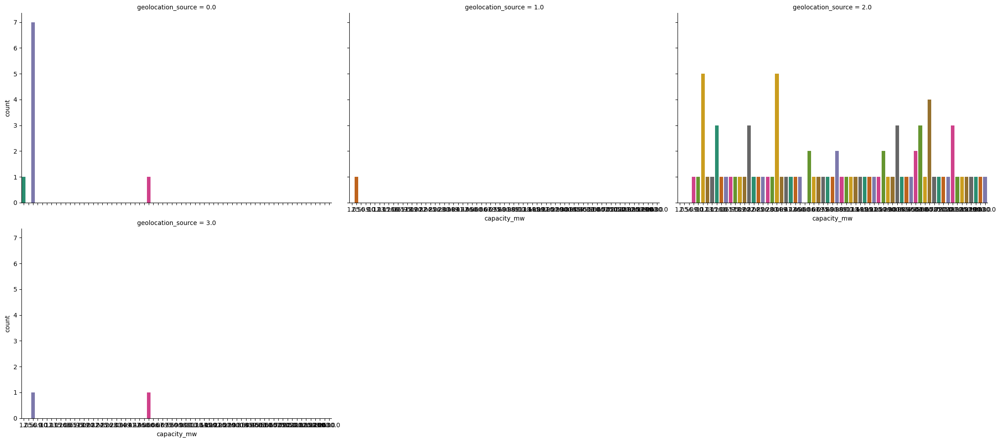

In [215]:
sns.catplot(x= 'capacity_mw', col= 'geolocation_source', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the points are accumulated in geolocation_source 2.0.

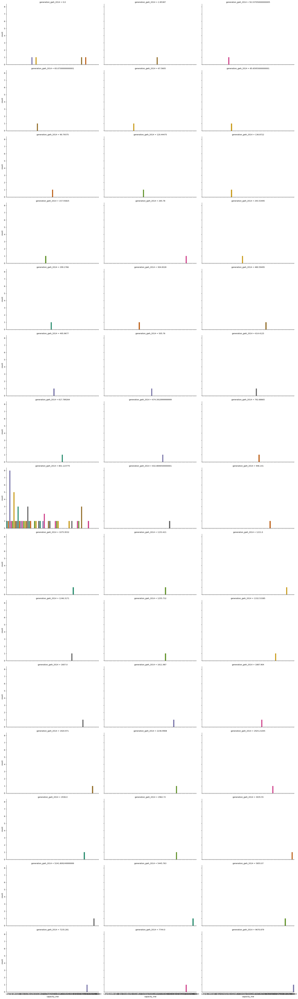

In [216]:
sns.catplot(x= 'capacity_mw', col= 'generation_gwh_2014', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the points are accumulated in 801.123.

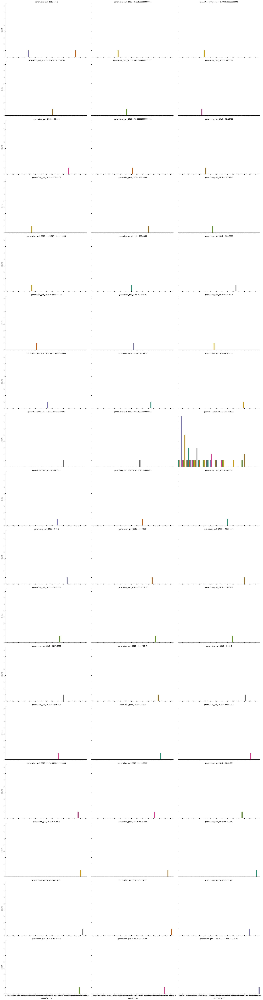

In [217]:
sns.catplot(x= 'capacity_mw', col= 'generation_gwh_2015', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the points are accumulated in 711.181.

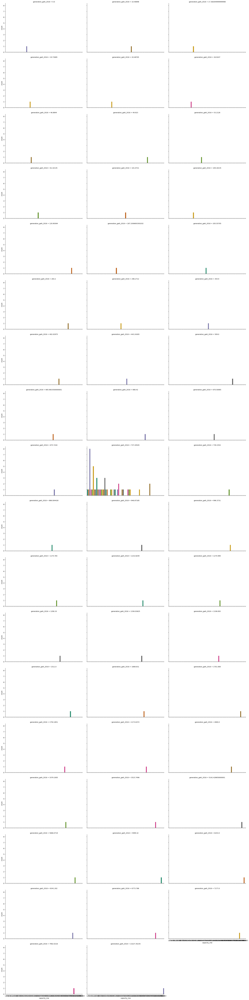

In [218]:
sns.catplot(x= 'capacity_mw', col= 'generation_gwh_2016', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the points are accumulated in 737.325.

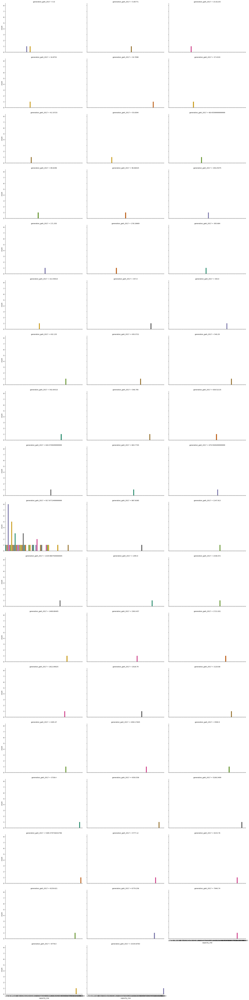

In [219]:
sns.catplot(x= 'capacity_mw', col= 'generation_gwh_2017', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the points are accumulated in 817.977.

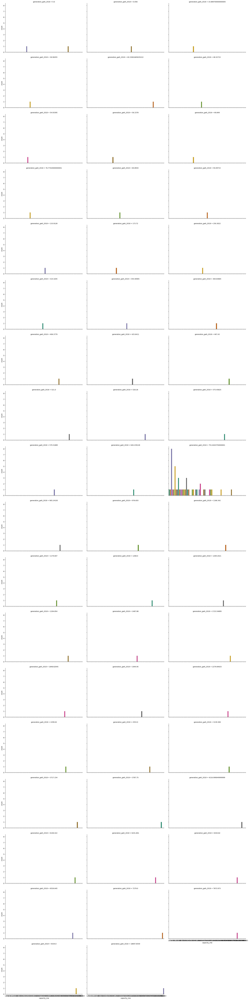

In [220]:
sns.catplot(x= 'capacity_mw', col= 'generation_gwh_2018', data = global_power_data.head(100), kind="count", palette='Dark2',height=5, aspect=1.5, col_wrap=3)

most of the points are accumulated in 751.644.

Linear regression plots

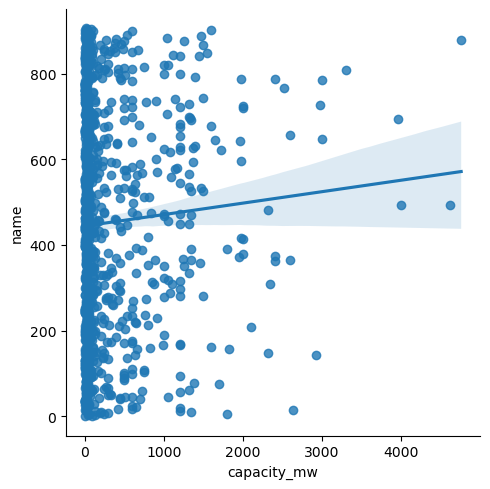

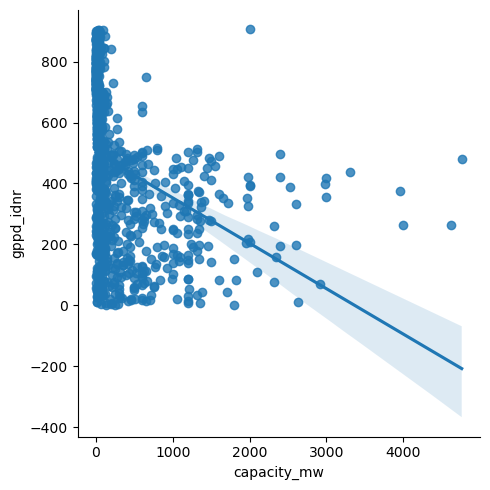

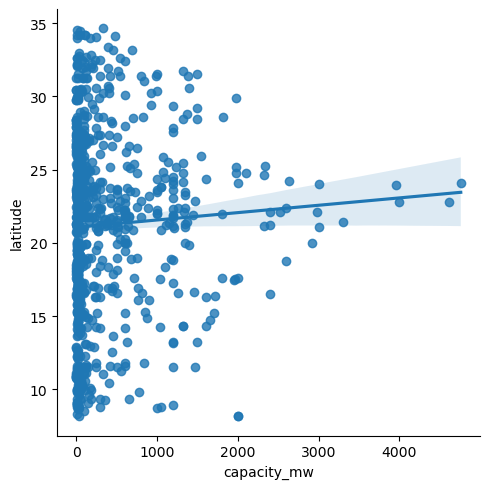

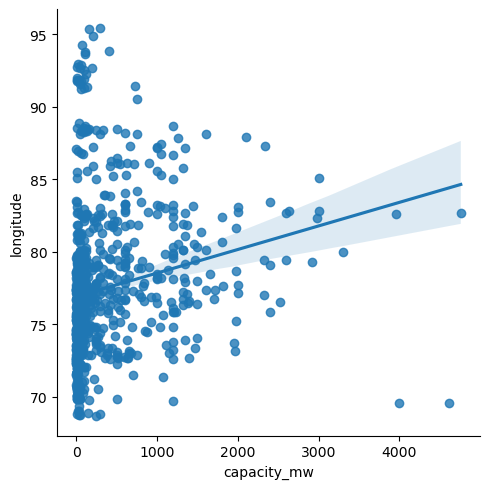

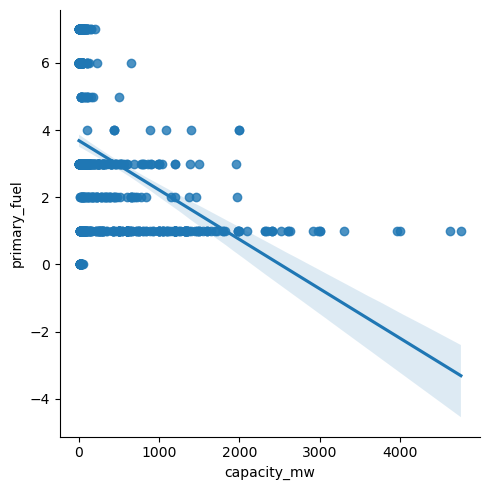

...

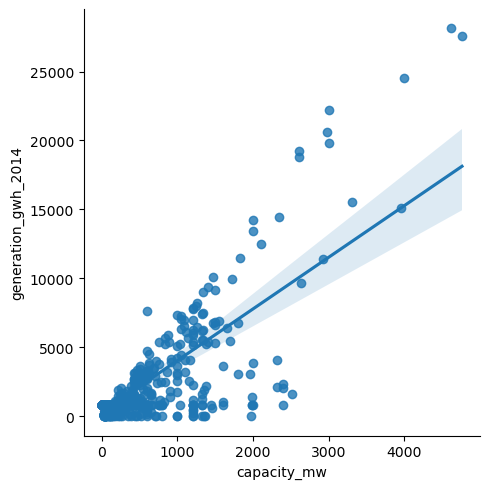

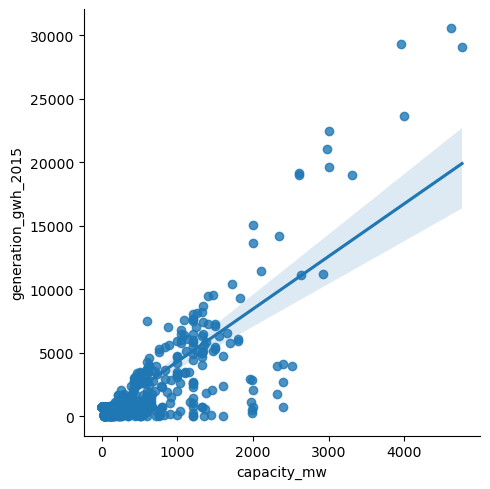

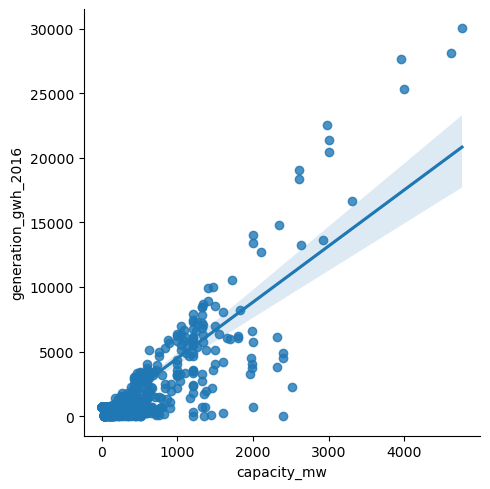

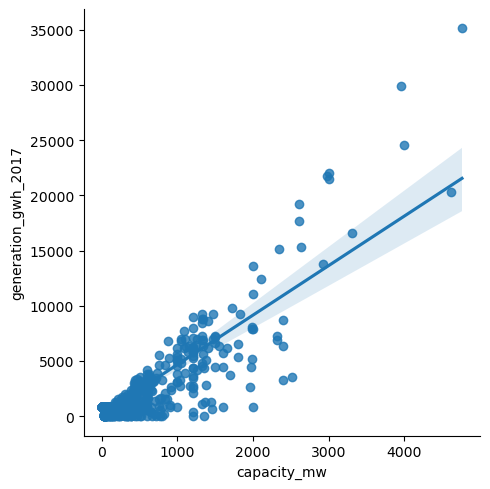

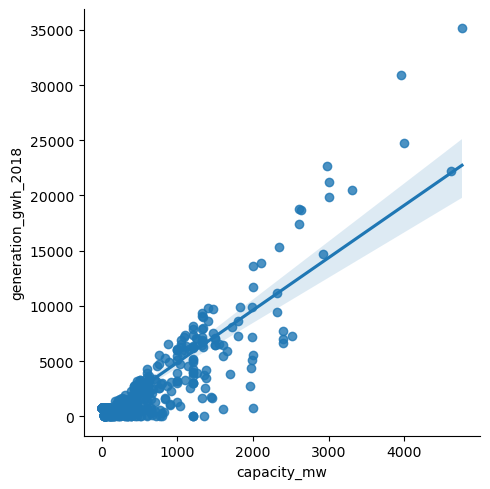

In [221]:
sns.lmplot(x='capacity_mw', y= 'name', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'gppd_idnr', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'latitude', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'longitude', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'primary_fuel', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'commissioning_year', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'source', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'url', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'geolocation_source', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'generation_gwh_2014', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'generation_gwh_2015', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'generation_gwh_2016', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'generation_gwh_2017', data=global_power_data,palette='colorblind')
sns.lmplot(x='capacity_mw', y= 'generation_gwh_2018', data=global_power_data,palette='colorblind')

below are the findings from the above plots-

1) gppd_inr, source and url are negatively correlated to the capacity_mw column.
2) generation_gwh_2014,generation_gwh_2015, generation_gwh_2016, generation_gwh_2017, and generation_gwh_2018 are positively correlated to capacity_mw.
3) other columns have weak correlation with capacity_mw.

Multivariate analysis.

Pairplots

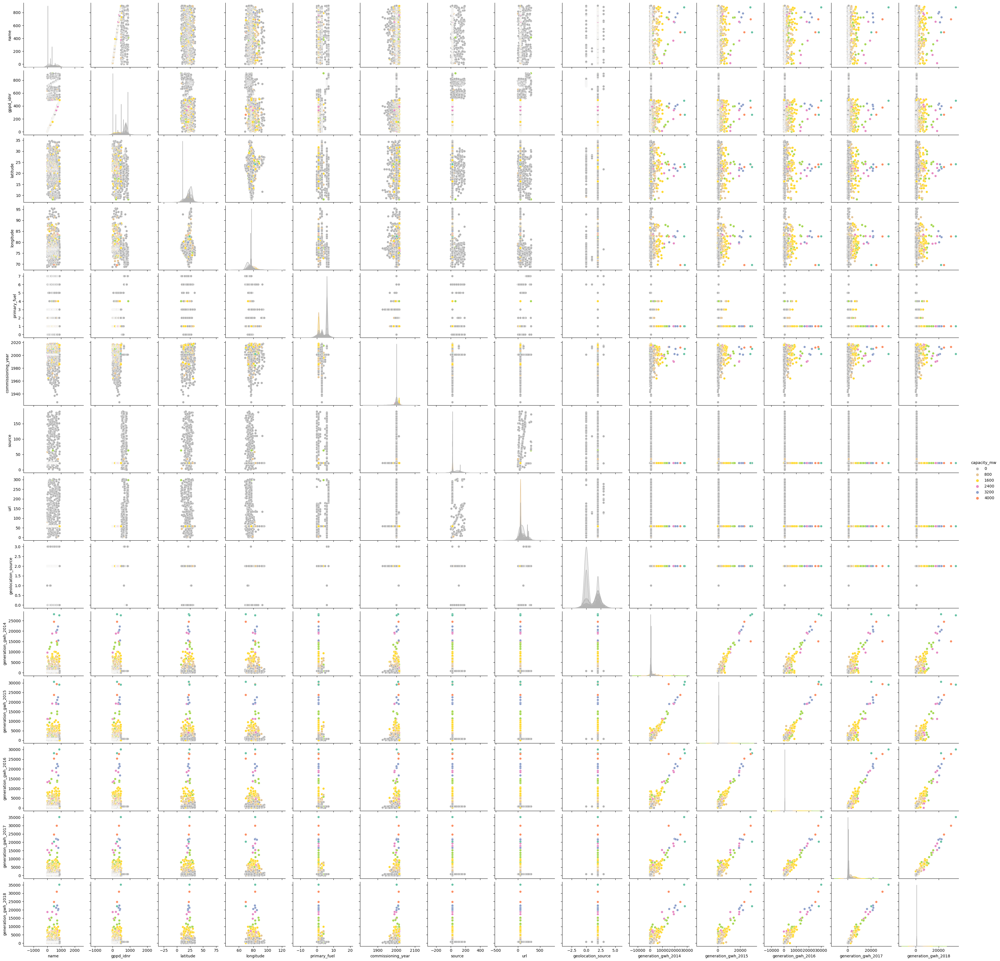

In [222]:
sns.pairplot(global_power_data,hue='capacity_mw',palette="Set2_r")
plt.show()

Below are the finding from the above plots
1) generation_gwh_2014,generation_gwh_2015, generation_gwh_2016, generation_gwh_2017, and generation_gwh_2018 are positively correlated to each other, and weak correlations to rest of the columns.
2) rest of the columns have weak or no correlations with each other.

In [ ]:
Distribution plot for output column.

C:\Users\ACHU NARAYAN\AppData\Local\Temp\ipykernel_15300\2598964031.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(global_power_data['capacity_mw'],color="b", kde_kws={"shade":True}, hist=False)
C:\ProgramData\anaconda3\Lib\site-packages\seaborn\distributions.py:2511: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  kdeplot(**{axis: a}, ax=ax, color=kde_color, **kde_kws)


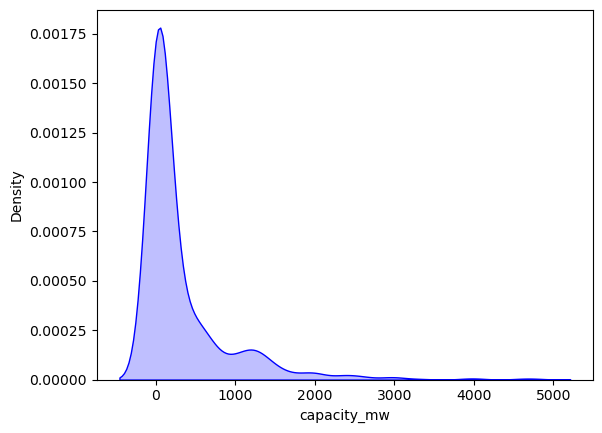

In [223]:
sns.distplot(global_power_data['capacity_mw'],color="b", kde_kws={"shade":True}, hist=False)
plt.show()

the density plot is highly skewed rising up to 0.00175 to the left ranging from capacity_mw 0 to 1000.

Skewness of model was corrected in the task-1 of the project and was repeated here in this step.

Correlations

We will be sorting correlations based on our target column, as the rest of the correlations are the same as the task-1 of the project.

In [230]:
correlation['capacity_mw'].sort_values(ascending = False)

capacity_mw            1.000000
generation_gwh_2018    0.622113
generation_gwh_2016    0.614859
generation_gwh_2017    0.606417
generation_gwh_2015    0.584654
generation_gwh_2014    0.544013
geolocation_source     0.326658
longitude              0.288113
commissioning_year     0.206347
latitude               0.068484
name                   0.032366
url                   -0.332217
source                -0.355100
primary_fuel          -0.500583
gppd_idnr             -0.508197
Name: capacity_mw, dtype: float64

lets visualise it using boxplots.

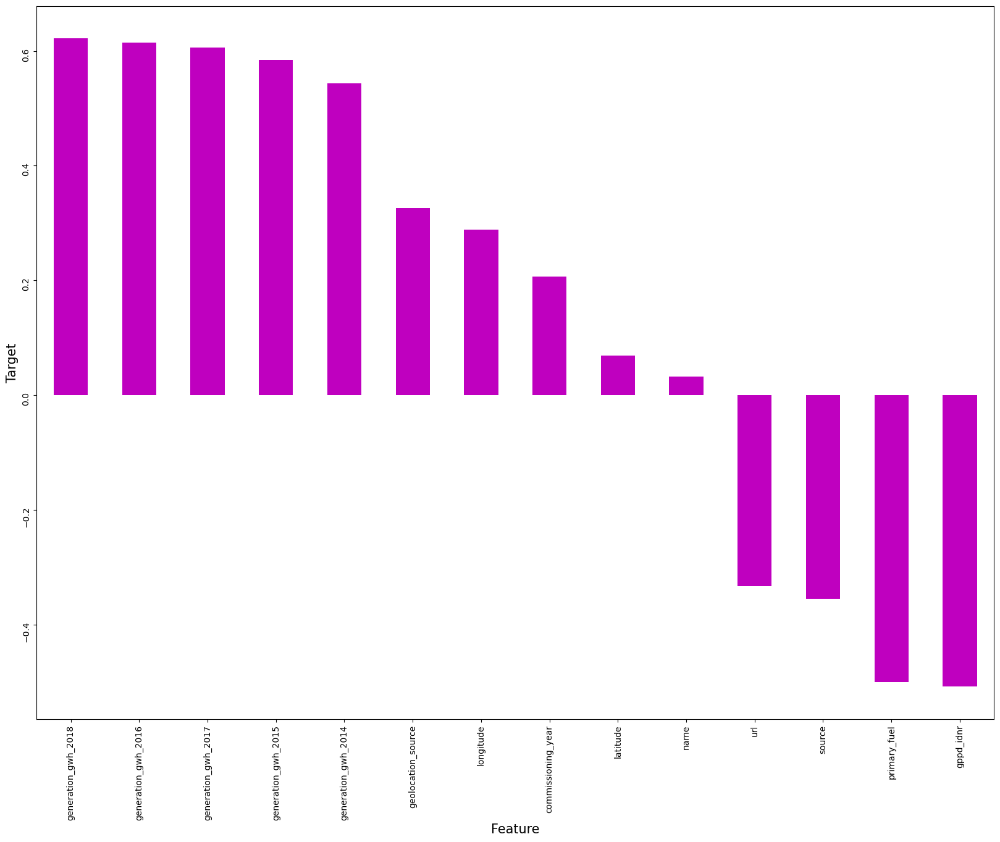

In [231]:
plt.figure(figsize = (20,15))
correlation['capacity_mw'].sort_values(ascending=False).drop(['capacity_mw']).plot(kind='bar',color="m")
plt.xlabel('Feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.yticks(rotation=90);
plt.show()

We will be removing the columns with very weak correlation later on in the project.

Variance inflation factor

lets declare the x and y columns to scale the dataframe using the standard scaler.

In [234]:
x = global_power_data.drop("capacity_mw", axis=1)
y = global_power_data["capacity_mw"]

In [235]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,name,gppd_idnr,latitude,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,-1.730142,0.779137,1.144693,-0.869917,1.225688,0.933076,1.460215,0.476673,-1.077648,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
1,-1.726323,0.252074,0.582324,-0.585590,-0.967877,0.172699,2.917019,1.116401,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
2,-1.722504,1.527719,0.111296,-1.673567,1.664401,0.172699,-0.512075,1.571318,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
3,-1.718684,-1.730142,0.435034,2.895239,-0.529164,0.400812,-0.489662,-0.518459,0.351338,-0.296090,-0.013956,-0.002911,-0.251235,-0.254982
4,-1.714865,-1.726323,0.120593,1.035238,-0.967877,1.237227,-0.489662,-0.518459,0.351338,1.141189,1.969321,1.981343,1.700758,2.077959
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
902,1.714865,0.145133,-0.811655,-0.014609,-0.967877,1.313265,-0.489662,-0.518459,0.351338,-0.110318,-1.954550,-0.779135,-0.072471,-0.197639
903,1.718684,1.409321,-1.371409,0.153415,1.225688,0.172699,0.743019,-1.030242,-2.506634,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
904,1.722504,1.672853,-0.979349,-0.383592,1.664401,0.172699,-0.512075,2.353208,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
905,1.726323,0.328460,0.513821,-0.764564,-0.967877,0.172699,0.339596,-0.177271,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309


let's check the vif values of the dataframe.

In [236]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
                     for i in range(len(x.columns))]
vif["Features"] = x.columns

vif

,VIF values,Features
0,1.387468,name
1,3.526202,gppd_idnr
2,1.105823,latitude
3,1.266612,longitude
4,3.416002,primary_fuel
5,1.193959,commissioning_year
6,1.995282,source
7,2.865120,url
8,2.660989,geolocation_source
9,5.263809,generation_gwh_2014


lets remove the columns with very low correlation to reduce the vif values of other columns.

In [237]:
columns_with_low_corelation_and_high_VIF = ['name','latitude']
global_power_data = global_power_data.drop(columns=columns_with_low_corelation_and_high_VIF)

lets repeat the process of scaling and checking the vif values.

In [238]:
x = global_power_data.drop("capacity_mw", axis=1)
y = global_power_data["capacity_mw"]

In [239]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,gppd_idnr,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,generation_gwh_2018
0,0.779137,-0.869917,1.225688,0.933076,1.460215,0.476673,-1.077648,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
1,0.252074,-0.585590,-0.967877,0.172699,2.917019,1.116401,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
2,1.527719,-1.673567,1.664401,0.172699,-0.512075,1.571318,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
3,-1.730142,2.895239,-0.529164,0.400812,-0.489662,-0.518459,0.351338,-0.296090,-0.013956,-0.002911,-0.251235,-0.254982
4,-1.726323,1.035238,-0.967877,1.237227,-0.489662,-0.518459,0.351338,1.141189,1.969321,1.981343,1.700758,2.077959
...,...,...,...,...,...,...,...,...,...,...,...,...
902,0.145133,-0.014609,-0.967877,1.313265,-0.489662,-0.518459,0.351338,-0.110318,-1.954550,-0.779135,-0.072471,-0.197639
903,1.409321,0.153415,1.225688,0.172699,0.743019,-1.030242,-2.506634,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
904,1.672853,-0.383592,1.664401,0.172699,-0.512075,2.353208,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309
905,0.328460,-0.764564,-0.967877,0.172699,0.339596,-0.177271,0.351338,-0.110318,-0.134126,-0.131523,-0.111786,-0.139309


In [240]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
                     for i in range(len(x.columns))]
vif["Features"] = x.columns

vif

,VIF values,Features
0,2.558590,gppd_idnr
1,1.252990,longitude
2,3.371956,primary_fuel
3,1.153035,commissioning_year
4,1.961663,source
5,2.733253,url
6,2.554918,geolocation_source
7,5.251208,generation_gwh_2014
8,9.602792,generation_gwh_2015
9,15.123117,generation_gwh_2016


In [ ]:
column_with_low_corelation_and_high_VIF = ['generation_gwh_2016']
global_power_data = global_power_data.drop(columns=column_with_low_corelation_and_high_VIF)

In [245]:
x = global_power_data.drop("capacity_mw", axis=1)
y = global_power_data["capacity_mw"]

In [246]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,gppd_idnr,longitude,primary_fuel,commissioning_year,source,url,geolocation_source,generation_gwh_2014,generation_gwh_2015,generation_gwh_2017,generation_gwh_2018
0,0.779137,-0.869917,1.225688,0.933076,1.460215,0.476673,-1.077648,-0.110318,-0.134126,-0.111786,-0.139309
1,0.252074,-0.585590,-0.967877,0.172699,2.917019,1.116401,0.351338,-0.110318,-0.134126,-0.111786,-0.139309
2,1.527719,-1.673567,1.664401,0.172699,-0.512075,1.571318,0.351338,-0.110318,-0.134126,-0.111786,-0.139309
3,-1.730142,2.895239,-0.529164,0.400812,-0.489662,-0.518459,0.351338,-0.296090,-0.013956,-0.251235,-0.254982
4,-1.726323,1.035238,-0.967877,1.237227,-0.489662,-0.518459,0.351338,1.141189,1.969321,1.700758,2.077959
...,...,...,...,...,...,...,...,...,...,...,...
902,0.145133,-0.014609,-0.967877,1.313265,-0.489662,-0.518459,0.351338,-0.110318,-1.954550,-0.072471,-0.197639
903,1.409321,0.153415,1.225688,0.172699,0.743019,-1.030242,-2.506634,-0.110318,-0.134126,-0.111786,-0.139309
904,1.672853,-0.383592,1.664401,0.172699,-0.512075,2.353208,0.351338,-0.110318,-0.134126,-0.111786,-0.139309
905,0.328460,-0.764564,-0.967877,0.172699,0.339596,-0.177271,0.351338,-0.110318,-0.134126,-0.111786,-0.139309


In [247]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
                     for i in range(len(x.columns))]
vif["Features"] = x.columns

vif

,VIF values,Features
0,2.557237,gppd_idnr
1,1.245180,longitude
2,3.370217,primary_fuel
3,1.136454,commissioning_year
4,1.961371,source
5,2.730229,url
6,2.552522,geolocation_source
7,5.243562,generation_gwh_2014
8,6.671960,generation_gwh_2015
9,12.496124,generation_gwh_2017


now the vif values are corrected, lets check the z-score of our processed dataframe.

Z-scores

In [248]:
from scipy.stats import zscore
out_features=global_power_data[['gppd_idnr', 'longitude','primary_fuel', 'url','source','commissioning_year','geolocation_source', 'generation_gwh_2015', 'generation_gwh_2017', 'generation_gwh_2018']]
z=np.abs(zscore(out_features))
z

,gppd_idnr,longitude,primary_fuel,url,source,commissioning_year,geolocation_source,generation_gwh_2015,generation_gwh_2017,generation_gwh_2018
0,0.779137,0.869917,1.225688,0.476673,1.460215,0.933076,1.077648,0.134126,0.111786,0.139309
1,0.252074,0.585590,0.967877,1.116401,2.917019,0.172699,0.351338,0.134126,0.111786,0.139309
2,1.527719,1.673567,1.664401,1.571318,0.512075,0.172699,0.351338,0.134126,0.111786,0.139309
3,1.730142,2.895239,0.529164,0.518459,0.489662,0.400812,0.351338,0.013956,0.251235,0.254982
4,1.726323,1.035238,0.967877,0.518459,0.489662,1.237227,0.351338,1.969321,1.700758,2.077959
...,...,...,...,...,...,...,...,...,...,...
902,0.145133,0.014609,0.967877,0.518459,0.489662,1.313265,0.351338,1.954550,0.072471,0.197639
903,1.409321,0.153415,1.225688,1.030242,0.743019,0.172699,2.506634,0.134126,0.111786,0.139309
904,1.672853,0.383592,1.664401,2.353208,0.512075,0.172699,0.351338,0.134126,0.111786,0.139309
905,0.328460,0.764564,0.967877,0.177271,0.339596,0.172699,0.351338,0.134126,0.111786,0.139309


In [ ]:
lets check the z scores of the rows that are above 3/-3

In [249]:
np.where(z>3)

(array([ 15,  15,  71,  80, 143, 143, 179, 183, 191, 209, 219, 222, 244,
        299, 308, 308, 308, 321, 323, 333, 340, 342, 345, 360, 364, 364,
        364, 371, 416, 427, 444, 454, 478, 484, 493, 493, 493, 494, 494,
        494, 499, 519, 538, 541, 546, 573, 577, 583, 592, 601, 621, 638,
        648, 648, 648, 657, 657, 657, 661, 669, 689, 695, 695, 695, 706,
        709, 721, 724, 724, 724, 726, 726, 726, 728, 786, 786, 786, 807,
        808, 808, 808, 818, 832, 847, 848, 870, 871, 879, 880, 880, 880,
        895, 900], dtype=int64),
 array([8, 9, 4, 4, 8, 9, 1, 1, 4, 9, 5, 5, 1, 4, 7, 8, 9, 4, 1, 1, 1, 5,
        4, 1, 7, 8, 9, 5, 1, 1, 5, 5, 5, 5, 7, 8, 9, 7, 8, 9, 1, 1, 5, 5,
        1, 5, 1, 5, 5, 5, 5, 1, 7, 8, 9, 7, 8, 9, 4, 4, 4, 7, 8, 9, 5, 5,
        7, 7, 8, 9, 7, 8, 9, 5, 7, 8, 9, 5, 7, 8, 9, 1, 4, 1, 5, 4, 4, 4,
        7, 8, 9, 4, 4], dtype=int64))

now lets remove all those columns with z-score above 3/-3 and check the new shape of our dataframe.

In [251]:
global_power_data_new=global_power_data[(z<3).all(axis=1)]
global_power_data_new.shape

(840, 12)

let's check the data loss percentage after removing the rows.

In [252]:
data_loss_percentage = ((global_power_data.shape[0] - global_power_data_new.shape[0]) / global_power_data.shape[0]) * 100
print("Data Loss Percentage:", data_loss_percentage)

Data Loss Percentage: 7.386990077177508


now lets use the scaled data to declare the x and y variables for predictions, and check the y value counts.

In [253]:
x = global_power_data_new.drop("capacity_mw", axis=1)
y = global_power_data_new["capacity_mw"]

In [257]:
y.value_counts()


1.709976     37
8.434327     20
10.626586    19
2.154435     19
1.000000     18
             ..
9.491220      1
3.191252      1
4.929682      1
2.795230      1
4.741536      1
Name: capacity_mw, Length: 333, dtype: int64

Predictions.

lets import all the necessary packages for the predictions of our dataframe.

In [278]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor,ExtraTreesRegressor
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Lasso, Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR

now lets check the best r2 score at the maximum random state using the linear regression model.

In [260]:
maxaccuracy = 0
maxrandomstate = 0
for i in range(1,200):
      x_train,x_test,y_train,y_test = train_test_split(x,y, test_size = 0.40, random_state=i)
      LR = LinearRegression()
      LR.fit(x_train,y_train)
pred=LR.predict(x_test)
acc = r2_score(y_test, pred)
if acc>maxaccuracy:
    maxaccuracy=acc
    maxrandomstate=i
print("the best r2 score",maxaccuracy,"at the following random state",maxrandomstate)

the best r2 score 0.6205911420322022 at the following random state 199


we found that the best r2 score 0.6205911420322022 at the following random state 199.

Now we will be checking the predictions of different models GradientBoostingRegressor, RandomForestRegressor,ExtraTreesRegressor,LinearRegression,KNeighborsRegressor,Lasso,Ridge,DecisionTreeRegressor and support vector regressor.

In [261]:
LinReg = LinearRegression()
LinReg.fit(x_train,y_train)
predLinReg=LinReg.predict(x_test)
predtrain=LinReg.predict(x_train)
print(r2_score(y_test, predLinReg))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predLinReg))
print(mean_squared_error(y_test,predLinReg))
print(np.sqrt(mean_squared_error(y_test,predLinReg)))

0.6205911420322022
62.324333247563835
1.4800301641398061
3.654220461942096
1.9116015437172298


Linear regression gives an r2 score of 62.324333247 with an mae of 1.480030164 and mse of 3.654220461.

In [262]:
GradReg = GradientBoostingRegressor()
GradReg.fit(x_train,y_train)
predGradReg=GradReg.predict(x_test)
predtrain=GradReg.predict(x_train)
print(r2_score(y_test, predGradReg))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predGradReg))
print(mean_squared_error(y_test,predGradReg))
print(np.sqrt(mean_squared_error(y_test,predGradReg)))

0.8328747222215741
95.25667864618711
0.9100279598325623
1.6096424660109403
1.2687168580936175


gradient boost regression gives an r2 score of 95.2566786 with an mae of 0.91002795 and mse of 1.609642466.

In [263]:
RFR = RandomForestRegressor()
RFR.fit(x_train,y_train)
predRFR=RFR.predict(x_test)
predtrain=RFR.predict(x_train)
print(r2_score(y_test, predRFR))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predRFR))
print(mean_squared_error(y_test,predRFR))
print(np.sqrt(mean_squared_error(y_test,predRFR)))

0.8485035335472892
97.63363830232174
0.8726942458575099
1.4591158745967043
1.2079386882605856


random forest regression gives an r2 score of 97.6336383 with an mae of 0.87269424 and mse of 1.4591158745.

In [264]:
ETR = ExtraTreesRegressor()
ETR.fit(x_train,y_train)
predETR=ETR.predict(x_test)
predtrain=ETR.predict(x_train)
print(r2_score(y_test, predETR))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predETR))
print(mean_squared_error(y_test,predETR))
print(np.sqrt(mean_squared_error(y_test,predETR)))

0.8519872138622382
100.0
0.8593380830571846
1.425563321401355
1.193969564688043


extra trees regression gives an r2 score of 100.0 with an mae of 0.8593380830 and mse of 1.425563321.

In [280]:
Lasso = Lasso()
Lasso.fit(x_train,y_train)
predLasso=Lasso.predict(x_test)
predtrain=Lasso.predict(x_train)
print(r2_score(y_test, predLasso))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predLasso))
print(mean_squared_error(y_test,predLasso))
print(np.sqrt(mean_squared_error(y_test,predLasso)))

0.5992161535996878
59.226450732228365
1.5079224206518647
3.860090510739163
1.9647113046804519


lasso regression gives an r2 score of 59.226450732 with an mae of 1.50792242 and mse of 3.86009051073.

In [283]:
Ridge = Ridge()
Ridge.fit(x_train,y_train)
predRidge=Ridge.predict(x_test)
predtrain=Ridge.predict(x_train)
print(r2_score(y_test, predRidge))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predRidge))
print(mean_squared_error(y_test,predRidge))
print(np.sqrt(mean_squared_error(y_test,predRidge)))

0.6206667732963647
62.32432469425293
1.4797823072293192
3.653492030575087
1.911411005141251


ridge regression gives an r2 score of 62.324324694 with an mae of 1.4797823072 and mse of 3.6534920305.

In [267]:
DTR = DecisionTreeRegressor()
DTR.fit(x_train,y_train)
predDTR=DTR.predict(x_test)
predtrain=DTR.predict(x_train)
print(r2_score(y_test, predDTR))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predDTR))
print(mean_squared_error(y_test,predDTR))
print(np.sqrt(mean_squared_error(y_test,predDTR)))

0.7872288317776747
100.0
1.0173869268457576
2.0492741281631757
1.4315285984440462


decision tree regression gives an r2 score of 100.0 with an mae of 1.01738692684 and mse of 2.04927412816.

In [268]:
SVR = SVR(kernel='linear', C=1.0, epsilon=0.1)
SVR.fit(x_train,y_train)
predSVR=SVR.predict(x_test)
predtrain=SVR.predict(x_train)
print(r2_score(y_test, predSVR))
print(r2_score(y_train, predtrain)*100)
print(mean_absolute_error(y_test,predSVR))
print(mean_squared_error(y_test,predSVR))
print(np.sqrt(mean_squared_error(y_test,predSVR)))

0.524160339048378
50.479587242718516
1.7433677439555975
4.58297951968372
2.140789461783601


support vector regression gives an r2 score of 50.4795872 with an mae of 1.7433677 and mse of 4.5829795196.

In [285]:
KNN = KNeighborsRegressor(n_neighbors=5) 
KNN.fit(x_train, y_train)
predKNN = KNN.predict(x_test)
predTrain = KNN.predict(x_train)
print("R-squared (Test):", r2_score(y_test, predKNN))
print("R-squared (Train):", r2_score(y_train, predTrain) * 100)
print("Mean Absolute Error:", mean_absolute_error(y_test, predKNN))
print("Mean Squared Error:", mean_squared_error(y_test, predKNN))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(y_test, predKNN)))

R-squared (Test): 0.5794446180407622
R-squared (Train): 73.9363245767088
Mean Absolute Error: 1.5062020915195848
Mean Squared Error: 4.050517139654541
Root Mean Squared Error: 2.0125896600287256


k neighbours regression gives an r2 score of 73.9363245 with an mae of 1.5062020915 and mse of  4.050517139.

Cross validation scores

The cv scores of svr and etr are removed because of poor performance in their r2 scores.

In [272]:
from sklearn.model_selection import cross_val_score

In [273]:
score = cross_val_score(RFR,x,y,cv=5,scoring='r2')
print(score)
print(score.mean())
print("r2-cv-",(r2_score(y_test,predRFR)-score.mean()))

[0.79715673 0.82864988 0.80396268 0.88729906 0.85381339]
0.8341763487597212
r2-cv- 0.014327184787568004


In [274]:
score2 = cross_val_score(GradReg,x,y,cv=5,scoring='r2')
print(score2)
print(score2.mean())
print("r2-cv-",(r2_score(y_test,predGradReg)-score.mean()))

[0.78771013 0.82483082 0.80908045 0.86599435 0.84583448]
0.8266900453852217
r2-cv- -0.0013016265381471381


In [275]:
score3 = cross_val_score(LinReg,x,y,cv=5,scoring='r2')
print(score3)
print(score3.mean())
print("r2-cv-",(r2_score(y_test,predLinReg)-score.mean()))

[0.55182388 0.61253547 0.59593311 0.64067486 0.59123697]
0.5984408564969679
r2-cv- -0.21358520672751902


In [276]:
score4 = cross_val_score(DTR,x,y,cv=5,scoring='r2')
print(score4)
print(score4.mean())
print("r2-cv-",(r2_score(y_test,predDTR)-score.mean()))

[0.70052846 0.55802892 0.74564287 0.81427225 0.7623181 ]
0.7161581194501675
r2-cv- -0.04694751698204658


In [281]:
score5 = cross_val_score(Lasso,x,y,cv=5,scoring='r2')
print(score5)
print(score5.mean())
print("r2-cv-",(r2_score(y_test,predLasso)-score5.mean()))

[0.48081851 0.60640009 0.57953087 0.61850591 0.52866094]
0.5627832660019716
r2-cv- 0.036432887597716235


In [284]:
score6 = cross_val_score(Ridge,x,y,cv=5,scoring='r2')
print(score6)
print(score6.mean())
print("r2-cv-",(r2_score(y_test,predRidge)-score6.mean()))

[0.55180236 0.61254403 0.59595387 0.64070377 0.59122854]
0.5984465129836256
r2-cv- 0.02222026031273905


In [286]:
score7 = cross_val_score(KNN,x,y,cv=5,scoring='r2')
print(score7)
print(score7.mean())
print("r2-cv-",(r2_score(y_test,predKNN)-score7.mean()))

[ 0.37463036 -0.0286605   0.49782186  0.52495044  0.45448261]
0.36464495393848717
r2-cv- 0.21479966410227502


From all the above cross validation scores, the least difference between r2 and cv scores is of gradient boost regressor with the value 0.0013016. 

Hyperparameter tuning

In [287]:
from sklearn.model_selection import GridSearchCV

We will be using the 'n_estimators': [100, 200, 300], 'learning_rate': [0.01, 0.1, 0.2], 'max_depth': [3, 4, 5], 'min_samples_split': [2, 5, 10],  and 'min_samples_leaf': [1, 2, 4] to hyper parameter tune gradient boost regressor.

In [288]:
parameters = {'n_estimators': [100, 200, 300], 'learning_rate': [0.01, 0.1, 0.2], 'max_depth': [3, 4, 5], 'min_samples_split': [2, 5, 10],  'min_samples_leaf': [1, 2, 4]}

In [289]:
GSCV=GridSearchCV(GradientBoostingRegressor(),parameters,cv=5)

In [290]:
GSCV.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=GradientBoostingRegressor(),
             param_grid={'learning_rate': [0.01, 0.1, 0.2],
                         'max_depth': [3, 4, 5], 'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300]})

lets check the best parameters for the model.

In [292]:
GSCV.best_params_

{'learning_rate': 0.1,
 'max_depth': 4,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 100}

we will be using the above parameters to train the selected model.

In [293]:
Selected_model=GradientBoostingRegressor(learning_rate=0.1,max_depth= 4,min_samples_leaf= 2,min_samples_split= 2,n_estimators=100)

In [294]:
Selected_model.fit(x_train,y_train)
pred = Selected_model.predict(x_test)
print(r2_score(y_test, pred))
print(mean_absolute_error(y_test,pred))
print(mean_squared_error(y_test,pred))
print(np.sqrt(mean_squared_error(y_test,pred)))

0.8115849599348913
0.9327853576129741
1.8146916717532124
1.3471049223253593


We got an r2 score of 0.9327853 with mae 1.814691 and mse 1.347104922.

Saving the model

We will be using the joblib and pickle method to save the model and check the accuracy score.

In [295]:
import joblib

In [297]:
import pickle
filename='global power capacity.pkl'
pickle.dump(Selected_model,open(filename,'wb'))

In [298]:
import pickle
loaded_model=pickle.load(open('global power capacity.pkl','rb'))
result=loaded_model.score(x_test,y_test)
print(result*100)

81.15849599348913


We got an accuracy of 81.1584959934 percent.

now lets compare the predictred and original values.

In [299]:
Conclusion=pd.DataFrame([loaded_model.predict(x_test)[:],y_test[:]],index=["Predicted","Original"])
Conclusion

,0,1,2,3,4,5,6,7,8,9,...,326,327,328,329,330,331,332,333,334,335
Predicted,8.655685,4.902216,2.822653,2.439989,3.028715,5.406612,1.484088,3.767202,5.404492,1.676776,...,1.789112,7.136699,2.644379,2.151291,2.625126,6.581684,2.721488,3.944630,3.013038,2.422597
Original,7.829735,4.728155,2.519842,1.875777,2.519842,5.241483,1.000000,3.201041,6.214465,1.442250,...,1.000000,10.131594,4.653934,2.189760,2.289428,3.503398,2.000000,3.802952,3.802952,2.289428


We can see that our model has performed well, which leads to the conclusion of the project.